## Installing UDPipe in Colab

In [0]:
!wget https://lindat.mff.cuni.cz/repository/xmlui/bitstream/handle/11234/1-2998/russian-syntagrus-ud-2.4-190531.udpipe

--2019-12-23 16:17:23--  https://lindat.mff.cuni.cz/repository/xmlui/bitstream/handle/11234/1-2998/russian-syntagrus-ud-2.4-190531.udpipe
Resolving lindat.mff.cuni.cz (lindat.mff.cuni.cz)... 195.113.20.140
Connecting to lindat.mff.cuni.cz (lindat.mff.cuni.cz)|195.113.20.140|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 45859472 (44M) [application/octet-stream]
Saving to: ‘russian-syntagrus-ud-2.4-190531.udpipe’

russian-syntagrus-u 100%[===================>]  43.73M  14.0MB/s    in 3.8s    

2019-12-23 16:17:28 (11.4 MB/s) - ‘russian-syntagrus-ud-2.4-190531.udpipe’ saved [45859472/45859472]



In [0]:
!mv russian-syntagrus-ud-2.4-190531.udpipe?sequence=74 russian-syntagrus-ud-2.4-190531.udpipe

mv: cannot stat 'russian-syntagrus-ud-2.4-190531.udpipe?sequence=74': No such file or directory


In [0]:
!pip install ufal.udpipe

     |████████████████████████████████| 307kB 4.8MB/s 
  Created wheel for ufal.udpipe: filename=ufal.udpipe-1.2.0.3-cp36-cp36m-linux_x86_64.whl size=5625849 sha256=40c92c8daadd28cde6a33b6d9ba5f0b782a7357b51353d100db74cea9b135acf
  Stored in directory: /root/.cache/pip/wheels/0c/9d/db/6d3404c33da5b7adb6c6972853efb6a27649d3ba15f7e9bebb
Successfully built ufal.udpipe


In [0]:
import ufal.udpipe

In [0]:
class UDPipeModel:
    def __init__(self, path):
        """Load given model."""
        self.model = ufal.udpipe.Model.load(path)
        if not self.model:
            raise Exception("Cannot load UDPipe model from file '%s'" % path)

    def tokenize(self, text):
        """Tokenize the text and return list of ufal.udpipe.Sentence-s."""
        tokenizer = self.model.newTokenizer(self.model.DEFAULT)
        if not tokenizer:
            raise Exception("The model does not have a tokenizer")
        return self._read(text, tokenizer)

    def read(self, text, in_format):
        """Load text in the given format (conllu|horizontal|vertical) and return list of ufal.udpipe.Sentence-s."""
        input_format = ufal.udpipe.InputFormat.newInputFormat(in_format)
        if not input_format:
            raise Exception("Cannot create input format '%s'" % in_format)
        return self._read(text, input_format)

    def _read(self, text, input_format):
        input_format.setText(text)
        error = ufal.udpipe.ProcessingError()
        sentences = []

        sentence = ufal.udpipe.Sentence()
        while input_format.nextSentence(sentence, error):
            sentences.append(sentence)
            sentence = ufal.udpipe.Sentence()
        if error.occurred():
            raise Exception(error.message)

        return sentences

    def tag(self, sentence):
        """Tag the given ufal.udpipe.Sentence (inplace)."""
        self.model.tag(sentence, self.model.DEFAULT)

    def parse(self, sentence):
        """Parse the given ufal.udpipe.Sentence (inplace)."""
        self.model.parse(sentence, self.model.DEFAULT)

    def write(self, sentences, out_format):
        """Write given ufal.udpipe.Sentence-s in the required format (conllu|horizontal|vertical)."""

        output_format = ufal.udpipe.OutputFormat.newOutputFormat(out_format)
        output = ''
        for sentence in sentences:
            output += output_format.writeSentence(sentence)
        output += output_format.finishDocument()

        return output

In [0]:
model = UDPipeModel('russian-syntagrus-ud-2.4-190531.udpipe')
sentences = model.tokenize('Мама, мыла ли ты раму?!')
for s in sentences:
    model.tag(s)
    model.parse(s)
conllu = model.write(sentences, "conllu")

In [0]:
print(conllu)

# newdoc
# newpar
# sent_id = 1
# text = Мама, мыла ли ты раму?!
1	Мама	мама	NOUN	_	Animacy=Anim|Case=Nom|Gender=Fem|Number=Sing	3	parataxis	_	SpaceAfter=No
2	,	,	PUNCT	_	_	1	punct	_	_
3	мыла	мыть	VERB	_	Aspect=Imp|Gender=Fem|Mood=Ind|Number=Sing|Tense=Past|VerbForm=Fin|Voice=Act	0	root	_	_
4	ли	ли	PART	_	_	3	advmod	_	_
5	ты	ты	PRON	_	Case=Nom|Number=Sing|Person=2	3	nsubj	_	_
6	раму	рама	NOUN	_	Animacy=Inan|Case=Par|Gender=Masc|Number=Sing	3	parataxis	_	SpaceAfter=No
7	?	?	PUNCT	_	_	6	punct	_	SpaceAfter=No
8	!	!	PUNCT	_	_	3	punct	_	SpaceAfter=No




## Installing spellchecking library

In [0]:
!apt-get install swig
!easy_install-3.6 jamspell
!cp -r /usr/local/lib/python3.6/dist-packages/jamspell-0.0.11-py3.6-linux-x86_64.egg/EGG-INFO /usr/local/lib/python3.6/dist-packages/jamspell-0.0.11-py3.6-linux-x86_64.egg-info
!cp -r /usr/local/lib/python3.6/dist-packages/jamspell-0.0.11-py3.6-linux-x86_64.egg /usr/local/lib/python3.6/dist-packages/jamspell
!wget https://github.com/bakwc/JamSpell-models/raw/master/ru.tar.gz

In [0]:
import tarfile

tar = tarfile.open("ru.tar.gz")
tar.extractall()

In [0]:
from jamspell import jamspell

class Jamspell:
  
  def __init__(self, path):
    self.instance = jamspell.TSpellCorrector()
    self.instance.LoadLangModel(path)
	
  def correct(self, text):
    return self.instance.FixFragment(text)

In [0]:
spellchecker = Jamspell('ru.bin')

# Work itself

In [0]:
!wget 'https://www.dropbox.com/s/5i8aq88zi5ud7qv/SentiRuEval_rest_train.xml'

--2019-12-23 20:35:11--  https://www.dropbox.com/s/5i8aq88zi5ud7qv/SentiRuEval_rest_train.xml
Resolving www.dropbox.com (www.dropbox.com)... 162.125.65.1, 2620:100:6021:1::a27d:4101
Connecting to www.dropbox.com (www.dropbox.com)|162.125.65.1|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/5i8aq88zi5ud7qv/SentiRuEval_rest_train.xml [following]
--2019-12-23 20:35:11--  https://www.dropbox.com/s/raw/5i8aq88zi5ud7qv/SentiRuEval_rest_train.xml
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://ucd7d65e54bb61dbbb25afbab9a4.dl.dropboxusercontent.com/cd/0/inline/AuzIfarJy1-klr-KKeh-vTNzqr2wPkbT3tytUm8Zc7HAVpdr4jGrAdzCvTI3S6oFip9luMx0S0mVpztiVnTOkhw-gnLWiRVwi5Bf8-W1rg0T0m-5eAAFx2_HHExDqODPM9c/file# [following]
--2019-12-23 20:35:11--  https://ucd7d65e54bb61dbbb25afbab9a4.dl.dropboxusercontent.com/cd/0/inline/AuzIfarJy1-klr-KKeh-vTNzqr2wPkbT3tytUm8Zc7HAVpdr4jGrAdzCvTI3S6oFip9lu

In [0]:
import os
import xml.etree.ElementTree as ET


In [0]:
path = 'SentiRuEval_rest_train.xml'

tree = ET.parse(path)
body = tree.getroot()

## Just a Little Data Overview

In [0]:
from sortedcontainers import SortedDict
food_dict, service_dict = {}, {}
for el in body:
    service_val = int(el[1][2].text)
    food_val = int(el[1][0].text)
    if service_val in service_dict:
        service_dict[service_val] += 1
    elif service_val not in service_dict:
        service_dict[service_val] = 1

    if food_val in food_dict:
        food_dict[food_val] += 1
    elif food_val not in food_dict:
        food_dict[food_val] = 1
        
food_dict = SortedDict(food_dict)
service_dict = SortedDict(service_dict)

In [0]:
service_list, food_list = [], []
for el in body:
    service_val = int(el[1][2].text)
    food_val = int(el[1][0].text)
    service_list.append(service_val)
    food_list.append(food_val)
    
len(service_list)

19034

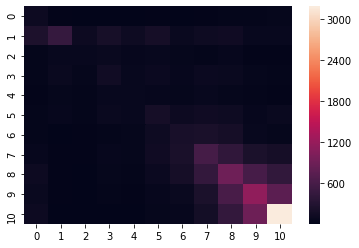

In [0]:
import seaborn as sns
from sklearn.metrics import confusion_matrix

conf_mat = confusion_matrix(service_list, food_list)
#conf_mat.shape
sns.heatmap(conf_mat)

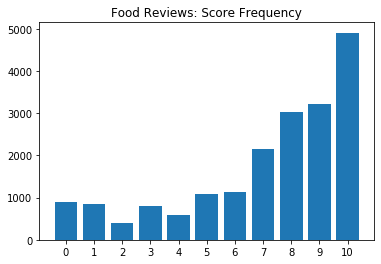

In [0]:
import matplotlib.pyplot as plt
plt.bar(range(len(food_dict)), food_dict.values())
plt.xticks(range(len(food_dict)), food_dict.keys())
plt.title('Food Reviews: Score Frequency')
plt.show()

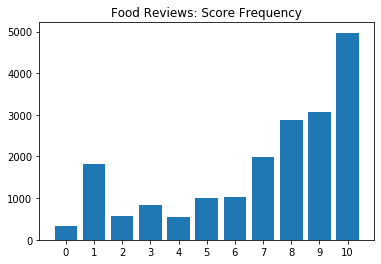

In [0]:
plt.bar(range(len(service_dict)), service_dict.values())
plt.xticks(range(len(service_dict)), service_dict.keys())
plt.title('Food Reviews: Score Frequency')
plt.show()

## Now starting to (pre)process
### A. preprocessing

In [0]:
sentences = model.tokenize(text)
for s in sentences:
    model.tag(s)
    model.parse(s)
conllu = model.write(sentences, "conllu")

In [0]:
counter = 0

for el in body:
    if int(el[1][2].text) >= 8:
        print(f'service: {el[1][2].text}, food: {el[1][0].text}')
        print(el[2].text)


        print('_______________')
        counter += 1

        with open('pos_service_sents.txt', 'a', encoding='utf-8') as f2:
            f2.write(el[2].text + '\n')
        

service: 8, food: 8
И пускай на меня не обижается наш прославленный защитник - франкофон «Монреаль Канадиенс» Maxime – я всегда с некоторой опаской относился к этому народу. Народу способному с таким благоговением доводить до цирроза всю пернатую живность, заставлять специальных поисковых свиней копошиться в грязи в поисках сумчатых грибов, ковыряться в тине, собирая брюхоногих и двустворчатых. Народу, подсадившего все население земного шара на муть, именуемое «Божоле Нуво», на сыры с плесенью и на квакающих жаб, скачущих по болотам. Тем не менее, единожды заглянув, не мог успокоиться, пока не вкусил большую часть меню. Не буду вдаваться в детали «вкусно-невкусно», а приведу турнирную таблицу, коли начали с хоккея. 1.Петух, запеченный в сливках, с картофелем и грибами. Почему петух, а не курица? Различать еще не научился. 2.Домашний пирог. Яблочный. Горячий. Тающий. 3.Говядина по-бургунски. Кускус неожиданный. 4.Террин из печени цыпленка. Массивная порция. 5.Утиная ножка «Конфи» с карт

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



_______________
service: 9, food: 9
Знойный июль, палящее солнце на безоблачном санкт-петербургском небе… ХОЧЕТСЯ… как никогда… чего-то утонченного, по-настоящему изысканного и необыкновенно легкого. Пожалуй, самое время продегустировать гастрономический сет в недавно открывшемся в нашем городе винном бутике и ресторане авторский кухни Grand Cru. Собственно «вкусить» шедевры молекулярной кухни хотелось уже очень давно, уж больно заманчиво и аппетитно описывал эногастрономические изыски известный московский ресторатор и ведущий «Кухонных тайн» Игорь Бухаров. Теперь же такая возможность появилась и в Петербурге ;-) Само заведение позиционирует себя, прежде всего, как винотека: и, действительно, собрание коллекционных вин, представленное на обозрение посетителя в отдельном зале ресторана, не может не впечатлить. И именно стремлением подчеркнуть вкусовые нюансы разных сортов вин всецело определено и меню ресторана. Карта блюд небольшая, но вполне достаточная для выбора, превосходящего все 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [0]:
#this is a variant of UDPipe processing in Colab
with open('pos_service_sents.txt', 'r', encoding='utf-8') as f:
    text = f.read()

text = spellchecker.correct(text)
sentences = model.tokenize(text)
for s in sentences[:3]:
    model.tag(s)
    model.parse(s)
conllu = model.write(sentences, "conllu")

In [0]:
conllu

In [0]:
#this is a variant of UDPipe processing on computer
!C:\Users\Cyril\proga\NLP_4_grade\4GradeNLP\project\udpipe-1.2.0-bin\bin-win64\udpipe --input horizontal --output conllu \
    --tokenize --tag --parse \
    C:\Users\Cyril\proga\NLP_4_grade\4GradeNLP\project\russian-syntagrus-ud-2.4-190531.udpipe < pos_service_sents.txt > pos_service.conllu

Loading UDPipe model: done.


In [0]:
counter = 0
with open('negative_service_meta.csv', 'w', encoding='utf-8') as f:
    f.write('sent_id\tfood\tservice\n')
for el in body:
    if int(el[1][2].text) <= 2:
        print(f'service: {el[1][2].text}, food: {el[1][0].text}')
        print(el[2].text)

        print('_______________')
        counter += 1
        with open('negative_service_meta.csv', 'a', encoding='utf-8') as f:
            line = str(counter) + '\t' + el[1][0].text + '\t' + el[1][2].text + '\n'
            f.write(line)
        with open('neg_service_sents.txt', 'a', encoding='utf-8') as f2:
            f2.write(el[2].text + '\n')

service: 1, food: 9
Советую вам уволить Вашего метродотеля Елену, эта девушка, вообще не умеет общаться с гостями, у Вас достаточно презентабельное заведение, но видимо она что то перепутала, ей бы в бар какой пойти работать, Звездой там будет!!!!
_______________
service: 1, food: 5
Красивый воздушный, прозрачный и легкий интерьер. Еда без посторонних запахов, но очень маленькие порции за те же деньги. Обслуживание ленивое и совсем не соответствует уровню, на который позиционирует себя ресторан.
_______________
service: 2, food: 0
В соовторстве с Antonoff Решили отметить День рождения, компания 8 человек. За именинника полагается «бух» и пузырьки, возложили эту роль на бутылочку Асти. Не тут-то было. В 30 градусную жару принесли теплую… пытались ситуацию спасти, запросили ведро со льдом – «дудки», ведер нет, а лед, как оказалось еще та невидаль. Пришлось вернуться Асти на «склад». Что касается кухни. Суши понравились всем, удачно легли на настроение и погоду. Стейк «Портер хаус» именин

service: 1, food: 6
Впечатления негативные... прежде всего к качеству обслуживания, официанта, мало того, что не дождаться, так еще и приходит с недовольным видом.. и всем этим своим видом показывает откровенное недовольство нам..
_______________
service: 1, food: 1
26 декабря у нас был корпоратив в этом ресторане. Настроение было праздничное, ничто не предвещало беды. 1. Было испорчено настроение при виде накрытых столов, холодные закуски были пресные и невкусные. Горячее предлагали по желанию, но порции были ужасно маленькие. Некоторым коллегам (в лице мужчин) пришлось закусывать бутербродом состоящим из хлеба и масла, альтернативы не было. Все вместе праздничный стол это не напоминало. 2. В конце вечера произошел инцидент. В ресторане были украдены два телефона и деньги, была вызвана полиция. Мы столкнулись с хамским отношением со стороны администрации ресторана и работников. Дружеский совет: обходите стороной это заведение, есть масса других ресторанов, где можно приятно провести в

service: 0, food: 9
Меню Карла и Фридриха очень краткое и содержательное, я привыкла к аппетитным картинкам и сотне строчек с затейливыми названиями. Но зато (это я поняла после третьего посещения) в этом меню можно найти такие жемчужины, за которыми не лень ехать сюда, несмотря на пробки. Сегодня вот отобедали запеченными ребрышками с вкуснющим соусом барбекю и красной кисло-сладкой (больше сладкой) капустой. Мясо сочное, нежное, пива бы, оно здесь very well…Но ограничились квасом. Также очень нравится салат с креветками в хрустящей тортилье, сырные палочки, цыпленок Октоберфест (зажаренный до косточек), а из десертов шоколадный десерт с мятным соусом внутри (осторожно, очень сытный!). Рекомендую этот ресторан тем, кто любит отбирать для себя знаковые места с любимыми блюдами. Не рекомендую тем, кто ищет бизнес-ланч, простую русскую кухню, невысокие цены. Например, сегодня за обед на двоих с подругой отдали 1060 руб. И, конечно, здесь потрясающая летняя терраса … огромная, в цветах. Х

service: 1, food: 3
Ходили в этот ресторан всей семьей на 8 марта. Столик мы заранее забронировали, но опазали на 10 мин. Девушка нам сразу сделала выговор, типа опаздывать нехорошо. В помещение воняет костром, потом нам объяснили, что это "фишка" у них такая. Мы заказали соления, копченую рыбу, плов, рулет из курицы с грибами и шашлык из свинины. Ждали заказ мы, хотите верьте хотите нет, но больше полутра часа. У них там типа столико много (не более 5 шт.). Соления и рыба нам более-менее понравилось, а вот горячее есть просто не возможно, лучше дома рисовую кашу поесть, вкуснее будет. Десерт есть не стали, а то еще на пол часа затянемся...
_______________
service: 1, food: 5
Не дай вам бог решиться попробовать отведать там суши ! Место явно для этого не предназначенное! То ли они решили японское меню пустить в довесок, то ли ещё чего-то.. Но ! Официант был явно европейского направления и японское для него самого было в диковинку. Первым делом принёс чай в чайничке , зачем то стал тут 

service: 2, food: 3
Сегодня с женой посетили летнюю террасу. Скажу сразу: веер пальцев и ценник на столичный ресторан, содержание - на привокзальную пивнушку. Подробнее: ОБСЛУЖИВАНИЕ. Пришли с намерением посидеть, попить пива, провести вечер не торопясь. Потому сразу заказали мне - литровую кружку (жене - поллитровую), омуль холодного копчения, порцию чебуреков на двоих и горяче - жена взяля сибас, я - бараний шашлык (повелся на рекламу - "у нас блюда на мангале!"). 1) Как-то уже привык, если заказываешь холодные закуски, горячие закуски и вдобавок еще и горячие блюда - их приносят в определенной последовательности (а в приличных местах еще и спросят: "Вам горячее подавать?"). Здесь - пиво принеслипрактически сразу (ну разумеется) потом ждали с полчаса, а затем весь заказ на столик и бухнули. 2) Попросит у паренька-официанта пустую тарелку (омуль и чебуреки взяли по одной порции на двоих). Молодой человек очень вежливо сказал "да, да, конечно" и...сгинул. Минут через десять, когда он п

service: 0, food: 5
Зашла с подружкой встретиться, на пол часика, она рядом в бизнес центре работает. Так вот обычный кафешник, но с более менее нормальным интерьером, есть здесь не особо советую. В роллах найти рыбу очень сложно, зато дешево, но удовольствия ноль)) какие то сырные палочки, заказала думала точно не отравят, и не отраивли))) Правда они очень были похожи на полуфабрикат из магазина, знаете те которые в печку засовываешь и вперед))) рублей 100 вроде стоят, сама ими балуюсь когда холодильник пустой, а кушать очень хочется)) Соус-кетчуп с майонезом, естественно это они сами сделали)) Вечером играет живая музыка, правдо исполнение мерзковатое, и публика собирается соответствующая, т.е. уходить нужно до 9 часов)) Заглянуть можно, внизу диванчики, посидеть попить кофе-коктейли-пиво, зала где не курят нет((( Большой минус(((
_______________
service: 1, food: 6
Божественно никчемный ресторан! Кухня - простая и увы без чего то особенного - обычный набор - цезарь, карпаччио, сибас

service: 0, food: 8
посетили. вчера, с оказией. Хочется просто описать, что было, а чего не было. Итак, было: - вкусный салат из копченой утки в горчично-медовом соусе с кедровыми орешками, клубникой и апельсином в листиках салата и брусничным соусом. Здорово, очень понравилось сочетание! - паста карбонара, я не ела, подруге понравилось - вишневый компот - прекрасный, несладкий. с вишенками на дне стакана - комплимент в виде груши с пармой - ок - лишняя позиция в счете, булочки с заварным кремом на 400 руб. неожиданно и неприятно, конечно... - скидка 10% по причине того, что булочки в счете мы все же заметили) - ненавязчивое обслуживание стола, иногда слишком ненавязчивое, учитывая, что гостей было совсем немного :) Не было: - встречи. пришлось потоптаться в зале, чтоб нас заметили)) в общем картина Не ждали)) - ощущения, что такие вот огрехи здесь норма. Поэтому я за обслуживание пока оставлю прочерк, ибо желание вернуться есть, желание убедиться в том, что обслуживание на уровне - то

_______________
service: 1, food: 0
Типичный сетевой ресторан, хотя называть это место рестораном как то напрягает, по крайней мере в том понимании что я вкладываю в это понятие. Заранее готовился к худшему, посколько в сознании уже заложено что от сеток ждать чего такого за что можно будет потом сказать "Ах" или "Вау" довольно таки сложно. Да и плюс память о том что много жалоб было на сайте Рестоклаба на скорость обслуживания и качество блюд не добавляла оптимизма. Но будучи "припертым к стенке" обстоятельствами все-таки оказался здесь, да и еще в то время когда наверное самый пик посещаемости-в 19.00 . ОЧЕНЬ много народу, практически все столы заняты, контингент посетителей - 90 % студенты, даже я бы сказал студентКИ, их здесь гораздо больше чем парней(сразу вспомнилось " по статистике на 10 девчонок..." ) . Очень сильно накурено, вытяжка явно не справляется. При входе очень вежливо встретили, поздоровались всей толпой и .... махнув рукой в сторону свободного столика сказали " там с

service: 1, food: 0
В ресторане Чинар мы праздновали свой выпускной.Мы договаривались на определенную сумму 2000 тыс. с человека+ свой алкоголь(22 человека).По договоренности с девушкой администратором мы поменяли количество человек с 27 до 22 ,звонили и предупреждали два раза ,нам сказали что все в порядке и сумма никак не поменяется. И каково же было наше удивление когда принесли счет на 10000 тыс. больше!!!!!!!Менеджер ресторана в грубой форме начал объяснять, что ему ничего не передавали, и что мы должны будем заплатить.Все это разбирательство продолжалось около часа, пока мы не дозвонились девушке администратору с которой изначально договаривались.Она естественно все подтвердила .Но праздничное настроение было уже испорчено.Было ощущение, что молодых ребят хотят "развести" на деньги !!!!!! Так же было испорченное мясо в нарезке на столе,еще минут 10 официанты пытались доказать ,что это не так, но потом все таки поменяли все, и сказали что повара за это будут оштрафованы. Вообщем "

service: 2, food: 1
Поздним вечером в Питере не так много мест где работает кухня, это к сожалению одно из них. Забежав, проходим к стойке, нам от ворот-поворот: ждите официанта. Подождав 10минут пришлось еще раз о себе заявить. Получили меню, делаем заказ, одного блюда нет, второго нет. Ок, скажите что есть, официант рекомендует шотландское яйцо, известное блюдо, все по идее должно быть понятно, особенно вспоминаю его в the square. Прождав неимоверно долго, получили это чудо-фарш жутко жесткий, картофель на гарнир- просто картофель жаренный во фритюре и конечно яйцо, пережаренное и несвежее. Остальное уже и не запоминалось особо, сангрия почему-то только с яблоком(больше фруктов наверное не было), каппучино. Счет-две тысячи с небольшим, но это стыдно, стыдно быть таким местам на невском.
_______________
service: 2, food: 8
Возможно днем и вечером там действительно приятно посидеть. Но вот ночью - впечатление отвратительное осталось. Народу практически не было, а официанта пришлось жда

О Отмечали свадьбу в изумрудном зале 13.09.2014 г. Интерьер очень хороший. когда мы делали заказ была администратор Олеся , очень приятная девушка. На кануне свадьбы мы привезли алкоголь и... Нас встретил другой администратор Ольга . Она общалась с нами как будто мы ей что то должны, в ее речи присутствовали жаргонные слава ( " загоны") . Мы были в шоке, но хамить и опускаться до ее уровня не стали, ведь завтра свадьба, а она могла нам все испортить. Я считаю что ее не профессиональное и грубое общение не приемлемо, тем более на кануне свадьбы. Во время свадьбы все прошло очень хорошо, официанты очень внимательны, и славу богу эта особа появилась под конец праздника, пришла за расчетом.
_______________
service: 2, food: 4
Никогда не пойду в это заведение!!!! Обслуживание отавляет желать лучшего.... Принесли вино, а открывать не умеют. Официант говорит-подождите, я попрошу кого-нибудь, что б открыли, а то я не умею.... Ну, что это такое???? Обучите персонал бутылки открывать!!!! Что бы 

service: 2, food: 8
Добрый день!!!Были вчера с девушкой в бессонница в числе приглашенных на банкет.В начале было вроде не чего;сервис ,внимание,такое ощущение что за персоналом кто то следил из выше стоящего руководства!!!А потом не внимание официантов, не сервиса больше не было;туалеты совсем не убирали, жалко снимок не сделал,девушка в белом кто она:бармен или администратор,но седела она за барной стойкой,было не трезвая и особа не контролировала ситуацию и вела себя очень вызывающе,на мой взгляд это вообще не приемлемо для персонала!!!!!!!!! Кухне большое спасибо было очень вкусно!!!!!
_______________
service: 2, food: 8
Хорошее место, единственное что огорчает это сервис. Последний раз заказала себе вок с морепродуктами, принесли через 40 минут!!!!Хотя в ресторане было занято столов 5-7. Морепродукты так себе, одна креветка и осьминоги которые невозможно жевать. Суши тоже так себе, калифорния суховата. Счет просили 3 раза, сдачу так и не дождались. Нужно поднимать качество обслужи

service: 1, food: 0
Здорово, что на сайте есть такая кнопочка "Фото или скан чека", Спасибо за это создателям. Но боюсь, что чек из этого заведения с моего профайла сюда никогда не попадет. Объясню. Буквально пару недель назад, возвращаясь домой поздним вечером по проспекту Добролюбова, решила зайти и взять домой пиццу, созвонилась с домашними, одобрили, "заодно и попробуем" - подумали мы дружно. До закрытия заведения оставалось всего полчаса. Тут я подумала, что скорее всего мне уже не успеют ничего приготовить, но решила зайти, за вопрос денег не попросят. Меня никто не встретил...Мальчики-пиццеры, не обращая на меня внимания, усердно готовили заказ (кто не знает, в заведении прямо в зале готовят пиццу) . Тогда я обратилась к девушке-бармену с вопросом: могут ли, успеют ли они мне приготовить пиццу с собой до закрытия? Немного растерянно девушка предала мой вопрос Поварам, на что они положительно ответили, что не могло меня не порадовать. Попросила меню, немного удивилась отсутствию 

service: 1, food: 7
Ресторан хороший, все очень вкусно,видовой, но порции действительно очень маленькие! Откровенно невнимательные официанты, но это общий бич всех ресторанов.
_______________
service: 1, food: 0
Пролежав все праздники дома с температурой, я наконец-то немного поправилась и решила встретиться с подружкой и отметить новый год сегодня, 4 января. Так как я живу на севере города, мы пошли в ближайший к дому ресторан Баден-Баден. Я уже давно езжу мимо этого места, но до сих пор не было случая зайти. К сожалению, или скорее к счастью, немногое могу сказать об этом ресторане, так как мы провели там не более двух минут. Как только мы вошли в ресторан, мы увидели девушку, которая спросила заказан ли у нас столик. Услышав, отрицательный ответ, она с недовольным выражением лица сказала, чтобы мы оставили одежду в гардеробе. На что мы спросили можем ли мы просто взглянуть для начала на ресторан, так как были некоторые сомнения стоит ли здесь оставаться. После этого девушка в грубой

service: 2, food: 1
Сегодня придя не в первый раз в Панду на Балканской, но точно в последний, в блюде под названием ' курица в кисло-сладком соусе' обнаружил ТАРАКАНА! Сначала пришел официант, извинился, предложил десерт. Какой на х.й десерт, говорю зови администратора и неси книгу отзывов и предложений. Пришел администратор, извинился, сказал, что эта книга закончилась и предложил оставить отзыв на сайте. Я сказал, что будет разумно не оплачивать обед с тараканом, он согласился, на том и разошлись... Аппетит испорчен, настроение тоже. Могу выложить фото насекомого)))
_______________
service: 1, food: 1
Не ходите, дети, в Африку гулять... Господа, звезда в шоке! Как только у меня появилось свободное время занялась "инспектированием общепита" родного Невского района. Адрес "Коллонтай, 31" - это решительно не мой адрес: четыре заведения в доме - поесть негде! В Алестори не попали - выходной у них в понедельник, Глори Паб изволил работать с 14.00, а мне захотелось кушать на полчаса раньш

service: 2, food: 3
Крайней степени возмущение посетило меня после ужина в данном ресторане, вернее дэйли баре-как показала практика это ни то и ни другое. В августе завтракая в Жюле заприметила это место и мечтательно вспомнив о Хавьере Бардеме, решили зайти. Вот состоялся визит и зря, очень и очень зря. Прочитав сегодняшние отзывы о Порто, поняла что вписалась в такую же примерно историю. Где Испания??? По порядку. С улицы все выглядит уютно-достаточно много людей, столики у окна с лампами...Зашли-после нашего здравствуйте, нам рассказали о курящих и некурящих. При этом-октябрь на дворе-верхнюю одежду самим пришлось спрашивать где оставить-на что нам ответили- ВОТ ШКАФ!!!-Если честно как-то неловко самим лезть в полноценный платяной ЧУЖОЙ шкаф. Ну ничего-муж помог, повесил наши одежды). Выбрали столик, но не очень удачно-кондиционер сдувал буквально, но очень уж хотелось посидеть у окна. Меню принесли-вообще надо сказать, что официантка какая-то немая немного или очень невнятно говор

service: 2, food: 5
Если хотите быстро и не дорого пожрать, то это можно сделать здесь ! Просто пожрать, без изысков, хотя долма для СПб не плохая .
_______________
service: 1, food: 0
не советую туда ходить! Пришли, никого, через 5 минут появился официант, прошел мимо, смотрел прямо на нас, и даже не поздоровался, не то, чтобы подошел и предложил меню! я в шоке. через 2 минуты мимо проходит еще девушка-официантка, та же реакция. Короче говоря, когда мы стали делать заказ, спасибо!!! хоть за это-нас предупредили, что ждать еду мы будем от 30 минут до часа, так как у них банкет. Вот так-то. В итоге, мы ушли оттуда голодные и нашли другое отличное место в двух шагах от этого ужасного места!:)
_______________
service: 1, food: 3
Был приглашен в данное заведение на ДР товарища.Так бы не пошел) Для начала заказали пиво, закуски и горячее. Заказал себе темное пиво- оно оказалось кислым и не понятным на вид субстанцией, на что было сказано это " особенность" этого сорта пива)) Пришлось заказа

Зашли ненадолго на прошлых выходных - пиво вкусное, а официанты и обслуживание -мрак!! Надо заметить. мы были единственные посетители...Бр..
_______________
service: 1, food: 8
мне очень понравилось у вас в ресторане одно маленькое но обслуживание у вас очень плохое мне очень было обидно что в таком месте тыкие официанты!!!
_______________
service: 1, food: 2
Не вкусно, пресно, отдает дешевизной... сервис НИКАКОЙ ((((((((( Эксперимент в виде диетпитания и ресторанной кухни, мягко сказать, неудачен. НЕ РЕКОМЕНДУЮ.
_______________
service: 1, food: 4
Много был наслышан о баре как хорошего так и плохого от друзей и решился сходить посмотреть заведения. Подъезжая увидел много народу мнущегося на входе которых не пускала охрана Вход: И сразу охрана говорит -"Сегодня только по клубным картам" но проблема была решена с помощью тысячной берюзовой бумажки с Ярославом Мудрым. Меня если честно это удивило потому что если фэйс дресскод и по клубным картам то я ни как не должен был пройти. Интерьер

service: 1, food: 2
Были в этом ресторане осенью, очень не понравилось обслуживание(долго готовили, долго ждали счет)...И что больше всего "потрясло" - это ПЛАТНЫЕ ПАЛОЧКИ!!!! Маленькие порции и почти все блюда были холодными! Не рекомендую! Лучше сходите в Тан Жен, причем любой)
_______________
service: 2, food: 8
Место - красивое, еда - сервирована красиво, но порции очень маленькие (например, овощи на гриле - это половина перца, половина помидора и зелень) и цены довольно высокие. Обслуживание не понравилось потому что официант сразу забрал сдачу себе и вернул только чек (хорошо, что это было только 50 рублей). В целом - не очень приятные воспоминания от ресторана.
_______________
service: 2, food: 2
Интерьер приятный, по-деревенски как-то. Народу было много, нашелся для нас свободный столик. Мы конечно же решили, что раз здесь такой аншлаг, значит место того стоит и назаказывали кучу блюд. К сожалению, из этой кучи не понравилось ровным счетом ничего. Поковырялись... и попросили сч

service: 1, food: 3
Выбрал ресторан, поскольку предполагал, что за приличные деньги будет вкусная еда и адекватное обслуживание. За потраченные 5000 рэ на 4 человек - получили массу неудовольствия. Еда ничего, но обслуживание отвратное. Пришел с иностранными гостями, предупредил, что через 40 мин надо уходить. За 40 мин получили только сок! Это при том, что мы пришли - ресторан был пустой, т.е. мы были первые. Через 40 мин - все столики, занятые минут на 10 позже после нас уже съели свои десерты, нам принесли только суп, который мы хлебали в дикой спешке. Официантка что-то возражала, что вроде как много посетителей. Но мы пришли первыми! Почему обслужили в последнюю очередь? Не справляются? Справятся в другом ресторане. Совершенный неадекват, в Деникин - больше - ни ногой. Иностранные гости заметили, что в таком случае у них на родине - не платят ничего, получают извинения от директора ресторана. А у нас, в России - такое, сплошь и рядом. Отвратное хамство. Оценивать интерьер уже не мо

service: 1, food: 3
К сожалению,в наше время вывеска "Ресторан" и расположение в центре города отнюдь не гарантирует,что вы не нарветесь на обслуживание уровня сельской разливухи. Имели неосторожность забрести с подругой в это заведение,т.к. у нее был купон по акции Групона. Про столик у туалета и получасовое ожидание официантки умолчу - это все мелочи. Конечно,мы сами виноваты что до конца не разобрались в условиях акции,но именно для этого мы и попросили администратора, которому в вежливой форме задали несколько вопросов про этот самый купон и условия оплаты. Не требовали,не грубили - попросили пойти нам на встречу и сделать скидку,администратор отказала,сославшись на правила акции. Ну отказали и отказали ,имеют право, купон один человек двое. Ладно,переживем. Самый трэш начался потом,когда после получасового ожидания выяснилось,что заказ у моей подруги не приняли. Хотя за пол часа до того она указала официантке на вполне конкретные блюда в меню,и та махнув гривой,пардон,головой молч

service: 0, food: 0
НЕ советую этот ресторан для банкетов, дважды заказывали банкеты по случаям. Сейчас сделаю акцент на последнем - свадьбе. 1). Еще одна невеста за стенкой...Учитывая тот факт, что заранее мы с администратором обговаривали возможность празднования в этот же вечер еще одной свадьбы и ее заверения мне, что вторая свадьба будет в совершенно другом зале и пересекаться и слышать друг друга мы не будем! Но нет, прямо за стеной, рядом и слышимость великолепная - свинство, госпожаин администратор... 2) Стол. А точнее еда на столе, которой оказалось в двое меньше, чем заказывали и оплачивали. Уверена в своей оценке, потому что имею не маленький опыт в корпоративных мероприятиях и могу отличить количество еды рассчитанное на 10 человек и на 20 человек. Хамство. По качеству: холодные закуски отвратительные, салаты нормальные, горячее - свинина сильно пересолена, говядина достойная. И наконец, 3) Чаевые, оставленные официантке, периодически навещавшей нас, показались оскорбительн

service: 1, food: 0
Никогда в жизни не писала отзывы, тем более негативные, но тут у меня даже будущий супруг не воздержался от комментариев... Ознакомились с рестораном на сайте, все понравилось...казалось, что это действительно то, что мы хотим, что бы отметить нашу свадьбу. Сами искали все плюсы и мы нашли их не мало в этом заведении. Созвонились с менеджером Маргаритой по телефону, во первых она даже не представилась, во вторых постоянно меня называла другим именем, приходилось человека исправлять раз 5. Договорились о встрече, в Петровском форде, мы приехали чуть раньше времени и пока ждали менеджера посмотрели фото зала и посидели в их "Кофейне". Когда пришла Маргарита, она даже не спросила видели ли мы зал, а сразу нам начала показывать ТЕ ЖЕ фото (которые мы видели и на сайте и в альбоме) на своем планшетном компьютере. Пришлось самой просить что бы показала помещение...Зал нам очень понравился,светлый, просторный, красивых постельных тонов, но опять же, все впечатление было ис

service: 1, food: 6
Были большой компанией на вечеринке проходившей в "Ля Фабрик" 5.12.09. Отвратительное обслуживание. Официантов не дозовёшся, заказ несут целую вечность, он успевает остыть, не меняют пепельницы и не убирают посуду без многократных напоминаний. Пример: Заказанную бутылку шампанского несли 40 минут. Позже, после долгих попыток, отловила официантку, заказала ром с колой, ждать пришлось очень долго, терпения не хватило, пошли размяться к барной стойке и обнаружили персонал обсуждающий планы на вечер... на нас ноль внимания, я напоминаю о заказе, наблюдаю недовольство и получаю рюмку рома и стакан колы... ОТДЕЛЬНО! (Ладно, фиг с ним, смешаем.) Спрашиваю про лёд. Мне недовольно ответили, что принесут к столику... в общем лёд принесли минут через 20. Ещё охранник на входе хам. Ушли без скандалов, но туда больше не ногой.
_______________
service: 2, food: 5
Давно хотела зайти в этот ресторанчик. Всё время ходила мимо, и, если честно, ожидала большего. На пороге нас никто не

service: 1, food: 1
Сегодня услышал "прекрасный" отзыв о ресторане. А именно, вчера при отмечани корпоративного нового года возник конфликт (из-за танцплощадки) между двумя компаниями. Результатом конфликта стало заколачивание дверей между залами. Администрация ресторана в разрешении конфликта участия даже не приняла. Может пиво там и ничего...:)
_______________
service: 2, food: 8
Ресторан неплохой, еда понравилась, с обслуживанием проблем не возникло. Проблема у них одна... никто не встретил, не посадил - но и это ничего страшного, бывает. Но хамство администратора (или кто она такая я уже не стала разбираться) поразило мое воображение... В деталях рассказывать я не буду, просто жаль что такие девушки попадаются в местах, куда приходишь отдыхать...
_______________
service: 1, food: 1
Перестала ходить сюда с год назад. Официант посадил меня за стол, я начала изучать меню, тут (видимо из туалета), вернулись двое молодых людей, которые тоже, как выяснилось сидели за этим же столиком((( 

service: 1, food: 1
Стыдобища!!! Был вчера. Судак умер своей смертью, от старости. И потом долго лежал в мавзолее. Ну и кости из филе никто не вынул. Булочка из сырого теста - тоже очень прикольно. Особенно порадовал подход обслуживающего персонала. После того, как я изложил написанное выше, на меня же и "наехали", дескать свежее оно, свежее.. Почему-то обслуге в голову не пришло, что если я не стал есть оплаченое мной блюдо, наверное, с блюдом что-то не так. Решили что не так у меня с головой.... Прощайте.
_______________
service: 0, food: 9
Долго собиралась оставить отзыв и вот: я праздновала в вашем клубе 15 декабря День Рождения 25 лет, клуб замечательный!!! атмосфера, интерьер, шоу программа – все суппер!!! Но есть огромное НО, это ВАШ ДНЕВНОЙ АДМИНИСТРАТОР ТАТЬЯНА…мы пришли заранее (за неделю)заказывать меню на ДР, в это день выбрали все, я сказала как хочу чтобы было все накрыто, заплатили предоплату ушли довольные ,через несколько дней ОНА прислала меню с совершенно другой сумм

_______________
service: 2, food: 1
отдыхали в новогоднюю ночь в Restтауне. Уважаемые организаторы, если вам не хватило совести все сделать по-человечески, то не надо было продавать такое большое количество билетов! Если вы с самого начала знали сколько придет гостей, то и выпивку с едой нужно было готовить на всех, а не бутылку шампанского на 7 человек. с оправданием мы не рассчитывали что так все быстро уйдет и эти слова были сказаны в 00.30, когда мероприятие началось только в 23.00 часов! И столик который был оплачен заранее почему-то был занят другими людьми! Пока все стояли в очереди в гардероб закончилась еда, которая по идеи должна была пополняться во время всего мероприятия, а не так что когда вам звонят и предъявляют претензии вы говорите что все есть! Имейте совесть господа! Такими темпами вы оттолкнете от себя всех потенциальных гостей! Вы нам тупо предоставили место, а народ все сделал сам! Я советую поменять организаторов таких мероприятий и старого послать куда по-дальше

service: 1, food: 3
Кошмар, а не "ресторан". Во-первых - ПИВО - как вода, как самое шняжное разбавленное пиво! Во-вторых - СЕРВИС - мало того, что при заказе пива нам принесли СИЛЬНО битый бокал, так всё, что мы заказывали, а это всего лишь 1 порцию солонины и 2 порции колбасок несли более 1 часа. Далее колбаски были невкусные и в них было что-то, что скрипело на зубах!!! Да, забыла, пиво было НЕ холодное. На "ресторан" это заведение не тянет ни по интерьеру, ни по всему остальному.
_______________
service: 1, food: 0
пришли в начале 12ого, и грубый охранник на входе сказал что заведение закрыто... при этом позвонили за час до приезда, зарезервировать столик, на что девушка сказала что приезжайте так, мы до двух ночи открыты... грубо и совершенно не соответствует рекламе!!
_______________
service: 1, food: 6
Зашли поужинать после трудового дня, заказал стэйк на пару из лосося и рис, пришлось ждать без малого мин 35-40, после того, как уже хотел объявить что отказываюсь от заказа (к сож

service: 1, food: 0
Официантки заняты только собой, еле-еле ногами передвигая, шаркают. Махито чем-то бадяжат, то ли водки добавляют, то ли еще чего, но в желудке впечатление потом странное... кроме вида заведение ничем внимания не привлекает!
_______________
service: 0, food: 10
Придется писать еще - не могу не написать,хотя мой отзыв здесь есть. В "Море" уже несколько раз побывали - и с родителями, и семьей, и все - это просто любовь какая-то! Мы с мужем влюбились. В уют, в официантов, углубились в любовь к устрицам и хорошему вину... к великолепной кухне. Очень порадовало, что отменили 100 рэ за въезд!:) И просто здорово, что ресторан делает акции, это веский повод посещать его чаще и чаще. Собираемся на днях снова. Вообщем, молодцы ребята, отличная команда, руководству выписать всем премию! И, спасибо!
_______________
service: 1, food: 3
Абсолютно хамский персонал. Сотрудник по имени Игорь отказал нам в предоставлении скидки по купону одного из сайтов (Групон), мотивируя это тем, ч

Проводили здесь свадебный банкет. Изначально место сильно порадовало интерьером, кухней и вежливым отношением. Всё это продолжалось только до тех пор, пока не взяли предоплату... Далее ЖЕСТЬ, другими словами не описать. Банкет проводила совершенно не тот менеджер, которая изначально с нами договаривалась. Замена оказалась крайне неудачной. Девушка по имени Оксана не могла держать себя в руках и разговаривала крайне некомпетентно, с вызовом, упорством и небрежным отношением к таким прибыльным клиентам (заказ около 100 000 рублей за 28 человек). Настроение она ещё испортила за неделю до даты свадьбы. Хотелось разорвать договор, но деваться было некуда, т.к. приглашения розданы и само мероприятие на носу уже. Так же пришлось отказаться от некоторых конкурсов (которые обещала менеджер Анна, но не согласилась с этим Оксана), т.е. сначала говорили "да, всё хорошо", а потом "Нет, не позволим". В общем, чистой воды стерва оказалась. В тот самый день они не успели подготовиться к прибытию госте

service: 1, food: 1
Испорченные вечер и настроение. Недавно были в ресторане "Макрель". Впечатление, что были в столовке с дикими ценами. Хотели отдохнуть семьей, вкусно поужинать. Не получилось. Когда официант принес мне не тот коктейль, я промолчала. Когда принесли не тот салат, мне пришлось искать официанта по ресторану, что бы получить, то что я хочу. Моя семья уже съела свои блюда, я ждала. В салате из КРАБОВ и КРЕВЕТОК за 700 рублей, было 3 креветки, а крабы и воовсе находились с трудом. Супы вынесли холодными, да и вкус был ужасен. А больше всего поразил момент расчета. Когда мой муж достал кредитную карту, официант процедил :"Работаем только за наличные". Информации об этом нигде не было. Сейчас, когда даже в аптеках принимают кредитные карты, очень странна политика ресторана, да ещё и с такими ценами. Решение приято, БОЛЬШЕ В РЕСТОРАН "МАКРЕЛЬ" МЫ НЕ ХОДИМ!!!!
_______________
service: 1, food: 1
Ресторан в Меге, Мурманское шоссе Поберегите время и нервы! Испортили весь выходно

service: 2, food: 10
Васаби на Богатырском 15 : обслуживание 22.08.07.Чаганакова Гуля - 10 баллов ( большое спасибо), 14.09.07.Виктория П.- 0 баллов ( даже не тянет на 1), и администратор 14.09.07. - как амеба. А повару большое спасибо. Оба раза речь идет о банкетах.
_______________
service: 1, food: 0
Если вам надоели качественное обслуживание и заботливый персонал хороших кафе и ресторанов, зайдите в "Дом аригато" в "Южном полюсе". Мы с подржкой 8 марта 2010 года имели несчастье посетить сие заведение. Заказ мы ждали полтора часа, несколько раз спрашивали, когда же его принсут. В результате, несолоно хлебавши, с испорченным настроением ушли восвояси.
_______________
service: 2, food: 4
Не была в этом ресторане год. Ужас как он испортился! Пиво плохое, вина считай никакого. Все, кроме салата - как в столовке, поооставляли. Девушка официантка одна на весь зал - бегает и шуршит шлепанцами. Одна радость - Зенит в тот вечер выиграл. Никому не советую.
_______________
service: 1, food: 3
С

service: 1, food: 7
Были у вас уже не в первый раз, пошли отметить Д.Р. нашего друга.Огорчились. 1. нас не замечали минут 15. и это с условием, что кроме нас сидели 2 столика( 2 девушки и один мужчина)Бармен и администратор в это время общались видимо с кем-то из своих приятелей, официантку позвали уже тогда, когда приятели ушли. 2. на это с Вашей стороны я бы обратила особое внимание- счет(предчек) вынесли с рукописной частью. т.е. алкоголь был забит, а все блюда-вписаны. итого-написано от руки. Предчек я оставила себе, чек нам не вынесли. Хорошо зарабатывает Ваш персонал, наверное. Мой Вам совет-не бросайте на произвол судьбы свое заведение-уделите ему внимание: тренинги и обучение персонала,грамотная мотивация сотрудников,проверки и тайные гости будут держать их в тонусе.И потянутся к Вам гости. А пока разочарование и не понимание-куда Вы смотрите? С уважением, Наталья.
_______________
service: 1, food: 3
Да согласно, с ниже писавшей девушкой, там и вправду тесновато. Как раз сегодн

service: 2, food: 4
Совершенно не поняла здешних восторгов. Вчера зашла на поздний обед, днем времени поесть не было. Интерьер напоминает школьный класс. стулья ужасные, спокойно можно высидеть минут 5, потом становится крайне неудобно. Официантка... изо всех сил заставляла выполнять себя должностные обязанности. Хотя внешне сбоев не было. Но этакое нерасположение крайне неприятно, лучше б нахамила. что ль. Еда ничем не отличается от сетевиков - что называется, средней паршивости, но значительно дороже. Никакого удовольствия в целом.
_______________
service: 1, food: 3
Отмечали в этом ресторане корпоративнвый Новый год 29.12.2007 г. Предварительное знакомство с рестораном оставило хорошее впечатление. Но на празднике творилось что-то ужасное. Официантку постоянно не могли найти. Заказ приносили с большим опозданием. А главное блюдо вообще не принесли. С музыкой полный беспредел. Была живая музыка и пока не заплатишь 500 рублей за песню петь не будут. Хоть бы в перерывах просто музыку в

service: 1, food: 1
Это что-то, с чем-то. В зале для некурящих сидело быдло курило и матюгалось, гоняло очкарика-официанта чуть ли ни пендалями. Еле доел и ушел. Кухня -дрянь.
_______________
service: 1, food: 3
Были в субботу 21.11.09 вечером в районе 20:00. Зашли, ресторан пустой, играет непонятное радио совсем не соответствующее стилю заведения. Заказали "Большое мезе", куда входит большое количество блюд (почти 2 кг живого веса) и кальян. Еда так себе, на троечку. Кальян посредственный, без мундштуков, с пластиковой колбой и высотой шахты 15 см. Обслуживание ужаснуло. Мало того, что девушка-официант не выглядела дружелюбно, так еще и пыталась обмануть нас при расчете. Попыталась включить в счет кальян, который прилагался к ужину бесплатно, и при нашей просьбе пробить чек, ответила, что касса только сегодня сломалась. В общем создалось впечатление, что данным кафе никто не занимается и не контролирует работу его сотрудников.
_______________
service: 2, food: 10
На днях, уставши от ш

Недавно были в Беллини небольшой компанией - 6 человек. Первое, что бросилось в глаза - некрасивый пол. Вид очень грязного старого каменного пола сразу произвел неприятное впечатление. Нас встретил очень приятный хостес, помог с одеждой в гардеробе. Далее нас посадили за стол, зажгли камин, стало тепло. Доброжелательный официант принес меню, мы выбрали закуски, горячее, и время пошло... Закуски почему-то принесли часа через пол после заказа (многовато для холодных блюд). Причем кому-то принесли закуски, а кому-то уже горячее... Горячее получили только половина из нас. Далее выбирая десерт, попросили посоветовать нам что-нибудь. Официант сказал: "вот это я не рекомендую" (антиреклама самим себе?)... Принесли десерт и одновременно горячее, которое заказали еще вначале!... Некоторые уже успели проголодаться за это время. Очень странно, в ресторане кроме нас были заняты еще два стола - и при том такие скорости! Винная карта очень обширная, но большинство вин дорогие, как и другие крепко ал

service: 1, food: 1
хотя и висит объявление, что курить разрешается если в помещении нет детей, но по словам официантки - курить можно везде и независимо от наличия оных. кухня не понравилась, Bun chа - в целом, неплохо, но запах соуса таков, что отбивает желание есть вообще. Но мясо вкусное, и действительно приготовлено на углях. Китайские чипсы - оч надеялась, что они будут креветочными, но нет - они были рисовыми и безвкусными. Интерьер дешевенький, кажется, что клепки карпета того и гляди отвалятся. Крепления ширм тоже не внушают доверия, кажется, что пора бы подзатянуть болты, ну или гайки. Официантка о блюдах не знает вообще ничего, без доли смущения сообщая, что работает второй день. Принесла нам салат, отошла, и через 10 секунд подбежала со словами, что есть еще рано, забрала блюдо, и отнесла его повару на доработку. Вообщем, больше туда и правда ни ногой.
_______________
service: 1, food: 5
Хочу поделиться визитом в данное заведение и заодно посоветовать не организовывать свад

_______________
service: 1, food: 5
Меню значительно обеднело за последние полгода. Месяц после смены ассортимента мне приносили то новую редакцию меню, а то страую. Цены на блюда из старого меню - тоже менялись. Узнавала об изменении цены только посмотрев чек. Персонал постоянно меняется, какие-то случайные люди, которые не знают элементарных обязанностей официанта. Можно просидеть 20 минут и вам не принесут меню. Если с меню повезло, то готовить блюда, не входящие в бизнес-ланч, будут очень долго. Могут принести не то, что заказывали. Выясните, что вам приготовили не то, тоже не раньше чем через 30 минут. Сегодня зашла пообедать, сделала заказ. Просидев 40 минут голодной ушла, отменив заказ. Соседние столики обслуживались в нормальном темпе. Меня за всю историю посещения кафе ни разу не предупредили, сколько времени будет готовится заказ. Так что, если хотите поесть, запасайтесь временем и терпимостью.
_______________
service: 1, food: 4
Прошла наша свадьба 13 октября 2012 года в Дач

service: 1, food: 7
Поддерживаю предыдущего оратора!! Уважаемый персонал! Коллеги!! В конце концов вы убиваете репутацию заведения и собственные чаевые!! Не смотря на достаточно демократичную ценовую политику при достойном качестве придется искать на невском новое место! Увы, поговорить с друзьями для официанта видимо становиться выгоднее чем лишний раз поинтересоваться у гостей не хотят ли они чего нибудь еще, ну или хотя бы убрать посуду со стола да поменять "ёжика", который час назад был пепельницей!! однако!
_______________
service: 1, food: 1
Касаемо — бара на Испытателей. Здравствуйте! Первый раз пришел с друзьями в ваше заведение 20.08.2010г. , но ушел с отрицательными впечатлениями! Меня просто подмывает сказать "да пошли вы уроды", но я не из того числа хамов! С вашего заведения меня "выставили" примерно в 3 часа ночи! Теперь объясню почему - примерно в 3 часа ночи после питья напитков мы (нас было пятеро (2 мал и 3 дев) пошли как и все танцевать, во время танца я заметил свое

service: 1, food: 7
Ахтунг! Вчера праздновали ДР близкого друга... вшестером. Пришли. В зале 5 пустых шестиместных столов с табличками Reserved. С боем уговорили администратора и сели за один из них. Сидели с девяти вечаера до часу ночи. Из "зарезервированных" столов за это время востребовался только один. Дальше пошли косяки.. Сначала официантка не принесла нам одно заказанное пиво... "Ой! Я забыла".. ничего.. подождали отстающего и сдвинули-таки бокалы. Потом нам принесли одну тарелку крылышек, вместо трех... "Ой! мне послышалось, что вы сказали одну.." ничего.. полчаса пили пиво всухую :-).. У меня есть маленький эстетический заскок... я люблю пиво в высоких бокалах, а не в кружках. Литр пива стоит 190р., поллитра 110.. но разве 30 рублей - это дорогая цена за то, чтобы пить этот волшебный напиток красиво?.. вот и я решил, что нет и спрашиваю у официантки, есть ли у них высокие бокалы.. да именно поллитровые бокалы а не кружки.. получаю утвердительный ответ и заказываю поллитра свет

service: 1, food: 2
Были в ресторане вчера 15.12.12-4 человека. Провели в ресторане 3 часа. Счет получился 11 тысяч:) Каждый взял салат+горячее+десерт и по паре бокалов недорогого вина.Что могу сказать-одним словом-отвратительно. Еда-невкусная и маленькие порции,обслуживание-ужасное,особенно поразила администратор с внешностью и словарным запасом,а также хамским поведением выпускницы ПТУ.Развеселила уборщица,махавшая грязной шваброй в зале. Что еще? Дорого-совершенно не соответствует уровню заведения и качеству еды:) Если соберетесь идти туда-советую поменять решение и пойти в другое заведение,иначе испорченное настроение гарантированно:))
_______________
service: 1, food: 1
Отзыв наверно будет если уже не "протухшим", то близким к этом. Но раз уж я тут зарегистрировался, то добавлю свои 50 копеек. Последний раз в этом заведении я был год назад. А до этого еще пару раз в разное время. Каждый раз меня туда затаскивали приятели, мол де дешего и сердито и пиво везде и есть пиво. После пер

service: 2, food: 7
Были там на выходных. Хотели посидеть и вкусно покушать после прогулки по родной Петропавловке. О еде. Взяли "Ассорти из свежих овощей"- это просто издевательство!!! На тарелке были 3 тонких дольки помидора, 1 полузавявший огурец, разрезанный вдоль на 4 части, покрошены где то 3 редиски, пёрышко лука и чуть-чуть зелени! я такого нищнго ассорти в жизни не видела!!! Из горячего взяли: 1 "СТЕЙК СТРИПЛОЙН" и 1 "СТЕЙК ИЗ ГОВЯДИНЫ С ОВОЩАМИ, КАРТОФЕЛЕМ “ШАТО” И ПЕРЕЧНЫМ СОУСОМ"- мясо великолепное, хорошая степень прожаренности, тут без нареканий! НО в качестве овощей к стейку из говядины с ОВОЩАМИ на тарелке лежала одна помидорка чери! Как будто бы живём в глухой Сибири куда свежие овощи сбрасывают с вертолёта раз в пол года!!! Об алкоголе. Так же отвратительный выбор алкогольных напитков- буквально 5 видов вина ( при чём не скажу что отличного качества) и по-моему 2-3 вида пива...самого обычного!!! Ну и чуть-чуть крепких напитков. Отдельно о сервисе. Хоть во всём рестора

In [0]:
!C:\Users\Cyril\proga\NLP_4_grade\4GradeNLP\project\udpipe-1.2.0-bin\bin-win64\udpipe --input horizontal --output conllu \
    --tokenize --tag --parse \
    C:\Users\Cyril\proga\NLP_4_grade\4GradeNLP\project\russian-syntagrus-ud-2.4-190531.udpipe < neg_service_sents.txt > neg_service.conllu

Loading UDPipe model: done.


In [0]:
counter = 0
with open('positive_food_meta.csv', 'w', encoding='utf-8') as f:
    f.write('sent_id\tfood\tservice\n')
for el in body:
    if int(el[1][0].text) >= 8:
        print(f'service: {el[1][2].text}, food: {el[1][0].text}')
        print(el[2].text)

        print('_______________')
        counter += 1
        with open('positive_food_meta.csv', 'a', encoding='utf-8') as f:
            line = str(counter) + '\t' + el[1][0].text + '\t' + el[1][2].text + '\n'
            f.write(line)
        with open('pos_food_sents.txt', 'a', encoding='utf-8') as f2:
            f2.write(el[2].text + '\n')

service: 8, food: 8
И пускай на меня не обижается наш прославленный защитник - франкофон «Монреаль Канадиенс» Maxime – я всегда с некоторой опаской относился к этому народу. Народу способному с таким благоговением доводить до цирроза всю пернатую живность, заставлять специальных поисковых свиней копошиться в грязи в поисках сумчатых грибов, ковыряться в тине, собирая брюхоногих и двустворчатых. Народу, подсадившего все население земного шара на муть, именуемое «Божоле Нуво», на сыры с плесенью и на квакающих жаб, скачущих по болотам. Тем не менее, единожды заглянув, не мог успокоиться, пока не вкусил большую часть меню. Не буду вдаваться в детали «вкусно-невкусно», а приведу турнирную таблицу, коли начали с хоккея. 1.Петух, запеченный в сливках, с картофелем и грибами. Почему петух, а не курица? Различать еще не научился. 2.Домашний пирог. Яблочный. Горячий. Тающий. 3.Говядина по-бургунски. Кускус неожиданный. 4.Террин из печени цыпленка. Массивная порция. 5.Утиная ножка «Конфи» с карт

service: 5, food: 9
Выбор этого кафе был обусловлен наличием очень хорошей детской комнаты в пределах видимости родителей :) и вполне приличной кухней, хотя именинница уже далека от детского возраста. В итоге, не были разочарованы:) Правда, сначала немного напрягло, что параллельно проходил детский день рождения и сначала с непривычки было шумновато, но потом мы привыкли:) В итоге, ребенок был вполне счастлив, а нам удалось очень мило посидеть взрослой компанией. Было очень вкусно и душевно.
_______________
service: 10, food: 9
Хотим выразить искреннюю благодарность Администратору Максиму и его сотрудникам за прекрасную организацию банкетного зала для свадьбы наших детей. Даже самые взыскательные гости (из Москвы) 2 августа 2013 года были приятно поражены эксклюзивными блюдами ресторана: "Щуки на зеркалах" стали очень эффектным (и вкусным) аккордом в заказанном свадебном меню. Работа персонала - выше всяких похвал: заботливые официанты всегда находились рядом, помогая обеспечить гостям

service: 7, food: 9
Два раза посетили ресторан Баку.Очень понравился "Зеленый суп":)Вкусно.Красиво.Очень красивый дизайн.Очень нравится на втором этаже.Отличительная особенность Баку-это пространство..много места и ,в тоже время, очень уютно.Будем приходить еще.
_______________
service: 10, food: 10
Приносим свои благодарности за хорошую организацию банкета 08.02.2013 года. Отмечали юбилей при закрытом кафе на 12 гостей. Очень понравилась дружеская уютная обстановка, шикарная и разнообразная кухня, приятное и доброжелательное обслуживание. Все чувствовали себя как дома. Воспользовались фортепиано, плазменной панелью для просмотра своего видео. Было очень душевно, не хотелось расходиться.
_______________
service: 8, food: 8
Неплохой ресторанчик, кормят сносно, заказывали Цезарь с креветками, Тальятелле с говядиной и вино Cabernet. Вино принесли сразу же, огорчило только то, что не все вина можно заказывать порциями, только бутылкой. Пасту и салат готовили около получаса, но пока всё нес

service: 3, food: 9
Несколько раз были в этом ресторане. Когда пришли туда первый раз, примерно год назад - всё было замечательно - душевный бармен, вежливые, расторопные официантки. Но постепенно обслуживание стало хуже. Такое впечатление, что клиента просто не хотят замечать, а если заметят - то очень долго обслуживают. Один раз застали картину - толпа народа, все столы заняты и одна официантка на всех. Сырные палочки из моцареллы - просто супер, но они, как назло,всегда заканчиваются к нашему приходу:(((
_______________
service: 1, food: 8
Для меня это место показалось странным. Бармен почему-то с самого начала вел себя напряжённо, и пытался огрызаться, но оставаясь при этом в рамках приличий. Не могу знать, что ему не понравилось, хотя друзья подсказали, что мы не тот формат. Ну то есть мы не хипстеры, не изображаем из себя творческую молодёжь, и видимо, не продемонстрировали священного преклонения (если бы я ещё знала, перед чем). Впрочем, само заведение интересное. Деревянная лес

service: 8, food: 10
Отмечали первую зарплату дочки. Все вкусно и очень здорово. На троих (кушали второе и вино) вышло около 3 тысяч (точнее не помню, дочка картой расплатилась). По-больше бы таких ресторанов.
_______________
service: 8, food: 9
Несколько запоздалые впечатления от Бахромы (ходим уже более полугода), но зато взвешенные (ходили более 5 раз). "Бахрома" как раз тот случай, когда не следует судить о яблоках по яблоне; "родители" у Бахромы и Токио-сити одни ( для многих это будет звучать как вердикт), но при этом "второй ребенок" получился "умненьким и красивым". Не знаю, на что ориентировались рестораторы при открытии, но получилось весьма достойно не только для районного формата, но и на уровне города не стыдно показать. Ресторан занял отдельно стоящее здание (относительно новое) супермаркета Норма, занял целиком. В итоге получилось интересно : большие панорамные окна (=много света), само здание несколько утоплено (ближе к жилому массиву), т.е. машины с пр.Славы не беспоко

Впечатления от нескольких недавних походов: уровень падает. Минусы только для национального корейского ресторана 1. Корейского пива и соджу нет систематически в течение пары лет! С алкоголем совсем беда... 2. Официантка не говорит по-корейски! 3. Влажные полотенца больше не дают =( 4. Цены не дешевеют, но все равно приемлемые
_______________
service: 2, food: 8
Все не было времени на отзыв, но друзья ,не владеющие русским языком, регулярно напоминают что следует это сделать. Собрались мы поужинать в Teррасе, повод был довольно грустный, смерть нашего общего друга, который любил этот ресторан и часто его посещал, потому и решили встретиться там , раз похороны проходили заграницей и не все смогли поехать.. Было наш 6 человек, еще 2 подошли к концу вечера, еду не заказывали , а заказывали только пиво. О плюсах.. 1. Прекрасный вид на Казанский, спокойный интерьер, возможность насладиться последними летними солнечными лучами на открытой террасе заведения 2. Разнообразное меню, способное удо

service: 7, food: 9
Хорошее место. вкусно, и не дорого. но: 1. было очень жарко 2. очень - очень долго несли заказ минут 40 наверно 3. тесновато, но это не в претензию. в остальном неплохо
_______________
service: 10, food: 10
Спасибо большое этому ресторану за свадебный банкет. (13.06.14) Все организованно и оформлено на высшем уровне ! Спасибо Алине за безотказность каждой нашей просьбе. Все гости были в восторге
_______________
service: 8, food: 9
Остаются прекрасные впечатления и заведении и особенно о его хозяевах. Поверьте мне, эти люди не рассматривают это только как бизнес, для них это предмет гордости и самовыражения! Любых гостей не боюсь повести в Ром-бабу, мало где подают такую вкусную телятину. И! Особая фишка! Там есть отличный амонтильядо, как у Эдгара По!
_______________
service: 9, food: 8
Средняя стоимость ужина сильно занижена. На днях заплатили за ужин на двоих БЕЗ спиртного 5000... Но еда вкусная.
_______________
service: 10, food: 10
Лариса, хотим Вас сердечно поб

service: 10, food: 10
Добрый вечер. Не знала, что на этом сайте есть страничка Долины. ))) Приятно видеть этот ресторан в списке заведений Питера, так как я осталась очень довольна и сервисом , и кухней, и обстановкой. Заведение , что надо!! Чисто, уютно и главное - еда понравилась. Хотелось поделиться приятными моментами, которые мы здесь провели 21.09.2013. Отмечали д/р подружки. Соответственно, все обговорили заранее. Празднество прошло именно так, как нам обещали. Было весело, еда была - пальчики оближешь. В меню понравилось ВСЕ- и салаты, и горячее было на высшем уровне. Все свежее, сразу видно в ресторане главное отправить довольным клиента любого, в независимости от того, что он отмечает и сколько человек сидит за столом. Официанты успевали за всем, причем, хочу отметить, что в этот вечер мы были не единственные гости ресторана. Насколько я поняла, отмечали еще свадьбу (хотя приехали они поздновато - к 9-ти) и что то отмечала еще одна группа людей. Коллективу респект, работают с

service: 10, food: 10
Отличный загородный ресторан, привлекающий своей кухней и уютной атмосферой. Отмечали в ресторане серебряную свадьбу 09/08/2014. Красивый банкетный зал наверху, со своей небольшой террасой, которая идеально подошла для выездной регистрации. Менеджер ресторана встретил декораторов, объяснил где и как что установить. К моменту нашего приезда все было красиво украдено, столы были накрыты. Очень порадовал качественный ненавязчивый сервис. Вкусная еда не оставила ни одного гостя равнодушным. Гости были в восторге от горячих блюд - рыбы и шашлыка. К вечеру мы переместились на улицу на террасу. Персонал моментально накрыл для нас стол, перенес на улицу наши закуски и напитки. Терраса очень уютная, приятная негромкая музыка, гамак, детский уголок с живыми кроликами. Очень душевно прошел наш праздник. Отдельно стоит обратить внимание на расположение ресторана. Совсем недалеко от города, а ощущение, словно мегаполис в 1000км от нас. Тихо, спокойно, уютно. Отличное место для

Здравствуйте. Были с женой у вас в гостях. Зашли вообще по ошибке. Поднялись на 5 этаж ТК "Невский Атриум" увидили милую обстановку. При входе нас встретили дружелюбно,посадили,подали меню. Так так что с меню. С меню у нас дела не очень т.к. нет картинок,но как нам пообещали в скором времени пояаятся) заказали пиццу,по салату цезарь,чай. Все нам понравилось,но вот цезарь был малость на мой взгляд суховат. В целом все замечательно,пицца вкуснейшая в городе это точно! Прекрасный вид на невский проспкт с 5 этажа расслабляет:) Спасибо. Приедем к вам еще.
_______________
service: 0, food: 10
Была тут первый раз и мне всё понравилось, начиная от интерьера и заканчивая кухней. Очень большой выбор как горячих блюд, так и закусок. Барная карта тоже неплохая. Готовят-приносят быстро. В результате за полноценный обед с десертом отдала около тысячи, что в общем-то мало для такого места.
_______________
service: 10, food: 10
30 июня с 19:00 до нулей примерно. Нормально посидели, водка вкусная, заку

service: 9, food: 10
Я работаю недалеко, уже полгода обедаю и не надоедает. Вкуснота. В последний раз только в четверг дооолго ждала заказ, взяла рулеты с баклажанами и ветчиной (всю пиццу уже перебпробовала). ну такую вкуснятину принесли в итоге, что грех жаловаться. для обедов кстати дороговато тут, но вот если вы просто хотите посидеть то сложно найти итальянский ресторанчик лучше, для итальянской кухни можно сказать бюджетно. так что рекомендую!
_______________
service: 7, food: 8
были сегодня днем, смотрели футбол, нареканий никаких нет, очень понравились официантки, ну и пиво само собой. порадовал выбор блюд в бизнес-ланче. Жаль что игра закончилась в ничью.
_______________
service: 10, food: 10
Я понимаю, что отзыв запоздалый)Но все же напишу. У нас свадьба была 24.09.2009 г. Все было очень скромно-только самые близкие люди. Искали ресторан или кафе. Остановились на кафе Подкова-у них была VIP-комната как раз на такое количество гостей, даже уже заплатили половину,а через какое-

service: 10, food: 9
Отмечали 21 июля , в белом шатре свадьбу моего сына.Огромное вам спасибо !!!!Все организационные моменты решили без проблем,официантки всегда были рядом и с готовностью выполняли все просьбы.Отдельное им спасибо!!!Еда вкусная,свежая.Всем всё хватило.Обслуживающий персонал доброжелательный и готовый помочь в любой момент. Отдельное спасибо администратору Ольге!!! Всем рекомендуем!Не только для нас,но и для всех наших гостей,вечер проведённый в "Воздухе" стал незабываемым событием в нашей жизни. С искренней благодарностью и пожеланиями процветания!!!
_______________
service: 10, food: 10
Сходили летом туда пару раз!!! Первый раз посетили с родителями днем - пообедать. Всем очень понравилось, очень вкусно. интерьер понравился))) точнее обстановка понравилась, т.к. ресторан на открытом воздухе и на берегу, то дают теплые покрывала, чтобы не замерзнуть, официантки молодые и форма у них забавная. Особенно порадовала официантка Женечка - кудрявая такая - очень старается, 

service: 10, food: 10
Посетили ресторан Тритон с мужем на день всех влюбленных! Сказать что понравилось, ничего не сказать! Все очень и очень понравилось! Столик заказали через данный сайт, очень удобно и быстро! Очень хочу бывать там чаще! Спасибо всем сотрудникам ресторана за море позитива! Вы лучшие!!!
_______________
service: 10, food: 10
Всем советую!!!! Кухня на все 10 баллов! Сервис отличный. А интерьер-это чудо! Очень уютно, спокойные цвета. У меня сложилось впечатление,что я нахожусь во Франции на летней террасе. Много где была,но этот ресторан оставил только хорошие впечатления и позитивные эмоции)
_______________
service: 10, food: 10
Во первых спасибо создателям сайта. Случайно набрел на этот ресурс - покопался в ресторанах - все очень и очень удобно. Я выбрал себе гастроном - потому что собирался с девушкой погулять по набережным, так что нужно было место в центре. почитал отзывы, посмотрел что не дорого - пошел. Общее впечатление самое великолепное. Почему? Потому что иде

service: 8, food: 8
В "Винегрет" привезли друзья. Спасибо им, сама бы точно не добралась: практически не бываю в этой части города. Интерье ресторана довольно простой, но приятный. Без излишеств, но всё необходимое есть. Диваны у столов мягкие, хотя для меня слишком широкие: откинуться спиной на подушки практически невозможно. Пришлось уставшей подруге упрашивать официанта подложить под спину съёмную подушку от другого дивана, благо, свободные нашлись. В помещении светло, шумно, публика трапезничает и весело общается. Вся обстановка выглядит очень легко и непринуждённо, лишь быстрые официанты снуют мимо: всё напоминает в хорошем смысле бистро. К нам почти сразу подошёл Рустам, было очень приятно с ним познакомиться: люблю открытых для общения, улыбающихся людей. Хочу отметить и внешний вид шеф- повара: белейшая униформа. Сразу подумалось: это сколько же их надо иметь на рабочем месте, чтобы весь день так выглядеть?) Ознакомившись с меню, заказала -салат из рибая «по- тайски» (330р), -В

service: 10, food: 10
12 февраля отмечали с мужем серебряный юбилей. Долго присматривались к этому заведению, и решили отметить именно там. И не обманулись! Все наши гости остались довольны. По всем пунктам нашего договора были соблюдены все формальности. Это касается и кухни, и музыки, и украшения зала. Приятным сюрпризом стал танец живота. Особенно хочется сказать спасибо администратору ресторана Мири. Очень вежливый и тактичный молодой человек!
_______________
service: 8, food: 8
Первое впечатление не всегда правильное. Процедура увядания интереса к «Большой Белой Букве» уместилась в рамках одного ужина. Отличное заведение – ровно на «восемь». Прилизанное, чистенькое, светленькое. Но вот сначала с интересом мотал головой, задавая вопросы, а под конец нетерпеливо ерзал седалищем по кушетке, мечтая ретироваться. Успели занять последний столик на двоих в некурящей зоне. Сидеть совершенно неудобно. Без подушки начинает «отваливаться» спина, а подушка за моим мощным туловищем не помещала

service: 10, food: 8
Замечательно подходит для вечера в компании друзей, милое, уютное, симпатичное место с романтичным нежным интерьером :) Меню большое, блюд много, есть из чего выбирать, готовят вкусно, размеры порций хорошие. Однажды отмечала здесь день рождения, в конце дня вместе со счётом принесли коробочку миндального печенья :))
_______________
service: 7, food: 8
А мне очень понравился этот ресторан! Почитав большое количество отзывов, становится ясно, что этот ресторан скорее для больших торжеств. Праздновали выпускной на этом фрегате- еда , обслуживание, ведущий праздника- все замечательно!) Единственное показалось, что танцпол маловат.. было очень жарко!)) Не плохи были бы кандиционеры в этом заведении) Вид на Троицкий мост вечером великолкпен! Так прекрасно, что этот ресторан расположен в центре города, не только самим праздником наслаждаешься но и интерьером ресторана, видом вокруг) В общем мне все понравилось)
_______________
service: 5, food: 10
Я никогда не писал отзы

service: 10, food: 10
тоже были в этом ресторанчике - еда офигенная!!!! брали солянку , салаты ... выше всех похвал!!!!Хотя, сначала хотели уйти ,странно но мы были одни ,но хорошо ,что остались ,будем в Питере обязательно зайдем еще!!!
_______________
service: 6, food: 8
ооооо, среди всех ресторанных заведений города, выделяю именно Япошу (ну и Ки-до, пожалуй :-)) В отличие от Васаби, 2 палок, и уж тем более Евразии, лосось не жалеют, вкусненько, цены очень впечатляющие. Часто у них скидки, поэтому вдвойне приятно посидеть покушать японщину :-) Сервис не могу сказать что замечательный, середнячок, официантов надо звать, но зато каких официантов! Не знаю зачем и почему, но в Япоше обслуживают только мужчины, русские, адекватные, и симпатичные! :-) Есть диванчики с подушечками, вентиляция вроде на уровне, этим летом было не жарко, несколько телевизоров, транслируют только Том и Джерри, но зал у них один общий, для курящих вначале ресторана и для некурящих в конце.
_______________
servic

service: 10, food: 10
Знаю это замечательное кафе лет 9-ть.А кажется,что я с ним начинала жить! Очень,очень БЛАГОДАРНА администрации,персоналу за теплое отношение,за домашний уют,за вкусную еду,за заботу,за то,что ВЫ есть в моей жизни!!!!!!!!(Катипа)
_______________
service: 5, food: 10
Отмечали вчера день рождения мужа в этом ресторане. "Наконец-то у нас в городе появился нормальный европейский ресторан", - подумала я. Кухня безупречная. Обслуживание безупречное. Эйфория прошла сегодня, когда я все-таки оценила счет. Меня не покидает ощущение, что нас развели, причем профессионально)) Нас было четверо. Общий итог составил 16,700. Причем, еда была на 5,810 рублей - остальное (10,890 рублей) напитки. Конечно, можно сказать, что "нефиг" было вино заказывать за 5,8К рублей, но, простите, другого нет. Вернее так, есть - не за пять, так за три с БОЛЬШИМ хвостом (почти за 4). Если хотите пить, вода только за 500 рублей. Другой тоже нет. Кофе (4 раза) 820 рублей. Два пива - 800 рублей. Два бо

service: 10, food: 10
Как это не странно,но в воскресенье в 11 вечера в нашем мегаполисе выбор посещения приличных мест сводиться к минимуму....(по разным причинам)... Такая же история и с петроградским островом,вот и пал выбор на заведение под названием "ТОД БАР". Атмосфера заведения обещала ожидать лучшего ,так оно и вышло.... Вкусно поели,хорошё попили вобщем все было на 10 баллов,вполне адекватный ценник(по сравнению с другими заведениями того жэ района).......Когда там распологались иксы я небыл,но считаю все очень даже достойно !!! Резюме: Отличное заведение,приду обязательно еще.......!!!!!!!!
_______________
service: 8, food: 8
Тихая, домашняя атмосфера + стейк из телятины с калифорнийским вином = ресторан, в котором можно расслабиться и душевно поболтать с друзьями.
_______________
service: 10, food: 9
Сходили по рекомендации друзей и не пожалели, кухня понравилась ( за редким исключением ), девочка обслуживала внимательно, расторопно, вежливо. Но удивили некоторые "мелочи". Т

service: 10, food: 10
Кто не видел старый русский фильм, сказку, точнее, русскую? Все видели, да к чему это все, все кто в должном возрасте видели в настоящую русскую, простите не могу высказывается, ну скажем давайте так, уважение, все что можно увидеть как и в каком был старый русские времена, и сейчас тоже. Все это можно увидеть в ресторане Тройке. Много писали, много слышал и что с этого пока сам не попробуешь и не увидишь, ну и решил сходить туда и за одно повод - новый шеф-повар, кого я очень уважаю, что он вкусно готовит, но я же пробовал его блюда котором на европейских вариантах, интересно а как на русской кухне хозяйничает? Захожу в ресторан как будто я попал в сказку, старую русскую настоящую, там дядя с бородой встречает меня с улыбкой, все как Борис писал в рецензии, здоровается очень приятно. Сразу администратор подходит и показывает место в балконе. Вот это да! Шоу-програма, живая музыка, отличная атмосфера , это я сразу о интерьере рассказываю. Большой красивый зал, люд

service: 10, food: 10
Всем доброго дня, на днях были в ресторане "Место" и хочу сказать-ВСЕ ОЧЕНЬ ПОНРАВИЛОСЬ!!!!удобные диванчики,вкусная еда, отличный интерьер, превосходное обслуживание!!! О некоторых моментах поподробнее: пробовала десерты : чизкейк у себя из тарелки и сакура (у подруги из тарелки) не смогла удержаться...ТАЕТ ВО РТУ! салаты ЛОНДОНСКИЙ , заправленный майонезиком И ТОРИ САРАДО , заправленный сливочный соусом (опять помогла подруга)-ВЫШЕ ВСЕХ ПОХВАЛ, ингредиенты салатов подоброны с учетом самых взыскательных требований, все свежее, тоненько нарезанное,одно дополняет другое и получается -ОЧЕНЬ вкусно.......вот сейчас пишу и понимаю,что снова хочу этих салатов, этих десертов, и снова хочу в "Место" так ,что ,извините, но побежала.......до встречи в "Месте"!!!!!!!!!!!
_______________
service: 9, food: 9
Если и стоит любить Итальянский ресторан, то это определенно Сардина! Лаконичный стиль в сочетании той кухней, которую не стыдно назвать хорошей! Приветливый персонал, об

service: 10, food: 8
Доброго времени суток, тебе, читающий! Давно присматривался к этому ресторану, и вот, было решено посетить его в субботу 27 августа, чтобы поужинать с боевой подругой . Вообще не люблю ту часть города. Центр, Васька, но север... Но с другой стороны, кому это помешает? Решили для начала забронировать столик - признаюсь, открыв в дороге интернет воспользовался первой ссылкой и там был дан мобильный номер телефона с префиксом 963. Не ответили. Но мы же уже ввязались)) В пути к нам присоединился мой друг и нас стало трое, что позволило для меня сделать более емкую картину своего резюме. Итак, интерьер прекрасен. Не знаю причем здесь дача, но цветовая гамма отличная. В зале пахнет жаровней, но не противно, одежда потом не пахнет, проверено)) Музыка из 70-х, 80-х, наша эстрада, но очень хорошо подобрана. Сразу подняло настроение. И вот, первая часть, меню.Выбор большой, все такое незнакомое, не знаешь что выбрать. Решили начать с водки) Итак, 400 грамм, соления, холодный

Не так давно посетили этот ресторанчик. вы знаете, осталась всем довольна, кроме обслуживания. Замечательная кухня и уютный интерьер, но....нам достался мальчик-официант. может он встала не стой ноги или еще что-то.....дерзкий, хамоватый ему бы в чайной ложке работать. как оказалось работает он там давно, но его манера вести себя поражает. во-перых он сел на пол (на кортоки) и в такой позе принимал заказ, при этом переодически огрызаясь, что он не успевает записывать. на любой вопрос он дерзил или пытался острить, было не смешно. на вопрос пойду ли я туда ещё, я отвечу пойду....но только из-за уюта и кухни
_______________
service: 9, food: 9
Стабильность, качество, натуральность ... Все здорово:-)))))
_______________
service: 10, food: 10
09 июня 2013 года состоялось самое долгожданное событие – наша свадьба! Как и любой паре, нам хотелось, что бы этот день прошел идеально. Подготовку мы начали еще задолго до мероприятия... Просматривая сайты с ресторанами, читая отзывы, мы искали то с

service: 10, food: 10
Когда встал вопрос о том, где отметить семейное событие вечером в пятницу, мы, не задумываясь, выбрали «Дачу» – тем более что в это время находились в районе «Черной речки». Зная, что стартовала горячая пора корпоративов, сначала позвонили в ресторан и убедились, что есть свободные места, только после этого быстрым шагом двинулись на Торжковскую улицу. В большом зале действительно праздновали: слышался веселый звон бокалов и дружное «хава нагила». Мы обменяли верхнюю одежду на ключики-номерки и засмотрелись на альбом со свадебными фотографиями гостей, пытаясь найти среди них свои. Отыскали и, страшно гордые, проследовали за официанткой в малый зал с камином. Несмотря на продолжающийся праздник в главном зале, здесь было… спокойно. Приглушенная музыка, огонь в камине и мягкие диваны – именно этого мы и ждали вечером в пятницу после сумасшедшей рабочей недели. Первые вопросы, которые задавались официантке при изучении меню, касались скорости приготовления блюд. Выбр

service: 10, food: 8
В июне этого года праздновали свадьбу в этом ресторане. Довольны остались все, как мы, так и гости. Даже моя мама, имея огромный опыт работы в системе общепита, ни к чему, кроме курицы, не придралась )) Нам порекомендовали это место друзья, которые отмечали там свое торжество. Первый раз мы приехали в марте. Скажу честно, зал на первом этаже мне абсолютно не понравился. Я была готова уйти сразу, но мама уговорила меня остаться, посмотреть меню, послушать банкетные условия и т.д.. Официанты проводили нас за столик и сказали, что администратора сейчас нет, будет в течение 30 минут. Мы решили подождать. Заказали кофе, взяли меню. Первое, что приятно удивило - это цены и заявленные порции. «Санторини» был не первым местом, которое мы решили посмотреть для будущего торжества, т.е. было с чем сравнивать. Через некоторое время подъехал администратор – Дмитрий. В первые минуты разговора выяснилось, что на нашу дату первый этаж уже забронирован, но, оказывается, в ресторане

_______________
service: 10, food: 10
Почитал отзывы о ресторанЕ Восстания 40,и решили туда сходить,так как офис компании находится рядом,да действительно персонал очень чуткий,на входе нас встретила администратор,провела в курящий зал и подослала официантку.Девушка(с не натянутой улыбкой)приняла у нас заказ,рассказав заодно о всех акциях,проходивших у них на данный момент.Заказ принесли быстро и что то было вдвойне приятно,все вовремя,особо похвалю холодный борщ,давно я такого не ел.Спасибо за рекомендации здесь,теперь знаем куда будем ходить с сотрудниками перекусить
_______________
service: 7, food: 8
Вчера встречались там с ребятами. Вроде все прошло хорошо. Офицантка милая, приветливая девушка, следила за пепельницей, да и подходила когда надо. Брал себе шашлык - понравился. Пиво тоже отлично пошло.
_______________
service: 8, food: 9
Он находится рядом со мной, а я так долго не замечал его. Бесспорно лучший ресторан японской кухни! Оттуда веет Востоком(ну...Японией - страной восх

service: 9, food: 9
Приятное местечко, ничего не скажешь. Заказ был: - баклажаны по-китайски - очень вкусно - салат с водорослями и сыром тофу - свежо, приятно, понравилось - спринг-роллы с овощами - неплохо, но не более того - суп со шпинатом - вкусно, кремово, сочно. - имбирно-молочный пудинг с личи - приятно трясется и радует рецепторы. - чай - так себе. Вышло на 900 р., официантка очень приятная девушка, интересуется как нам съеденное, готовят быстро, цены разумные, приятный интерьер, играет ненавязчивая фоновая музыка. Понравилась как сама затея, так и ее реализация.
_______________
service: 8, food: 8
Уточнение: Перенесено из блога от 05.04. 2010. Небольшое кафе, расположенное в 3-х минутах ходьбы от "Горьковской", на Кронверском пр.27.Очень часто прохожу мимо, но отчего-то внутрь не заглядывала ни разу.А вот намедни довелось посетить и весьма удачно. Более того, для меня этот визит оказался приятным и полезным открытием! Дело в том, что мне нередко приходится назначать встречи д

_______________
service: 10, food: 9
Вы знаете...это уникальное заведение!Я побывал во многих странах и соответственно ресторанах,но такой задумки я нигде не встречал!мне оч понравился официант,он понимает с полуслова,а что то договаривает за тебя,опередив твои мысли!обслуживанием остался доволен...кухня-вкусно,мне понравилось...живу я последнее время в Лондоне,и приезжаю сюда редко!Но когда вернусь,схожу еще)))спасибо вам ребят...
_______________
service: 10, food: 10
12 августа праздновали наше бракосочетание в Браво-Лаудес в большом зале. В целом мы всем довольны! Хотим поблагодарить этот сайт за то, что именно через него нашли ресторан для проведения банкета: читая отзывы, просматривая фото. Это значительно сократило время на поиск. Спасибо также персоналу Браво-Лаудес за хорошее обслуживание, своевременность и за то, что все мелочи были учтены. В ресторане представлены разные виды меню с разной стоимостью, мы взяли меню за 1950 руб. на человек, потому как решили, что оно самое рац

service: 9, food: 9
Этот ресторан для людей, свободных от шаблонов восприятия кулинарной стороны жизни, как говорит Freeman’s о своей концепции. И хотя говорят, что первое впечатление бывает обманчивым, мое первое впечатление оказалось долгоиграющим, так как посещали мы его год назад. Ресторан небольшой, но очень уютным. Меню интересное. Я заказала салат, супчик и десерт. Несмотря на то, что порции небольшие, все было очень вкусно и как пишет о своих кулинарных шедеврах шеф-повар ресторана Дима Блинов: «Ничего сложного, ничего лишнего. Просто мы взяли качественные продукты, правильно подобрали сочетание и положили в одну тарелку"... И не могу не согласится, манговый десерт с сыром DORBLU оказался фееричным.
_______________
service: 10, food: 10
Редкий случай, когда можно смело ставить 10 во всех категориях. Единственная сеть кафе в городе предлагающая исключительно здоровую и полезную пищу. Их девиз "делать полезную еду вкусной" на 100% воплощается в их блюдах. При том, что сеть позици

service: 8, food: 9
Были в БарСлона в пятницу,очень приветливый персонал и веселые бармены.Забрели случайно и приятно были удивлены,нам посоветовали выпить Сангрию и заказать тапасы,все было вкусно,особенно Сангрия,лучшее пойло для девчонок!!!Так держать,придем еще!!!
_______________
service: 10, food: 9
Отмечали в ресторане "Трюфель" мой день рождения 27 января 2013 г. Было 13 взрослых и 3 детей. Остались очень довольны!! Приветливые, заботливые официанты. Вкусная еда, отличный интерьер - светло и просторно! Няня, которая в детской комнате развлекала детей. Счет на одного человека с учетом алкоголя (мы брали 3 бутылки вина на всю компанию и нам разрешили принести с собой водку) составил 1500 руб. Одним словом, всем рекомендую!!
_______________
service: 10, food: 10
Кропотовы Огромная благодарность ресторану, администратору Марине и девочкам официантам! Праздновали свадьбу 07.06.2014 Еды было очень много! Все было невероятно вкусно и красиво!! Столы просто ломились от вкусностей!! Шеф-

_______________
service: 8, food: 8
Очень понравилось. Свиданье прошло замечательно. Мой спутник остался доволен стейком и овощами на гриле. А я прибывала в восторге от трюфельного тортика и панакоты. И Розовое вино вкусное. Без горечи, полусухое. Единственное, к чему я могла бы придраться, так это внешний вид официантов. Кто-то тут уже писал, что их футболки выглядят дешево. Я соглашусь. Вот заменить бы их на такие же рубашки. Было бы гораздо лучше. И мне не понятно, почему Джузеппе позволяет себе выходить в рабочей одежде в зал, курить в ней? Разве это нормально? Он же готовит еду на кухне!
_______________
service: 10, food: 10
Редко в нашем городе найдется ресторанчик, в котором всё для гостей. Обычно приходится слышать "нет, мы не можем этого для вас сделать". А в этом месте мы понимаем, что нам искренне рады!!! Это очень приятно!!! Здесь есть всё, даже на самый взыскательный вкус!!! Особо мы отметили гостеприимство и профессионализм администратора Юлии, бармена Анастасии и официан

service: 8, food: 9
Ну вот и настало время посетить заведение в родном городе, хоть каким-то боком связанное с именем Аркадия Новикова... Ехал со стороны Смольного по Суворовскому, выискивая слева на противоположной стороне взглядом данный ресторан. Выдал его только итальянский флаг на стене дома. Надо сказать, что Суворовский в том месте перекопан и по разделительной полосе стоит длиннющий сетчатый строительный забор. Разворот на 180 на перекрёстке 9-ой Советской , потом надо попасть на узкую наезженную тропинку вдоль тротуара... С трудом втискиваюсь между двумя джипаами и иду дальше... Тут самое интересное - вдоль тротуара стояли исключительно джипы , весьма немалых размеров и соотв. цены. Но не 3 или 4 ... а машин 18-20 это точно... Как я понял - иду правильно ))) Открываем дверь и оказываемся в маленьком "предбаннике" между дверями- он же гардероб.. Очень спортивные молодые люди помогают снять облачение, номерки выданы - проходим дальше... Приятная девушка администратор приглашает 

ну наконец-то в нашем районе появилось место, где можно хорошо отдохнуть, вкусно поестьи при этом остаться всем довольным. Были там с открытия уже много раз, нащ друг отмечал там День Рождения, обслуживание быстрое, еда вкусная и красивая, выбор большой, что еще надо?))
_______________
service: 10, food: 10
Пишу немного с опозданием о своих впечатлениях от празднования дня рождения в «Галерее». Поскольку от торжественной даты до новогодних праздников было рукой подать, опасалась, что мероприятие окажется «скомканным». К счастью, ошиблась. О выборе ресторана не жалею, хотя для моего бюджета он и дороговат, но зато день рождения провела так, как и мечтала, в роскошной атмосфере малого дижестивного зала. Аристократичный дух этого ресторана ощущался даже в мелочах, и это уже было приятным подарком и мне, и всем гостям. К меню ни малейших нареканий: все, что оговаривалось в предварительном общении с администратором, было подано в наилучшем виде, плюс к этому еще и комплимент от шеф-повара. 

_______________
service: 10, food: 10
Это наше любимое место! Администраторы и официанты и вежливы, и пошутить могут. Когда возник какой-то спор с администрацией, его сразу разрешили и подарили золотую карту :) Каждый сезон - новое пиво, всегда потрясающе вкусное. Кухня дорогая, но очень приличная! А в период акции цена на пиво с гренками вообще смешная!
_______________
service: 7, food: 8
Отмечали с подругами окончание университета а баре на Звенигородской.Прошло все просто на УРА!!!!Веселились до самого закрытия!!!!все очень понравилось...разве что долго ждали заказ и блюд и напитков, но все это компенсировалось потрясающей обстановкой всеобщего позитива.Спасибо вам огромной за наше прекрасное настроение!!!!Обязательно вернемся!
_______________
service: 9, food: 10
Прекрасная кухня, отличное обслуживание, порции очень большие - и все это по умеренным ценам! Любимый ресторан с китайской кухней, стараемся ходить в него как можно чаще.
_______________
service: 8, food: 9
Хорошее место д

service: 1, food: 8
Посетили "Антре" с друзьями вечером 14 ноября, заказав столик (рядом с механическим пианино) за сутки (!!!) и продублировав заказ дважды (!!!) в день посещения. Тем не менее, по приезде в практически пустое заведение (4 посетителя в основном зале) мы были усажены за столик непосредственно напротив двери, а на свой недоуменный вопрос-удивление по данному поводу получили хамоватый ответ администратора Михаила. За 40 минут до приезда в ресторан заказали по телефону конкретные закуски "в стол" - СТОЛ ОКАЗАЛСЯ ПУСТ!!! кухня чем-то порадовала (ножка ягненка, телятина и оба вида карпаччо), чем-то огорчила (пересоленные улитки, жесткие - на уровне индейки - лягушачьи лапки), чем-то рассмешила (администратор с анекдотичным деревенским упрямством доказывал, что у них не готовят эскарго, полагая, что улитки- это нечто прямо противоположное... ) - с таким уровнем ресторанной культуры Михаилу следовало бы продавать шаверму... Обслуживание же просто изумило: при всей приятности о

service: 10, food: 10
Не так давно мы открыли для себя и для наших многочисленных друзей Ваш замечательный ресторан, и с тех пор ни один наш праздник и ни одна наша поездка не обходится без захода к Вам. Мы можем с полной уверенностью сказать, что ресторан находится на очень высоком уровне обслуживания. В этом прекрасном заведении очень уютный и красивый интерьер, представляющий и создающий восточную атмосферу, во всех залах очень чисто и аккуратно. В «Сказках Шахерезады» мы отмечали нашу свадьбу!!! Много до этого пересмотрели мест, однако, просмотрев фото и отзывы об этом ресторане решили заглянуть. Как только побывали там и пообщались с директором сразу поняли, что искать больше ничего не придется - место просто восхитительно! Интересная расстановка, внимательный и доброжелательный персонал, заманчивое банкетное предложение. От очень вкусных и очень красиво оформленных блюд столы просто ломились, за алкогольное предложение отдельное спасибо. Наш зал был украшен очень красиво, а торт 

service: 10, food: 10
был я здесь !!!!напишу кратко если хотите кавказской кухни и бюджет не ограничен только сюда так по домашнему вас не обслужат ни где словно я и сам с гор )))
_______________
service: 10, food: 8
Две недели назад праздновали здесь 10 лет выпуска нашего класса. Что могу сказать - все вышло отлично! Закуски, салаты, горячее - все было как раз таким, каким и должно быть на встрече одноклассников: сытно и вкусно ровно настолько, чтобы не отвлекать от общения, тостов и распития алкоголя. Официантки поорадовали вежливостью и услужливостью - следили за тем, чтобы у всех было полны бокалы, часто меняли пепельницы и быстро обслуживали. Отличное заведение! С удовольствием приду еще, чтобы уже в спокойной обстановке попробовать расхваленные некоторыми критиками блюда;)
_______________
service: 10, food: 10
Праздновали свадьбу в малом зале. Всё очень понравилось и кухня и обслуживание. Порции большие, мясо и салаты вкусные, все гости остались довольны. Успехов и развития. Ольг

service: 10, food: 10
Мы праздновали в "Рыбе на даче" нашу свадьбу 21 мая 2010 года.  Изначально в нашем списке было 11 ресторанов, которые мы рассматривали в качестве потенциального места для торжества. Мы оценивали рестораны по оформлению, атмосфере, отзывчивости персонала и кухне. Рыба уверенно победил во всех номинациях, в финале обойдя Гольфстрим. Хотелось бы поблагодарить Юлию, управляющую (?) и всю команду, которая работала с нами в тот вечер. Мы организовывали свадьбу из другого города и нам было очень приятно, что нам оказывалось максимальное содействие: вплоть до того, что по нашей просьбе на часть вечера был составлен отдельный плей-лист и он был выдержан до песни! Мы очень довольны выбором ресторана, и наши гости остались в восторге от места, меню, музыки и сервиса!
_______________
service: 7, food: 9
Уютное место, вкусная кухня, интерьер в моем вкусе, а вот обслуживания не помню, помню,что по карте провели не ту сумму, долго переделывали, за соседним столиком что то разлил

Очень нравится это место. Готовят - очень хорошо. :) Обслуживание - тоже хорошее: быстро, точно, без заминок. Бываем там часто, всегда остаемся довльны и кухней и обслуживанием.
_______________
service: 9, food: 9
Отмечали свою свадьбу в ресторане "Юбилей Голд"! Всем остались довольны: хороший персонал, родители остались очень довольны, ухаживали за ними по высшему разряду!!! Гости остались довольны, все ушли сытые!))) Знаю что многие говорят, что в ресторанах много чего не отдают. Так вот в этом ресторане отдали все и алкоголь и соки и с собой еды собрали, что ещё на неделю хватит!))) Нам все очень понравилось и интерьер и обслуживание!) Хотелось сказать отдельное спасибо Ивану, всегда отвечал на любые вопросы и всегда помогал если нужна была помощь!!! Вообщем спасибо всем большое! Мы остались очень довольны!!!)))
_______________
service: 7, food: 10
Отмечали юбилей в январе 2013 в Георгиевском зале, банкет на 26 человек. 1. Банкетный распорядитель - Алла: милая, внимательная, помогал

service: 8, food: 9
Кушали тут с подругой. Интерьер понравился, как и кухня - готовят хорошо и я советую хотя бы один раз прийти в ресторан Мацони и попробовать их кухню. А вот сервис - есть куда стремиться, официанты могут иногда тогрмозить. Но если вам важно прежде всего хорошо покушать, то приходите, блюда тут хорошие =) Я думаю, что потом еще зайдем сюда, посмотрим что изменилось.
_______________
service: 8, food: 10
Неожиданно трудно писать отзыв о Гастрономе. До появления Димы (Дмитрий Блинов, шеф-повар) в Гастрономе, мне не случалось бывать в этих стенах. Зато с Диминым творчеством я был знаком очень хорошо. Более того, любовь поесть из Диминых рук в нашем семействе местами перерастает в настоящий фанатизм. Первое посещение Гастронома продемонстрировало, что все не совсем так, как я себе заочно представлял. Во-первых, в новом меню наблюдались некоторые реверансы в сторону постоянных гостей заведения, как в части меню, так и в части размера блюд. Во-вторых, мне не понравилось в д

service: 9, food: 10
Могу сказать сразу, что в некоторой степени не равнодушен к данному заведению, так как очень часто бываю тут с друзьями и коллегами по работе. Но все-таки решил оценить сие прекрасное место. Кухня: Кухня здесь очень хорошая, что и привело к тому, что мы с друзьями часто посещаем данное заведение. В принципе, можно брать все, так как абсолютно все здесь очень вкусно. Но особо хотелось бы отметить стейк из семги, шашлык из свинины, хачапури по-менгрельски, оджахури и кучмачи. Так же стоит отметить неплохое домашнее вино. Интерьер и обслуживание так же нравятся, а если учесть, что данное заведение не относится к разряду дорогих, то оно вполне достойно подойдет для всех случаев жизни: и для романтического свидания, и для дружеской посиделки, и для празднования юбилея.
_______________
service: 8, food: 9
Недавно встречались с однокурсниками в этом замечательном ресторане. Очень понравилось! Вкусно! Обстановка приятная, музыка, не мешающая общению, хорошая вентиляция, оч

service: 9, food: 8
Эх, как давно я не был в "Русском Чае"! Был там лет десять назад, хотя, мне кажется, что заведение существовало и до 1998-го года, но возможно, я ошибаюсь. Помню, что тогда все понравилось, но ничего конкретного. Тут на днях с женой искали с женой приличное место, чтобы перекусить в Пушкине и вспомнили про "Русский Чай". Конечно, это скорее кафе, нежели ресторан. Оформлен просто, без особых изысков. Есть несколько залов разных размеров, по-разному оформленных это интересно. Но по всему видно, что это бюджетное заведение. В зеленом зале, например, орнаменты изготовлены из пенопласта и наклеены на стену. Ну неужели за десять с лишним лет работы кафе/ресторана не появилась возможность заменить их на полноценный декор из материала поблагороднее. Ну да ладно. Хватит придираться, да и зал с муляжом русской печи весьма приятен, хотя, конечно, сидеть на скамьях без спинки не так удобно как на стульях или диванах. Теперь, ближе к столу. Приход гостя, как и его уход, ознамену

Приятное заведение! Зашла я туда с дружком, посидеть, поболтать. Официанты (парочка: девочка и мальчик) встретили у порога, улыбались. Мы оба там были не в первый раз. Я – во второй. Первый раз был сразу после открытия этого заведения. Заехала «на минутку». Честно говоря, он ничем сильно не запал в душу, кроме вкусного мороженого, неплохого кофе и хорошей посуды. Интерьер мне показался каким-то незавершенным… и официанты вялыми. В этот раз - несколько по-другому. Было ~ 18.30-19.00, воскресенье. В Пушкине мало мест для «спокойно посидеть» и рванули сюда. Мы сразу углядели один свободный стол человека на 4, но нам сообщили, что этот стол зарезервирован на 20.00. Мы убедили, что ровно в 20.00 мы испаримся, нам бы просто перекусить и поболтать! Сели, молодой человек любезно принял заказ. Так как мой спутник до этого был на Дне Рождения, то он был совершенно не голоден и слегка нетрезв , заказал бокал пива и на этом остановился, тем более, что мы были ограничены во времени. Я, т.к. была за

service: 10, food: 10
Нашли этот ресторан по отзывам, на свой страх и риск заказали: Доставили как и обещали достаточно быстро, еду не пришлось разогревать Все было безумно вкусно. (жаль но порции не по китайски не большие)
_______________
service: 9, food: 9
Когда ходим в Выборгский-обязательно посещаю это заведение)Очень нравится и кухня, и обслуживание,и ,конечно же, интерьер..из нового советую обязательно попробовать курочку в кисло-сладком соусе и судак по-русски в ореховом соусе(точное название не помню).Вот и 18-ого последний раз была в ресторане-всё как всегда-хорошо...и Владимир-официант молодец!Была задержка на кухне-но он всё приятно объяснил,разъяснил- в общем выкрутился!Хорошо провели время!
_______________
service: 8, food: 9
Господа!!! Очень хорошее заведение. Рекомендую посетить. Очень свеженькое чистое местечко. Интерьер в принципе как во всех европейских ресторанах. Кухня ооочень вкусная борщик просто атас какой вкусный... получил истинное удовлетворение от еды. Кокте

service: 5, food: 10
Ах, гинза, гинза))) прекрасный ресторан, в смысле вкусноты блюд. Интерьер надоевший до оскомины.... но что делать, встретили как всегда, как родных) а потом забыли, но в тот момент, когда терпение начало заканчиваться, вспомнили и принесли все, все, все и быстро. Еда отменная, вкусно и без ощущения суррогата, а больше и не надо. Персонал правда пугливый какой то, и раздражает гинзовское приседание официантов на корточки, ну что они там ищут??! Из несомненно приятных моментов, работа ресторана ночью. Обязательно приедем туда еще.
_______________
service: 10, food: 9
Отличное место!! Очень понравилась атмосфера, интерьер! Живая музыка! Были впервые, всем советуем и сами еще не раз посетим!
_______________
service: 10, food: 10
кафе-бар маэстро... пришли мы туда с молодым человеком в пятницу вечером.официантка подошла к нам сразу,принесла меню.мы надеялись на обещенную живую музыку,которой не было.на наш вопрос никто не ответил.народу было много,кондиционер не справля

service: 9, food: 9
О Тархуне интересно не напишешь. Все до скучности хорошо. Повод для беспокойства, немного посетителей, чуть подалее в Кавказ баре плотненько, зайду туда попробую разгадать этот феномен. Интерьер в Тархуне чистенький, беленький, больше ассоциируется с итальянскими ресторациями, но фото на стенах, и мелкие детали отсылают в сторону кавказской кухни, потолки невысокие, подвальное помещение, но обстановка не давит. Обслуживание достойное, начиная с приборов, заканчивая подачей. Заказал баклажаны с орешками, очень в отзывах хвалили, сациви из курицы, шашлык из баран. корейки и хачапури ачма. Вкусно, много, все оправдало самые хорошие ожидания. Молодцы порадовали. Здорово, получился ресторан не из новоделов, с историей и наработками по кухне и обслуживанию, но не просели, не облинились. В отзывах читал о хостес, мне не досталось, или отдыхает или ушла на повышение. В хорошем заведении, когда в одну точку собирается обслуживание, кухня и обстановка, возникает аналог "Сатор

service: 10, food: 10
Выражаем благодарность сотрудникам ресторана "Долина" за очень великолепное провидение свадьбы 05 июля 2013года. Обслуживание было на высоте, столы были полные, официанты отработали на отлично+ ! Обстановка в ресторане действительно праздничная! Особую благодарность хочу выразить администратору Сеймуру и всему коллективу Ресторана Долина. В общем, нам там очень понравилось, с удовольствием еще туда схожу провести вечер или отметить день рождение. Заведение отличное!!
_______________
service: 10, food: 9
Встречали непутевую дочь из отпуска. Я лоббировал оплату такси и гарантированную встречу, скрашенную бабушкой и куриным бульоном. Упрямая девочка топнула ногой - непременно отец, на склоне лет и в преддверии рабочего дня, должен инициативно метнуться в Пулково и тем самым исполнить свой родительский долг (я-то думал, что все долги кончились, когда оплачивал ей последний курс университета). По дороге заехали в ПиР. Благо, более чем по пути. Буквально машут хачапури 

service: 7, food: 8
Ходил вчера с деушкой на 8 марта , хотелось чего-то панорамного . Небо понравилось обоим свои панарамным видом Санкт-Петербурга , обслужиивание на хорошем уровне ( может просто повезло с обходительной официанткой) , сиделт в конце зала оркест и фоновая музыка не напрягала , но неудобные столики и диваны .....очень низкие некуда деть ноги !
_______________
service: 10, food: 10
Недавно с мужем решили отдохнуть, захотелось пойти в заведение с программой. Выбор в городе не очень большой, остановились на знаменитом когда-то ресторане «Тройка». Были очень приятно удивлены. Редко бывает так, что устраивает абсолютно все: понравился и внешний вид зала и кухня, очень внимательное обслуживание, шоу вообще супер и танцы с живой музыкой (у певицы прекрасный голос). Атмосфера доброжелательная, было очень много иностранцев, все веселились. Получили огромное удовольствие. Спасибо всем работникам ресторана.
_______________
service: 8, food: 10
Потрясающе красивое место, вдали от г

service: 9, food: 9
милое уютное местечко
_______________
service: 5, food: 8
Отдыхая у друзей на Крестовском, решили вечерком покушать мы, один сказал, поехали, другой да ну давайте прогуляемся, но победу одержал "ездун " после того как купил он авто шикарное свое пешком как говориться влом ходить ему. Поехали куда то в промзону, да и там такое есть, петляли, где то не понятно я уж шутить начала, ребята может, есть и у вас свой СУС!!??? Да есть, но здесь он совсем иной !:) Ну, вот, наконец, добрались, стоп, шлагбаум, около него девушка стояла, друг вышел, стекло я опустила и уши навострила. Добрый вечер нам бы проехать ,да у нас въезд платный 100р , спокойно портмоне открыл наш друг и деньги девушке вручил ,она ему пожалуйста вот чек проезжайте ,и нет не тех ужасных лиц и взглядов злых ,наверное смена была другая . Если Вам скажут, что с парковкой проблем там нет, не верьте, машину можно там с трудом поставить, лучше уж приплыть на яхте иль вот так, можно без проблем ну уж если совсем

_______________
service: 10, food: 10
Единственное в городе место, куда я захожу не только после работы, но и во время ее. Когда пришел сюда в первый раз то очень удивился. Народу было битком и даже с небольшой очередью (в последствие это превратилось в привычку бронировать столик), хотя сам ресторан выглядел достаточно неприметно. Оказалось, люди не просто так стремились попасть в ресторан. Так вкусно китайской едой меня еще нигде в городе не кормили! И судя по тому, как часто я замечал тут китайцев, они такого же мнения. Кроме этого, радуют здесь и порции и счет. От пуза наестся троим стоит едва ли две тысячи рублей. Как мы иногда еще шутим "бизнесс-нажиранч". Тан-Жен хорошее место, в которое я часто захаживал, и, надеюсь, так же часто продолжу заходить.
_______________
service: 6, food: 8
Довольно много слышала об этом ресторане, почему-то всегда казалось, что он уж очень крутой :)) до него и лифт в Пике специальный едет.. Конечно, было приятно, что наши вещи приняли в гардероб и де

service: 3, food: 8
Был впервые. Пришли пообедать втроем в обеденный перерыв. На входе вас встречает лысый накаченный гардеробщик, видимо, по-совместительству, служба безопасности. На выходе он же одевает на вас пальто. Однако в безопасности себя не чувствуешь. Ибо на мой взгляд такие вещи надо прятать от глаз посетителей. Над входом клетка с живым экзотическим попугаем, сходящим с ума от шума и суеты. В мой обеденный перерыв он судорожно грыз газету из собственного поддона. Вероятно ему не место в таких условиях. Заказали комплексный обед. Мой коллега решил съесть второе, а суп отдать девушке. На второе принесли три дольки картофеля и микрокусочек рыбы, настоящее "дефлопе, лучшее в москве". При своей стоимости, это ужасно маленькие порции. Не наелись. Интерьер отличнейший, применение материалов и отделки на девяточку, мне понравилось. Обслуживание на троечку, счет несли минут 15 после двух просьб. Официант набрался наглости и заставил высказаться моего коллегу о том, чем тот остался н

service: 3, food: 8
Ресторан красивый и кухня неплохая. Но вот с персоналом - постоянные проколы. Все что написано об охране и отсутствии сервиса правда. От себя добавлю что обслуживали очень долго, заказанный и подтвержденные столик не оставили, соевый соус не предложили даже за деньги..
_______________
service: 10, food: 10
Вот и мы наконец-то сегодня посетили Миндаль-2. Повод был удачный - ДР сыночка. А тут беспроигрышный набор: грузинская кухня, гостеприимство Марины (для нас) и детская комната, итальянская кухня (для НИХ :) ). Бронируя столик, несмотря на то, что праздник мы отмечали в субботу, я как-то не представляла, насколько необходима эта бронь. Мы пришли в четыре часа дня, было уже довольно много посетителей. А что было в шесть-семь (!). 100 и даже более % наполнение всех залов. Очень порадовала публика. Сплошь приятные, хорошо одетые (не в смысле дорохо-бохато, а именно хорошо), по 2-3 поколения за одним столом. В общем так все по-грузински, по -итальянски. С мамами, бабуш

service: 10, food: 10
Да, Роуз не вянет! Были на днях с друзьями, почти через год, как праздновали здесь же день рождения одного из них. В режиме обычного времени так же достойно обслуживали - белое вино подали холодным, красному дали "подышать", прежде чем разлили по бокалам. Меню слишком лаконично для такой хорошей кухни, но, согласны, лучше делать превосходно три-четыре горячих блюда, чем двадцать абы как. Очень понравился пирог с зайчатиной.Кто привык к отечественному дизайну и вкусу, будет приятно удивлен. Супы оригинальны, многооттеночны по вкусу и сытны. Телятина и бараньи ребрышки были отмечены особым тостом. А финишный яблючный пирог с карамелью!!!! Не так хороша в воспоминаниях Бельгия, как это бельгийское кафе!
_______________
service: 10, food: 8
Зашли случайно, хотели развернуться и уйти (по своим причинам), но вслед за нами вышел вежливый молодой человек и убедил пройти. Обслуживание было на высоте, еда показалась немного простоватой, но от этого не менее вкусной. Брали г

service: 8, food: 8
Доброго всем времени суток. Был с семьей на выходных в отеле «Терийоки» и конечно же посещал ресторан Пристань. Могу сказать, что место для отдыха выбирала моя любимая супруга, и я признаться честно отнесся к этому весьма скептически. По итогу проведенных выходных дней, хочу с уверенностью констатировать, что это место заслуживает многих похвал. Приветливый и заботливый персонал, вкусные блюда, адекватный персонал на местах, который готов помочь при обращении к ним. Конечно, есть некоторые замечания и по сервису, и по человеческому ресурсу. Порадовало - то, что на все наши замечания, руководство курорта и ресторана реагировало незамедлительно и качественно. Молодцы!!! Так и держать дальше. Отличное место для отдыха.
_______________
service: 9, food: 9
06/03 ужин, нас много, мы при иностранном начальстве и посетили почти все стейк- и не только места на отрезке / московская-фрунзенская/ Выбрали Китчен. Почти не прогадали. Мужчины едят много, и разное, может быть по эт

service: 0, food: 8
В Игру не успела, хотя собиралась… Расположен удачно, в двух шагах от Невского, и место для парковки можно найти… Меню еще записано от руки, десерты и винная карта уже отпечатаны, а само меню, как нам объяснили, вот прям уже должны подвести. Части блюд еще нет, но должно скоро появиться, многое заинтересовало… Интерьер приятный, искусно состарен. Не смотря на не большие размеры, достаточно воздуха и света. «Обжитости», конечно, еще не хватает, но это приходящее. Зато столы и кресла прекрасно подходят друг к другу ) Посетители пока не балуют, мы за все время так и оставались в зале одни. Приходили, правда, знакомые персонала, это не мешало совершенно, наоборот отчасти оживляло обстановку… 1) Салат с печеной тыквой (я) – почему то представляла его иначе… это какой-то салат-закуска, очень много прошутто, для меня даже слишком много, а вот зелени (рукколы) хотелось бы видеть побольше, тыква была вкусной, не поняла совершенно каким сыром это было все посыпано и зачем он 

service: 10, food: 10
Мы с молодым человеком решили отпраздновать день влюбленных в ресторане Марко Поло. Мы остались очень довольны. Атмосфера была действительно романтической. Приглушеный свет, горит камин, приятная музыка. Кухня вкусная, приятное обслуживание. Читая отзовы, которые были оставлены здесь ранее, очень удивилась.......... Такое впечатление что тут пишут о каком-то другом ресторане, а не о Марко Поло. Я сама там была и мне там очень понравилось. Лучше один раз посетить, чем 100 раз услышать.........
_______________
service: 10, food: 10
Все вкусно, обслуживание хорошое, напитки и десерты тоже норм) Всегда радует Wrigley мятная!
_______________
service: 8, food: 9
Бывали пару раз с МЧ. Всегда в разное время и всегда находились свободные места. Смущает отсутствие разделение курящих/некурящих залов (я отношусь к курильщикам, но некомфортно чувствую себя, когда "дымлю на здоровых"). На диванчиках не очень комфортно сидеть длительное время, потому что диванные подушечки посто

service: 8, food: 9
"Люмьер" один из моих любимых ресторанов Петербурга, имеено там мы отдыхали душой и наслаждались хорошей (высокой) кухней с любимым мужчиной. Одно могу точно сказать девушкам этот ресторан очень нравиться, ну а мужчины могут высказать свое "Фи".... Так что романтические вечера надо проводить здесь, ну или хотя бы один!!!! Из плюсов могу выделить очень уютный (небольшой) зал, великолепнейший панорамный вид и конечно музыку. Кухня конечно хороша и поэтому можно простить небольшой выбор блюд в меню. Очень понравилось филе Тюрбо с морепродуктами - за это блюдо отдельное СПАСИБО!
_______________
service: 10, food: 10
все супер все понравилось!!! Придем завтра! Очень очень вкусно и удивительно демократичные цены! :)
_______________
service: 9, food: 8
Решили заглянуть на обед в будний день. Ранее не случалось бывать здесь. Очаровала меня Мари Ванна. С концепцией, интерьером, подачей-100%-ное попадание. Было ощущение, что я в гостях в чье-то квартире, профессора Преображен

service: 9, food: 10
В июле в дворцовых залах отмечали свадьбу. Все понравилось - и вкус блюд, и оперативность обслуживания, и расположение - рядом ЗАГС № 1. С нами были дети, их взяла под опеку администратор и так их увлекла, что дети не хотели уходить. Несмотря на жару (35 градусов) в залах было прохладно. Гости все довольны. Большое спасибо сотрудникам дворца.
_______________
service: 9, food: 9
Милое место. Просто проезжали мимо и были голодны. Зашли. Второй этаж не впечатлил - напомнило совдеповскую столовую. А вот на первом было живо (были там 8 марта днем). Играла арфа. Очень вкусно и быстро. Хороший сервис. Десерт Трубочки от шеф повара порадовал )))) Для Петергофа просто на 5+.
_______________
service: 9, food: 9
Бываю там частенько. Очень красивое и уютное заведение. На первом этаже ресторан, на втором - клуб. Кухня авторская, большое меню, все очень вкусно и блюда прекрасно оформлены. Из разливного пива Хугарден, Старопрамен, на втором этаже в баре еще и Василеостровское. Кл

service: 8, food: 9
отлична кухня.всем рекомендую попробовать.
_______________
service: 10, food: 10
Приятная атмосфера, вежливый ненавязчивый персонал, хорошая японская кухня, которая порадовала качеством и ценой. Всем рекомендую.
_______________
service: 10, food: 10
Долго выбирали ресторан на свадьбу, но когда мы приехали в строганов администратор Дарья просто не дала нам уйти, очень милая, добрая, открытая девушка, которая очень быстро стала нам другом. Было приятно приезжать в ресторан каждый раз, обслуживали нас на все 10 баллов! Вообщем свадьба наша прошла на ура! кухня всем тоже очень понравилась. Никто не подвел, гости остались довольны. Было очень приятно когда Даша брала на себя ответственности организатора свадьбы и исполнила мою давнюю мечту горку шампанского)))) Придумывала и советовала как что можно сделать, Вообщем только ей огромное спасибо! Теперь это наш любимый загородный ресторанчик!
_______________
service: 10, food: 9
Совсем не давно открылось,а уже стало любимым

service: 9, food: 8
Пиво и кухня - нормально. Обслуживание - обычное для подобных мест. Тяжело когда живая музыка грохочет рок-н-ролл, а потом тоже самое играет на CD как фон. Надоели эти 4 аккорда. Общая оценка заведения - хорошо. Придем еще...
_______________
service: 7, food: 8
Моё мнение- ресторан сдает позиции. Меню превратили в "солянку", напичкали разделами "Суши", "Роллы", "Запеченные роллы" и т.п..., обновили оформление. Поменяли линейку блюд.. Еще не достает добавить страничку "Узбекское меню в Гастрономе" с разнообразием кутаб, супами харчо и пхали со шпинатом для полной картины! Салат с тунцом раньше был одним из самых вкусных салатов в городе.. Куриное филе с креветками готовили божественно.. Салат с осьминогом.. Пасты.. Чизкейк с манговым соусом был просто шедевр! Кальян..черный чай с чабрецом..Было, правда, чудесно.. Сейчас хромает обслуживание. До кальянного зала доходят раз в 15 минут. Установили какой-то сомнительный стол с короткой скатертью...для полного ощущения "с

service: 10, food: 10
Отмечали 7 августа свадьбу в ресторане Доник! Молодожены- очень рекомендуем этот ресторан!!! Кухня, интерьер, обслуживание просто великолепны!!! Мы и гости в полном восторге, пели, ели, пили, танцевали! ЛУЧШИЙ РЕСТОРАН ДЛЯ ПРАЗДНИКА!!!!!!!!
_______________
service: 8, food: 10
Заехали с друзьями в Баден-Баден, решили попробовать новинки! Очень понравился "Судак Зандер", сразу хочу отметить, что из всех блюд - это блюдо выполнено серьездно, в соответствии с Европейским стилем. Вкус блюда доведен до совершенства - сочетание и гармония всех компонентов (виноградные листья, судак, грибы и нежный соус). Так как я люблю рыбу, то это блюдо доставило мне незабываемое удовольствие, спасибо Шеф-повару за новинки! Так же очень вкусным оказалось Соте из шпината - рекомендую попробовать!!! Сервис по-прежнему хороший, цены приятно радуют.
_______________
service: 10, food: 9
Я была в Белом Кролике 2 раза, он не разочаровал, и мои оценки одинаково справедливы для обоих посещений

service: 10, food: 10
Посетили ресторан Саян, и теперь это наше любимое место где можно прекрасно отдохнуть в уютной обстановке и ну очень вкусно поесть роллы, выбор огромный от классических филадельфии с вкусным сыром и калифорнии с крабом , до потрясающих вкусных тунец с клубникой и угорь с киви, порции огромные, а ролл Владивосток выше всех похвал, браво! теперь если суши, то только сюда.
_______________
service: 10, food: 10
На прошлой неделе поехали в Черемшу на ужин охотника, про которого прочитали где-то на сайте. Что сказать... Мы в диком восторге! Супер вкусный баран, сочнейшее мясо... Шеф-повар прямо при нас снимал его с вертела. Живая музыка, та из немногих при которой можно спокойно разговаривать, слыша собеседника. Очень уютно, свечи на столах, какие то корзинки...Официантки-девочки бегали как белки, уделяли постоянное внимание. Приятно удивила Черемша. собиремся еще разок в субботу
_______________
service: 9, food: 9
Этот ресторанчик попал в поле зрение случайно. Хороший 

_______________
service: 10, food: 10
Все ждала, когда хоть кто-нибудь из побывавших на этом празднике жизни, напишет. Пока все пребывают под впечатлением, выскажусь я. И речь пойдет об ужине в «Культе личности» 4 сентября 2009г. Хотя назвать это просто ужином язык не поворачивается. Возможно, для тех, кто уже бывал там, мои ощущения не будут в новинку, но я впервые находилась в таком состоянии эйфории от еды. И ведь было достаточно много блюд, большую часть составляющих я вообще не ем, но именно эти блюда оказывались самыми вкусными. Ощущение, будто я – маленькая девочка, которая в новый год встала утром и побежала к елке за подарками. И еще не знаешь, что тебе Дед Мороз приготовил, с нетерпением вскрываешь пакетики и коробочки, а там…. Чего там только нет… а потом появляется сам Дед Мороз (Руслан), ласково смотрит на деток и рассказывает красивую сказку…. Ну, это все лирика, а ведь многие, наверное, ждут конкретики. Итак, закатали рукавчики - приступим! Оговорюсь сразу – за одним бол

_______________
service: 9, food: 9
А вот и на нашей улице праздник – такой ресторан и в пяти минутах пешком. ТАКОЙ ресторан, отличный. Так, чтобы в ТОП с первого посещения! Очень светлый, отличная сервировка, белые скатерти, детали. Ком иль фо. Сервис ком иль фо. И официант, и администратор. Действительно доброжелательно и профессионально. В такой последовательности. Кухня. Очень хороший повар. Снимаю шляпу! Порадовали нас сегодня следующими блюдами: Салат с осьминогом и теплым картофелем (385р). Осьминога много, он вкусный и нежный. Картофель теплый и вкусный. Много зелени. Если мне не изменяет память, руккола и сладкий лук. Лаконично заправлено. Очень хорошо. Соте из мидий (495р). Мидии вкусные и не три штучки. Вкусный бульон (чесночок, молодой лучок). Хорошо. Крем-суп из каштанов с фуа гра (395р). Лучший из тех, что пробовал. Красивая подача. Приносят суповую тарелку с красивым таким эскалопчиком из фуа, в него воткнута веточка розмарина. И наливают суп из симпатичного такого кувши

service: 10, food: 8
Мой "Домашний" бар. Прихожу сюда регулярно ибо, уютная и домашняя атмосфера. Бармены и официанты знают меня как постоянного посетителя, никому не надо ничего объяснять, мои вкусы уже известны. Хороший выбор алкоголя, неплохая кухня и сравнительно недорого для Московского проспекта. Особенно радует пиво навынос из-за чего практически перестал пить бутылочное пиво. Пусть всё так же хорошо и остаётся!
_______________
service: 9, food: 9
Отмечала там в прошлом году свой день рождения в компании родственников. Понравился отдельный зал, но, увы, когда прибежала толпа туристов в этом отдельном зале весь галдеж был очень хорошо слышен. А так все было вкусно, обслуживали быстро, я осталась довольна.
_______________
service: 6, food: 8
Сидим на менеджменте. В голове только мысли о еде. До звонка минут 30. Понимаю, что надо определяться с местом для обеда. Откладываю лекцию и быстро на рестоклаб! Морозы дают о себе знать и ехать в центр не очень хочется. Начинаю вспоминать и 

service: 9, food: 10
На мой взгляд это один из лучших суши баров в Питере. Ем только там =)
_______________
service: 10, food: 10
Благодарность! Руководству "Ресторанного парка "Елагин Остров""! За достойные проекты для Петербуржцев и за отличную кадровую политику! Отдельная Благодарность Соколовой Ирине! За высоко профессиональную работу в подготовке, организации и проведение вечера компании! Господа! Советуем!!! При организации вечера обращайтесь к Петербургскому профессионалу своего Дела! Культура и интеллигентный стиль в общении, знание всех азов сервиса и умение их совместить с пожеланиями и "возражениями" клиентов - отличает Соколову Ирину /+7 (921) 916 70 86; 430 08 91/, менеджера по организации мероприятий!!! Ирина, Спасибо за Ваш труд!!! С Уважением, Иванова Людмила! П.С. Поздравляем всех сотрудников "Ресторанного парка "Елагин Остров"" с Днем Работников Культуры! Здоровья, Процветания, Успехов и Благополучия!!!
_______________
service: 10, food: 10
Очень понравилось это завед

Проходя по набережной р. Фонтанки многие люди сворачивают на неприметную улочку, и даже не догадываются о том, что на их пути встретится "Солнце". Ресторан полностью оправдывает свое название: приветливые официанты встречают с улыбкой на лицах, стоит белый рояль, да и в общем цветовая гамма ресторана бежевая- солнечная! Обслуживание на высшем уровне. Ребята-официанты помогут разобраться в блюдах, ответят на любой вопрос. Готовят в этом ресторане очень вкусно.Обязательно попробуйте Тирамису ! Советую сходить всем, кто хочет насладиться идеальным обслуживанием, вкусной едой, и преемлимой ценой!
_______________
service: 8, food: 9
Одно из моих любимых мест:) Здесь можно устроить pre-party перед клубом в выходной день или посидеть с подружками или молодым человеком в будни. Про цены здесь уже и так много сказано). На выходных приходим компаниями по 10-15 человек, мест иногда всем не хватает (бронируйте заранее, ибо не сядете:). Нравятся их мягкие диваны (а вот столики с креслами несколько 

Очень придирчиво подбирали ресторан,для того,чтобы отметить юбилей. ХОЛСТ МАСЛО подошёл нам по всем параметрам: и центр города, удобная парковка, и красивый интерьер, и просторный отдельный зал на втором этаже со своим гардеробом и туалетными комнатами, с местом для танцев.....Есть удобные диванные места для общения с друзьями. В плане удобства устроило всё. С администратором было подобрано меню. Очень переживали, но кухня превзошла все наши ожидания... Сервировка стола, подача блюд...всё выглядело очень достойно. Салаты, закуски были приятными, легкими. Горячие блюда были очень вкусными, но невероятно порадовал гарнир (овощи гриль и грибы). Обслуживание было чётким, ненавязчивым, оговаривалось время подачи и смены блюд. Единственным нашим упущением было то, что не продумали и не оговорили музыкальный репертуар. Хотя по заявкам наших гостей исполнялись любые произведения, взяли себе это на заметку. Приятным оказалось и то,что счет не изменился с момента договора. Рекомендуем для провед

service: 10, food: 10
14 апреля отметили свадьбу в этом милом ресторане. Порадовало все - хорошая кухня, учтивый и отзывчивый персонал, приятный интерьер! Сам ресторан довольно небольшой (всего один зал и маленький бар на входе), оформлен в светлых тонах. Очень мило))) На мой взгляд, это идеальное место для банкетов не более чем на 30 человек. Для праздника зал нам украсили воздушными шарами (предложили выбрать два цвета). По желанию за дополнительные деньги можно добавить в украшение и живые цветы. Большое спасибо Анастасии, менеджеру ресторана, с помощью в составлении меню банкета, а также улыбчивой официантке Наталье, которая работала с нами во время праздника)))
_______________
service: 10, food: 10
Несмотря на то, что район Суворовского проспекта стал практически родным, большое количество заведений общественного питания, расположенных неподалёку, всё ещё остаются для меня загадочными. Не так давно, а именно в пятницу, удалось оценить кухню ресторана "Мисо". За довольно тяжёлой пр

service: 10, food: 10
У нас была свадьба в этом ресторане 05.04.14. Мы в восторге!!! Гости из Москвы и других городов, да даже и наши питерские были очень впечатлены панорамным видом, вечерним Питером и нашей башней). Меню, расстановку столов согласовывали заранее - все прошло на ура. Сервировка так же понравилась. Расположение зала очень удобное - есть и место потанцевать, и столы расставить по своему вкусу. Отдельное спасибо администратору Максиму за раскладку рассадочных карточек для гостей. Про еду: гости объелись! Мы брали меню за 2000, на мой скромный взгляд не съели треть - столы ломились) Качество еды так же отличное! Всем очень понравилось. На зал было 2 официанта, которые вполне справлялись, блюда подавались во время, горячее обсуждалось с каждым гостем отдельно. С алкоголем проблем не было - привезли заранее свой, пробкового сбора нет, есть одна комиссия за обслуживание +10 % от стоимости меню, все в договоре прописано. После банкета недопитый алкоголь забрали, а так же забр

service: 10, food: 8
Простенькое заведение, один зал для курящих, на столе распечатанное небольшим шрифтом на розовой бумаге летнее меню. При таком интерьере неожиданным оказывается такое разнообразие полного меню (много паст, салатов, супов, коктейлей) и такие "некофейные" цены. Однако двух одинаковых салатов взять не удалось, потому как у них осталось ровно 4 креветки на один салат и какого-то изначально выбранного десерта тоже не было. Цезарь с креветками 310, спагетти с беконом 260, штрудель 170, чайник 120. Претензий нет, было вкусно. На прощание нам дали дисконтную карточку и пиццу маргаритта с собой.
_______________
service: 10, food: 10
Сегодня побывала в Рибай. Все супер и не жалко было две тысячи за стек отдать. Все же Гинза это лучшее, что есть в Питере и не понимаю, когда читаю негативные отзывы о ней, возможно пишут их слишком придирчивые люди, которые видят любую мелочь.
_______________
service: 7, food: 10
Если учесть, что это все пивной ресторан, тогда все понятно с атм

очень всё понравилось,прикольный интерьер,сытная вкусная еда,вежливый персонал)))
_______________
service: 10, food: 9
Вчера с удовольствием посетили это место! Во-первых, стоит отметить удобное расположение, хоть и центр, но вход во дворе (что автоматически делает место более тихим и в какой-то степени приватным, сразу отвлекаешься от окружающей суеты). Во-вторых, конечно порадовало отношение персонала. Так как мы были на тот момент единственными посетителями - нам позволили самим настроить свет ламп и люстр (поясню, что мы были с проф-фотографом и снимали в ресторане часть love-story). Немного торопились, поэтому заказали только 2 десерта и чай. Но всё было супер-аппетитно и вкусно. Охотно верю, что остальная часть меню и винной карты так же на высшем уровне. На фоне играла легкая музыка, но как раз на той громкости, которая позволяла общаться с людьми не повышая голоса. И конечно невозможно обойти вниманием этот роскошный интерьер. На мой вкус - это шикарно) Определенно хочется верн

_______________
service: 9, food: 9
Спасибо всему персоналу ресторана "Анданте" за внимательное отношение, терпение и заботу. Справляли свадьбу 20 июня, 47 человек. Мы и наши гости остались очень довольны. Все наши пожелания были учтены. Своя аппаратура, напитки (в том числе и спиртные), торты. Все вежливо, корректно, ненавязчиво. "Культурная программа" у нас была своя, никто нам не препятствовал украшать зал, вешать плакаты, расставлять цветы. Брали банкетное меню - 2000 рублей на человека, кое-что заменили, откорректировали без проблем. Так как по названиям блюд не могли определиться - что заказывать, мы попросили "протестировать" некоторые из них - и даже этот наш каприз был осуществлен. В результате получилось много разнообразной и вкусной еды. Среди наших гостей были вегетарианцы - для них было составлено специальное меню. Оставшиеся напитки, фрукты и даже салаты нам упаковали с собой. Напротив ресторана набережная, прекрасный вид. Перед рестораном - парковка. Еще раз большое спас

service: 8, food: 8
Изящное место. Прекрасно оторваться на пару часов от повседневности. Обслуживание на уровне, но один раз пришлось подождать с просьбой. Порадовало, что находится в самом центер петербурга. То есть вечер имел свою направляющую и максиму. Все по законам жанра. Очень красиво оформлены блюда. Вкус замысловат, но интригует. Нам очень понравилось
_______________
service: 7, food: 8
К своему стыду, живя рядом с этим ну очень хорошим рестораном, решил туда пойти только позавчера... И не пожалел! При входе встречает администратор очень стильной наружности индийских кровей, спрашивая, не бронировали ли мы столик. Столик мы, конечно, не бронировали. За что и поплатились сидением сначала на столе прямо под кондиционером на первом этаже, потом на улице (притом, что там было ну оччень холодно). При этом услужливый персонал любезно предоставляет в прокат пледы (даже они не помогли). Немного помучавшись, мы заняли полноценное место на втором этаже. Да, еще отмечу, что раз столы все

service: 8, food: 9
Отлично, очень вкусно и сытно. Порции большие, обслуживание деликатное. В общем здорово!
_______________
service: 9, food: 9
Вношу свою толику позитива в общую картину. Картина получается радужная, последний отзыв только лишь исключение, подтверждающее правило. Была на праздниках два раза, так что могу высказаться на правах уже постоянного клиента. Да, Казанская в этой части несколько бугриста наледью и пугает сосулями, но этот путь я знаю как отче наш, ибо это кратчайшая пешая трасса от моего обитания до Невского. Итак, пришли с подругой N 1. Встретил брутальный парень и стайка милых девушек. Сели у окна рядом с трубой. Пока изучали меню, то да се, не сразу заметили , что под окном на улице разместился мусорный бачок, и некто там самозабвенно роется. Мне даже стало как то неловко от этой картины. Тем более когда сам сидишь в ресторане. Но что делать, мы просто отвернулись. И стали осматривать помещение. Выводы такие - в глаза ничего конкретно не бросается, запомнил

service: 9, food: 8
Поразительно , что при не очень хорошей вытяжке и постоянным складом под лестницей всякого хлама , возвращаюсь сюда уже много раз . Уже несколько месяцев , как не ем здесь сладкие вафли , по причине борьбы с десертами и пр. Стал заказывать только кофе и воду . Потом несладкие вафли с жульеном и с мясом . Веду все к тому , что место стало если не родным , то притягательным . Тепло , притом не только от кухни , но и от милых официанток , которые умеют создать хорошее настроение своими улыбками и внимательностью к клиентам . Мало таких мест в Питере , -вот на Петроградской одно знаю , в центре парочку - другую , а дальше память надо уже очень сильно напрягать . Тепло от вафли , которую приготовили быстро и хочется думать , что с душой, потому что вкусно. Кофе , кстати тоже хорош , при том настолько , что можно рекомендовать кофеманам, без страха быть осмеянным впоследствии. Здесь всегда спокойная и приятная музыка , что тоже редкость . Оазис , для тех кто отстоял в про

service: 10, food: 10
неоднократно посещали этот паб. классное заведение! пиво супер - можно подобрать на любой вкус - перепробовали очень много сортов))) все свежее и очень качественное - такое же как в чехии и баварии. закуски приятно порадовали - колбаски объедение)) очень креативная атмосфера, официанты всегда охотно помогают выбрать из многообразия напитков тот который подойдет по вкусу каждому. каждый раз в пабе время летит незаметно быстро и весело, чтобы бало комфортно - рекомендую заранее бронировать столик, поскольку народу там всегда предостаточно. будем снова и снова приходить в Хулиганс и приводить туда друзей!!!
_______________
service: 9, food: 8
Здравствуйте, вчера был в этом баре с друзьями, очень хорошо провели время. Понравилась очень кухня, цены (например заказывал хинкали 165 р - очень вкусно), отличный персонал - очень вежливые и приятные девушки =)
_______________
service: 10, food: 10
Хорошее заведение. Спокойное, а главное вкусное! Порции большие, все даже не с

Забежала в Поэму с другом. Какой красивый отель, в котром расположился ресторан - новенький, модерновый, весь в фотографиях Питера! Поэма - легкий и современный ресторан, абсолютно новая и качественная мебель и посуда! Меню мне понравилось! Я заказала Цезарь с семгой - вкуснота. Друг попробовал Венский шницель. Мясо вкусное, сочное. Пиво у них собственное. Очень неплохое. Запомнилось Ирландское красное разливное - так приятно в жару пошло! И не дорого! Цены на пиво в два раза ниже Английских и Ирландских баров! А еще рядом с Поэмой соседствует пивной ресторан Бирштубе...где в меню мы нашли свиную ногу...обязательно зайдем и попробуем, но в другой раз. Рекомендуем всем, кто любит вкусно покушать и попить качественного и недорогого пива! Алина.
_______________
service: 8, food: 8
Весной в воскресенье я пошла на "Воскресенье". Уже второй раз в этом клубе(оба раза на концертах), в этот раз это прекрасная группа Воскресенье. Нравится мне это место в качестве концертной площадки, довольно хо

service: 10, food: 8
Каждый месяц мы собираемся с подругами в одном из ресторанов города, чтобы хорошенько покушать, попить вина, ну и "обменяться премудростями" и поделиться последними новостями. На этот раз выбор пал на этот ресторан. Ходили по купонам. Общее впечатление - просто отличное! Весь вечер зал был практически пустой. Только мы своими разговорами и шутками создавали атмосферу настоящей итальянской траттории. Зато все принесенные нам блюда и вино были на уровне. Огромное спасибо обслуживающему персоналу и повару за прекрасную атмосферу и вкусную еду. Простите, что выпили у вас все запасы одного вкусного вина и съели всю пиццу))! Нам было вкусно, и мы обязательно вернемся!!!
_______________
service: 10, food: 10
Великоелпное кафе!!! понравилось все!!!и кухня, и интерьер, и обслуживание.....!!!! И про скидки сразу сказали, а мы две полные тезки пришли, жаль, что сумма скидки н суммируется)) Музыка приглушенная, можно поговорить не надрываясь... очень приятно пообщались и поужи

service: 10, food: 10
СУПЕР!!!!!!!!!!!!!
_______________
service: 7, food: 8
Ужинали 14.12, предварительно забронировали столик по телефону. Посадили нас во второй зал (всего два). Нужно отметить что оба зала достаточно просторны, все в светлых тонах, и нет ощущения перегруженности в интерьере. Сам интерьер - с легким намеком на прованс. А на входе - любимый F5 :) Найти легко: вдоль канала Грибоедова, практически сразу же за Казанским собором. Из кухни понравилось все, что брали, кроме куриного супа с лапшой. Заказ состоял из: - домашних куриных котлеток; - куриного бульона; - салата с мини-моцареллой (достойная порция, был подан в глубокой миске); - грушевого тарта на десерт; - ромашкового чая; и бокала белого глинтвейна. Сервис приятный, ненавязчивый но и не слишком внимательный :) А в целом место легкое и приятное, с неплохой кухней, и оставляет хорошее послевкусие :)
_______________
service: 9, food: 9
Сначала был гостем в Хэме на ночной вечеринке.. Очень сильно привлекали внимание

service: 8, food: 8
Ой, как вы расстроили меня своими отзывами :( А то ведь это мой любимый ресторан всегда был. И кухня всегда нравилась, и обслуживание ненавязчивое. Да и место послефутбольное идеальное.
_______________
service: 10, food: 10
Юрий и Екатерина Заказали банкет на нашу свадьбу 30 марта 2013г. Было 22 человека. 1 - В отличии от множества других ресторанов, меню 1500 на человека включает в себя больше чем у других. Волновались что еду не хватит, в итоге много чего осталось на столах, все объелись. 2 - нет сбора за алкоголь, обычно везде либо пробковый сбор, либо покупать разрешено только в самом заведении. Разницу цен в ресторане и в магазине сами понимаете. 3 - интерьер замечательный, украшений не требует. 4 - обслуживание отличное. Отдельное СПАСИБО Альберту за внимательность и компетентность. Многие менеджеры, с которыми мы общались не в состоянии отвечать на вопросы, выглядят неуверенно и растерянно. После минуты общения с Альбертом, еще не выяснив все детали мы уже по

service: 4, food: 10
класное место, очень нравится дизайн, особенно картины над каждым столиком)) самые вкусные коктейли и отличная атмосфера, только немного странные официанты, а так вобще очень люблю это место.одно из самых любимых..))) только было бы оно где-нибудь еще в центре..))))
_______________
service: 9, food: 9
Не смотря на обилие ресторанов, какие бы то ни было новости в них - вполне себе редкость. Потому едва прочтя здесь о новом дегустационном меню в «Каштанах» тут же решили идти. Фотографии дегустационного сета показались симпатичными, да и уговаривать нас долго не нужно, предлагают – мы всегда рады попробовать. Приехали. Возможно, это очередной из моих сугубо личных пунктиков, но когда у Дела есть узнаваемое человеческое лицо – это большой плюс. Вроде как не в абстрактное «место» приходишь, а к конкретному человеку, вроде как в гости. Что приятно. В «Каштанах» в дверях всегда встречает хозяин, узнаешь его фигуру еще с улицы сквозь стеклянные филенки дверей, хитро улыбае

service: 9, food: 10
Цены приемлемы, если учесть, что он причислен к рангу ресторана. В бутылке подавали перечное масло на фото фруктовая тарелка, к которой подавался вкуный соус. В общем было вкусно, весело и непринужденно! Хвалю место!
_______________
service: 9, food: 8
Отмечали с семьей день рождения в ресторане "Макаров". Впечатления самые лучшие. Ходили с малышом, поэтому выбирали место,где он не надышится сигаретного дыма. Даже не ожидала,что в нашем городе есть ресторан,где не курят вообще. ( там,где зал для не курящих или зона все равно чувствуется и запах и мебель пропитывается). Для меня это очень важно. Интерьер просто потрясающий. Напоминает загородную дачу начала прошлого века. Весь вечер играет пианист(ему отдельное спасибо), музыка негромкая и только дополняет домашнюю атмосферу. Для полноты отзыва должна заметить,что меню небольшое, а спиртные напитки и вовсе надо приносить с собой. Мы узнали об этом только когда пришли,но если знать заранее, можно неплохо сэкономить.)

service: 10, food: 9
спасибо большое за прекрасно проведенное время в ресторане Амарена, за чарующую атмосферу, за прекрасную музыку, за хорошую кухню, а главное за гостеприимство. Спасибо Виктории за внимание, а кальянщику Ахмату за просто волшебный кальян. и официанту (забыл как зовут) за сервис. Так держать ребята. Открыл для себя новый ресторан в нашем районе. P.s. извините за столь сухой и краткий отзыв, не умею, да и не люблю долго писать. Ну вот свой второй отзыв на сайте посвящаю Амарене!! Наша семья выбрала Амарену для встречи нового года, и не прогадала, спасибо за все было просто прекрасно, кураж полный, незабываемо!!!! Виктория, отдельное спасибо за все! Анна спасибо за фотки, ребята Вы-лучшие!!!!!
_______________
service: 10, food: 8
Бармен Михаил великолепен в работе! Всё,что он делает-быстро,чётко,щедро,вкусно. Про работу официанток ничего не могу сказать,т.к. я их не видела! Зато видела,что бармен сам успевал и сделать заказ,и вынести его в зал за стол,и пепельницы поме

service: 10, food: 9
Романтическое место.. особенно летом. В перерывах между салатом и горячим бегала на крышу и кайфовала от просто сумасшедшего вида любимого города.. Столики лучше заказывать, так как столкнулась пару раз с ситуацией, когда свободными были только места у барной стойки. К кухне претензий нет совершенно, все ОЧЕНЬ вкусно и необычно для таких мест большие порции. Из горячих блюд ела только куропатку - понравилось, но без бешенного восторга. Зато пробовала все все десерты, хотя можно и закинуться вкуснейшим печеньем, которое подают к чаю. Сервис - без нареканий. Еще говорят, что там лучшая Пина Колада в городе. Не пробовала, но этому человеку обычно верю, в следующий раз обязательно выпью пару :)) Резюме: романтик, романтик и еще раз романтик... (ну и для бизнес встреч, чтобы пустить пыль в глаза тоже подойдет!)))
_______________
service: 9, food: 9
Максимилиан - настоящий пивной ресторан в моем понимании, каким он должен быть. Кухня, хоть и «заточена» под пиво, включает

service: 10, food: 10
мы провели невероятно приятный вечер в банкетном зале ресторана Палкин! Это был деловой ужин на большое количество человек, который запомнился всем надолго! Все было действительно очень вкусно, обслуживание на высоком уровне, просторный зал одновременно уютный и торжественный! Хочу выразить огромную благодарность управляющему банкетного зала Илье за его терпение, ответственность и настоящий талант создать идеальный вариант для каждого мероприятия! Его рекомендациям действительно можно доверять!;) Все те положительные отзывы, которые я прочла об Илье, абсолютная правда! Все прошло прекрасно, еще раз огромное спасибо и успехов в дальнейшем!!!
_______________
service: 9, food: 9
Здесь под утро и в вечер метель Гонит вдаль снова снежные тучи. Не понять ни потом, ни теперь: Миром правит судьба, или случай…… Вернувшись из загородной далекой дачи, и въехав в любимый город. Увидела, что красоты той снежной тут нет. Снег кружился и падал на дорогу и превращался в грязь. За

_______________
service: 9, food: 8
решила зайти перекусить, каждый день, когда еду на работу, проезжала этот ресторан и вот зашла)) интерьер меня не особо впечатлил, строго, мужественно, четко, но приятно) очень маленький зал, всего лишь один, если мне не изменяет память, но тем не менее меня это не огорчило, села я за столик возле окошка, вид конечно не очень и тут ко мне подошел брутальный официант....я испугалась, я вообще девушка хрупкая))) заказ мой был без горячего, отделалась салатом и десертом, десерт был чудо - это был тирамису (легкий) очень вкусно, ничего подобного не пробовала. Сервис хороший, все быстро. качественно, "строго" и жестко. все на уровне)) но все-таки заведение мужское. девчонкам там без сопровождения как-то неуютненько)))
_______________
service: 6, food: 8
Бывал в этом заведении несколько раз. В целом, впечатление нейтрально-благожелательное. Больше всего смущает интерьер основного зала. Если это и Франция, то , по моему, это та Франция, где частенько бунтую

service: 10, food: 10
Праздновали юбилей жены 26.07.14. Гости и супруга были приятно удивлены местом празднования-для всех это был сюрприз.Все сразу оценили обстановку.Когда гости зашли с VIP-зал ,где был накрыть стол,комплименты посыпались один за другим.Впечатлила сервировка стола.Еда сент вкусная,как домашняя.Съели всё.Кроме напитков почти ничего не осталось.Официант (забыл как зовут) был очень ненавязчивым и аккуратными.Вообщем всем рекомендую.
_______________
service: 10, food: 10
Ресторан замечательный, одно из лучших заведений, посещенных мной за последнее время! Баклажаны с помидорами(около 400 р) - шикарны! Уж баклажаны так баклажаны , а не сморщенный плевок как, например, в той же самой "Мансарде". Салат с семгой (400 р) - не тяжелый, но в то же время достаточно сытный. Лучшее решение для женщин и девушек!) Друзья заказывали борщ (390р) и сказали, что здесь он один из лучших в городе. Обслуживание тоже хорошее, помогли, подсказали и достаточно быстро принесли, хотя посетителе

_______________
service: 9, food: 10
Сегодня посетили ресторан "Бали",поначалу смутило большое количество гостей. Затем заказали ужин,готовят конечно привосходно, поэтому и поняли,откуда столько посетителей. Попробовали европейскую и японскую кухню, оформление также порадовало. Даже получили карту с 5-ти процентной скидкой,обязательно придем еще,спасибо Бали,за праздничный вечер!!!
_______________
service: 10, food: 9
16 июля праздновали свадьбу в ресторане «Анданте»,на котором остановили свой выбор, посмотрев несколько мест. Располагает в нём всё - удачное расположение - набережная Невы, прекрасное сочетание уюта и современного интерьера, отличное освещение, возможность чувствовать одновременно себя и уважаемыми гостями, и непосредственными участниками события. Однако свой выбор мы безоговорочно сделали поговорив с администратором заведения - Дмитрием. Подкупает его благожелательность, отсутствие в разговоре снобизма, безразличия к людям, готовность помочь , подсказать. Какое время бы

service: 9, food: 10
В пятницу общались с одним из уважаемых членов нашего маленького уютного клуба по поводу отсутствия гастрономичности в ресторанах города. закончилось это вот таким пассажем с моей стороны который однозначно выражает мою позицию по данному вопросу: "....потому что собственных гастрономических ресторанов в Питере нет. Ну вот хоть убей, а все равно нет. Включая Люмьеры и Рецептории. Вкусно и качественно максимум. Вот и с Публикой так. При чем где-то стабильно, где-то с переменным успехом. Вероятнее всего из-за спроса. Взять даже рестоклаб: ну сходим мы все 50 человек раз-два в год - и все..100 посадок в год. а надо минимум 20-30 в день. На деловой обед в такое место не пойдешь. Понтоваться новым Феррари тоже. А на местечковые сейшены (типа тех что Палкин устраивает) откровенно говоря ходить не хочется." А в субботу все изменилось. 21:00, а в grand cru никого. Не удивительно. На вывеске написано "Винотека", а на входе на двери небольшими буквами - винный бар. Ну кто по

Посетил очередной раз данное заведение. Был удивлен переменами (видно, что управляющие не махнули рукой на негативный отзыв недовольного гостя, а прореагировали и плотно поработали с персоналом в целом) Моё мнение к данному ресторану поменялось в лучшую сторону... Подробный отзыв в личке. С уважением к Вам и вашему делу.
_______________
service: 9, food: 8
Сегодня играли в этом баре Мафию на 12 человек. Несмотря на то что коллектив у нас собрался горячий. Официанты и администратор Юлия держались на высоте. Кухня очень понравилось. Вообще считаю что от официантов зависит многое. Вернее от их улыбок. А в "Острове" отличный персонал, респект им и тому кто создавал эту команду. Я как руководитель знаю что это не так просто. Удачи вам.
_______________
service: 10, food: 10
Добрый день! Мы с подружками часто бываем в Васаби на Электросиле, у нас нет слов, одни эмоции, Прекрасный персонал, Особенно Администратор Юрий и официант Юрий, кухня просто палочки оближешь))))) Спасибо Вам мальчики за 

service: 8, food: 9
Неплохое место. Затащил старый друг попить пивка. Чувствуется праздник, от вкуса пива до одежды на официантках. Я рад, пивко попил, заел все это дело свиными ребрышками и баварскими колбасками. И довольный ушел. Подписываюсь под каждым словом, я лично приду еще=))
_______________
service: 7, food: 9
Впечатления у меня и моих друзей об этом ресторане сложились довольно-таки противоречивые. Начну по порядку. Посетили мы этот ресторан в субботу днем. Наличие парковки при данном расположении на карте города - большой плюс. Но отсутствие "дяденьки" убирающего массивные знаки "парковка только для посетителей ресторана ферма" - минус (машину приходится ставить сначала на проезжей части, провоцируя "восторженные" комментарии других участников дорожного движения); затем, самой оттаскивать данные таблички с парковочного места, и только после этого - окончательно припарковаться). Встреча в ресторане - на пять с плюсом (очень профессионально, с искренней улыбкой, абсолютное ощу

service: 8, food: 10
Ну вот не к чему придраться в дачной Рыбе - кухня арамовская фирменная а-ля домашняя (особенно хороши нежнейшие сырники и, разумеется, паста!), интерьер ироничен и уютен (даже посуда подобрана в соотвествии с принадлежностью блюда к той или иной кухне), персонал шустрый и отзывчивый. Если официант чуть замешкается подать заказанное блюдо и убрать лишнее со стола вполне может и сам Арам. Подкупает. На просторной террасе приятно пощурится на проглядывающее сквозь ветви солнышко... Качественное место с правильной, спокойной атмосферой, для расслабленных классических дачников и уставших от сует мегаполиса горожан, кому не лень в будний день (когда есть свободные столики!) проехать 40 км за особой совокупностью ощущений. И все же один минус есть - повсеместное увлечение японскими позициями в меню, постигшее и Рыбу (вопрос не вкуса и качества, а концепции), на мой взгляд, здесь решительно излишне... дачники вряд ли органичны в поедании суши. Концепт ресторана традиционен

_______________
service: 10, food: 10
28.04.2011 отмечали свадьбу в ресторане "Волхов" Присутствовало 30 человек, зал просторный, место для танцев было предостаточно. Меню заказали из расчета 1500 рублей на человека, кухня была вкусная, все были сыты и даже осталось, оставшуюся еду нам собрали в контейнеры. Большое спасибо администраторам ресторана Наталье Станиславовне и Елене Николаевне, которые посоветовали и тамаду, и фирму по украшению зала, и фирменные блюда. И все их советы действительно помогли в организации свадьбы. Спиртное, воды, соки, фрукты и икру можно приносить свое. Большое спасибо Всем!!! Желаем процветания и успехов в Вашем нелегком, но очень нужном людям деле!!!!!! Александр и Ольга.
_______________
service: 10, food: 8
Мне нравится приходить в "Чумадан" с друзьями. Душевное место. Открыто, по-моему, круглые сутки. Ночью, если приспичит, поесть можно. Меню явно рассчитано не на гурмана, а на любителя попить пиво. Вкусные супчики, запеченные мясо и рыба. К пиву есть о

service: 8, food: 8
Ничего нового Алёше на выбранную тему природой придумать не дано. Ни «прорубить окно», ни «отлюбить давно». Хороший ресторан в окружении новостроек и примостившийся за одной партой со стариной MCом. Не могу сказать, что это выдающееся открытие, но, если одним приличным заведением «на районе» стало больше, - разве это плохо? Вход куцый, уборная куцая, все остальное с претензией на достойное времяпрепровождение. Даже слышится английская речь. Деревянный стиль тот же, узнаваемый. Может, я утрирую, но сейчас рестораторы только и делают, что смотрят в сторону ГП со всей этой посудой стопками на стеллажах, перечницами, солонками и банками с соусами и маслом. С другой стороны, если есть результат, то прав тот, кто прав. В общем, посмотрим. Сначала побаловались чайком. Облепиховый напиток с имбирем приходилось пить в угоду любителю облепихи справа. Мне больше пришелся по душе марокканский чай. Очень вкусно. Почему-то в счете он обозначен как «мараканский». Современный росси

service: 7, food: 8
Но пусть это не ресторан, но кормят достаточно не плохо. Обслуживание нормальное, охотно подсказывают, знают свои блюда хорошо. Очень понравились музыканты, играющие на аккордеоне и поющие испанские песни. Была правда здесь года два назад, не знаю поют ли сейчас.
_______________
service: 10, food: 10
Хороший ресторан, праздновал здесь свое день рождения, я и друзья остались довольны как едой так и качеством обслуживание, любой праздник теперь буду справлять в "Доме Актера", Фишка этого ресторана - это чайная церемония с самоваром на углях, огонь!!!) молодцы!!)
_______________
service: 10, food: 10
Отличное место! Очень тихо и уютно! Ресторан в винтажном стиле! Очень вкусная еда! Вежливый персонал! Очень уютно, чисто и аккуратно. Всегда посоветуют, что ни будь вкусненькое! Можно День рождения праздновать и в романтичной обстановке посидеть!
_______________
service: 8, food: 8
Наверное место хорошее. Просто я попала туда в неудачный вечер. Там видимо была встреча выпу

service: 9, food: 8
Внеплановый обед, плавно перетекший в ужин, в Занзибаре получился. Вышли из метро, ветер сильный и холодный, а напротив – он :) Вот, собственно, и первый плюс. Разделение на три зоны явно продуманно: три разных интерьера, разная музыка, разная публика. Звукоизоляция прекрасная, что не мешает лаунж ресторана с электронными волнами других помещений. Дизайн великолепный не за счет своей роскошности, а за счет ненавязчивости и продуманности по отношению к отдыхающим. Удобные диваны, кресла, подушки, достаточно пространства, рассчитанная удаленность столиков друг от друга (не влезаешь ненароком в чужие беседы), мягкое освещение, большие окна (не пропускающие тем не менее любопытство извне) – все это делает время второстепенным, а расслабление неизбежным. Оценка сервиса никогда не может быть константой (повезет-не повезет), но в мое посещение никаких нареканий не было. Для меня самое важное в обслуживании – это ненавязчивая внимательность. И в данном заведении я была ею п

_______________
service: 7, food: 9
Живу рядом и ходил раньше в бывшее на месте Маммы Мии ИлПатио, сегодня зашел поужинать впервые в этот новый рестик. Еда, интерьер, да и обслуживание стали на порядок выше! Томатный суп с моцареллой просто прекрасен! Котлеты из индейки правда пришлось подождать, но они не расстроили. Японская зона практически не изменилась, а вот над всем остальным видно поработали со вкусом. Завтра заценю бизнес-ланч.
_______________
service: 7, food: 9
Вчера были у Вас. Впечатления свежие :))) очень уютно и приятно. Заменчания есть, конечно, но общее впечатление очень хорошее. Кухня очень понравилась :) я заказала рыбу (лосось по-норвежски) - ну, очень вкусно, прям вспоминаю и еще хочу!!!!!!! по кухне одно замечание - хлебная корзинка. столичный хлеб и три черствые булочки, размером с абрикос. все ничего, и то что хлеб самый затрапезный, и то что булочки мизерные... но за эту цену они должны быть свежими хотя бы :(( и еще одно замечание, но это уже к информации по р

service: 10, food: 9
Меня давно интересовало это местечко, ибо хороших ресторанов в Московском районе, можно даже громко сказать, практически -нет! Спрашивала, уговаривала, зазывала, но от чего- то меня, всеми силами, отговаривали от посещения. Кругом враги, не иначе. Но несущийся поезд остановить баррикадами невозможно, поэтому не смотря на различные мнения пошла на разведку. В тот момент работала только траттория, а ресторан еще достраивался. Очень мило перекусив на едине с собой, салатом с тунцом (580) и десертом в виде мусса из риккоты (290), предварительное впечатление осталось очень и очень хорошим. Интерьер в траттории мил и приятен, обслуживание прекрасное. Решено было сделать решающий поход на поужинать, чтоб окончательно занести заведение в ряд самых лучших и удачных в этой местности. Долго ли коротко, времени прошло достаточно и в эти выходные, волевым решением, местом для ужина стало Грато, но уже ресторан, ибо открылись наконец- то!! Ресторан получился очаровательный!! Уют

service: 8, food: 10
Отличное место для посиделок с друзьями! Однажды была там на корпоративе - к моему удивлению, и для подобных мероприятий "Джеймс Кук" место подходящее:) Кроме того, кухня не халтурила, и не смотря на то, что кормить пришлось 50 человек разом - все было на высшем уровне! Салаты, закуски, горячее, десерты - все свежее, вкусное и выглядит невероятно аппетитно! Хотя место и дороговатое, чтобы забежать и перекусить там без повода, но радует то, что сумма в чеке оправдана качеством блюд.
_______________
service: 9, food: 9
Во вторник ужинали в Корове на Московском.Могу сравнить разве что с Коровой на Караванной. Первое впечатление очень приятное.Очень порадовал вежливый персонал,прекрасно владеющий английским языком.Это было приятно потому что я был с другом американцем,и сам зная язык на уровне среднего разговорного - никак бы не смог описать всё изобилие меню,не говоря уже о составе блюд.Что девушка официантка сделала очень точно. Очень милый и гениальный сомилье - Лео

service: 0, food: 8
Рядом с кафе "Театр" соседняя дверь - ресторан Арка от тех же владельцев. Рядом вход серьезнее и внушительнее. Правда, внутри больше похоже на бар. При входе огромная барная стойка с сумасшедшей красоты кофемашиной на кучу чашек. Очень классная в каком-то средневековом стиле. Сразу при входе - пирожные под стеклом. А я худею... Идешь-идешь - и правда огромная арка. Дальше несколько столов, большинство с диванами и узкая лестница наверх. Наверху еще одна барная стойка и стена из бутылок. Тут всего два стола - четверки с зелеными диванами, и несколько с пластиковыми стульями. Сверху кусок прозрачного потолка, напоминающий о бывшем тут когда-то атриуме. Пока довольно пустовато. Меню коктейлей и завтраков, а также русская страничка полностью перекочевали из Театра. Основные блюда тоже некоторые повторяются, зато появились блюда с гриля. Целый раздел горячих закусок - от морепродуктов до мяса. Подаются с овощами и соусом. ХК все та же. Очень большая с двумя видами масла,

service: 8, food: 8
Однажды повела своих русских и иностранных руководителей в Тепло. Выбрала, потому что бывала, потому что просили уютное тихое заведение в центре города, потому что хотелось удивить. Получилось. Теперь каждый раз, наведоваясь в командировку и останавливаясь в Астории, встречаются в этом ресторане. Показала на свою голову...Нужно всегда быть в курсе - возможно в месте, куда хочешь прийти отдохнуть после работы и расслабиться с родными и друзьями, увидишь начальников... Уютно, неординарно, недорого...
_______________
service: 9, food: 10
Выражаем большую благодарность ресторану "Тирамису" на Галерной. Свадьба была 21.08.13. Гости остались под впечатлением от красоты самого банкетного зала. Оформление зала это отдельный ПЛЮС! Еда вкусная. Отдельное спасибо администратору Валентине, которая в день нашей свадьбы была ответственной в организации нашего праздника!!! Желаем Вам дальнейшего развития и процветания!
_______________
service: 10, food: 10
Мне очень нравится в это

service: 10, food: 8
Прочитав здесь отзывы,мы решили довериться им и отметить в "Рыбе" годовщину знакомства.... и не прогадали!!!!! Всё было замечательно!!!!!!!!!!!!!!! Потрясающий вид! (поднимаясь на лифте,уже дух захватывает от высоты). Столик мы забронировали у окна с видом на воду.Когда начало вечереть на улице,то от воды стали отсвечивать блики фонарей и стало еще романтичнее!!!! Так как я соблюдаю пост, то могу судить только о постном меню... Но даже из постного меню блюда мне понравились! Порции там просто ОГРОМНЫЕ!! Одним блюдом можно реально наестся!!!!!!!!!!!!! И ко всему,вежливый персонал!!! Уже начинаю агитировать всех друзей и знакомых посетить это великолепное место!!!! Обязательно приду туда еще много-много раз!!!!!!!!
_______________
service: 9, food: 9
прекрасная музыка, если любите джаз. столики остоят друг от друга на приличном расстоянии, так что достаточно комфортно для ужина-встречи) сюда стоит пригласить.
_______________
service: 10, food: 10
Отмечала ДР с друзья

service: 10, food: 10
Ресторан напротив ТЦ "Июнь" Посещаю регулярно! Очень приятная атмосфера, кухня и обслуживание, да и Ценник приятно удивляет! Сегодня вечером собираемся с друзьями. Всем рекомендую!
_______________
service: 9, food: 9
Невероятно милое, уютное место! Абсолютно случайно забрели туда и нисколько не пожалели. Все было вкусно, быстро, даже не хотелось уходить. Приятной неожиданностью была скидка 20% на все меню. Прекрасно проведенное время, всем советую!
_______________
service: 10, food: 10
Все ОЧЕНЬ хорошо. Большое спасибо тебе ресторан КЭТ! Спасибо всем: Хозяйке, поварам, официантам, Давиту за прекрасное пение. Ничто не испортило наше хорошее настроение! Все было ИДЕАЛЬНО! Сам очень люблю готовить и поэтому весьма придирчив к кухне, но тут я удовлетворился более чем! Хачапури по-аджарски просто супер! Сациви, салат Тбилисский, Баклажаны с орехами, мчади, (эти лепешки ели первый раз в жизни, нам объяснили, что они могут заменять лаваш или хлеб, вместе с сациви было оч

service: 10, food: 10
Сегодня впервые были здесь небольшой компанией из 5 человек (в т.ч. 2 немца, один, между прочим, жуткий привереда). Очень приятно были удивлены гостеприимством! Перепробовали, наверное, все, что можно! Великолепное обслуживание! Наелись до отвала, а то, что уже не влезло, нам запаковали с собой! Немцы визжали от восторга! Для них вкус многих блюд был в абсолютную новинку. А если еще учесть, что хозяйка любезно побеседовала с ними на свободном немецком языке, то можно представить их изумление! Очень-очень вкусно и сытно! Огромное спасибо! Всем любителям хорошо поесть однозначно рекомендую! И вино отменное!
_______________
service: 9, food: 8
Решили пойти с друзьями в Рюмочнуб по рекомендации сайта, и не пожалели. Интерьер скажем так не особо впечатлил, но в принципе и не расстроил. Кухня очень понравилась. Гриточки маринованный просто сказка. Буженину вспоминаю до сих пор. Очень хороши были Беф строганофф и Ладожская котлетка. Но больше всего впечатлил сервис. Офиц

service: 5, food: 8
Хорошее не дорогое место, где можно вкусно и достаточно уютно покушать и пообщаться
_______________
service: 9, food: 9
В предпраздничный день,решили заказать домой японсокй кухни. Надо сказать искали долго. Очень. Ни в одну доставку не дозвониться. Наконец то свершилось! Дозвонились до Нагасаки. Очень милая девушка записала заказ, подарила в подарок Филадельфию. Точно в то время как мы заказывали,привезли суши - горячие и очень вкусны. Запеченые с угрем и лососем, и несколько разных с сыром филадельфия. Отлино! Сыра много, много угря. действительно вкусно. Все очень аккуратно в контейнерах. Просто чудесно.Буду заказывать теперь домой суши ТОЛЬКО у вас )) СПАСИБО!
_______________
service: 10, food: 9
9 января 2010 года проводили в ресторане "Тройка" встречу одноклассников.Выбор на этот ресторан пал не случайно, Так у как у многих из нас он связан с воспоминаниями молодости. Встреча получилась потрясающей. Тепло и заботу о себе почувствовали с первых минут. Доброжела

service: 8, food: 8
Мне понравилось вполне, я вернусь туда еще, на этот раз чтобы попробовать стейк. Шарики в кастрюльке совершенно не разочаровали. Интерьер ненавязчивый соответвует кухне, создает атмосферу так что тоже +. Девушки мылые, доброжелательные и ненавязчивые, принесли мне карандашики для рисования)) и для поиска англ. слов на салфетках, что помогает скоротать время ожидания блюд, хотя оно и не долгое. Если бы стулья были поудобнее и помягче, то можно было бы посидеть подольше. Хороший выбор домашних лимонадов, отлично для жары! Цены вполне приятные. Посетители - молодежь. В общем все гармонично. Спасибо.
_______________
service: 8, food: 8
Ваш покорный слуга преисполнен одновременно радости и грусти. Радости - от того, что находятся еще в Петербурге хорошие люди, как Володя Ильин, которые открывают рестораны для еды. А грусти - потому, что ресторану "Каштаны" уготован короткий срок. Впрочем, обо всем по порядку: Ресторан находится в старинном особняке, из окон (садитесь к о

service: 9, food: 10
Ходили вчетвером в воскресенье, светло, чисто, немноголюдно. Все приносят очень быстро, ценник адекватен, готовят очень вкусно. Точно придем ещё раз.
_______________
service: 9, food: 10
Все равно этот ресторан в десятке городских достопримечательностей - и не только в кулинарии. Кухня - безусловно качественная, этот именнно то, что бы рекомендовал всем фанатам рыбной кухни. За что люблю Тритон я сам - там тихо и спокойно, никода не бывает суеты, все решается как то само собой, уютно и спокойно, сиди и медитируй. Винная карта - особая история, считаю что она одна из лучших. Может Тритону имеет смыл сделать отдельную энотеку, как думаете? Сервис близок к идеальному, хотя быть может это потому, что меня там помнят?
_______________
service: 10, food: 9
Еду домой, едва живой. Вечером во вторник, хочется морковник. Еду с работы по П.С. размышляю где поужинать молодому мужчине в одиночестве. "Макаронники", "Капулетти", "Итали"- не хочу паст пицц и пафосов, японщины тоже 

service: 10, food: 10
Пишу от недоумения от прочитанных отзывов. То ли пишут отзыв только ресторанные критики, то ли люди, сами владеющие ресторанами с невероятными блюдами и с копеешными ценами. То ли привереды, которые могут позволить себе привоз качественных продуктов на личном самолете "прямо с полей",а не покупающих в соседних карусельно-окейных сетевиках.....Почему-то их удивляют цены "Самсы", и не удивляют цены за кусочек сваленного риса с кусочком копеечного лосося или за пустой японский супчик-жижу..Я обожаю японскую кухню, и с пристрастием посещаю много лет, НО как можно не оценить наваристую Махору или тающую самсу...не понимаю. А мангал-салат - это же запах самой "первобытной и натуральнейшей" продукции! Браво "Самсе"! За интерьер отдельное спасибо!ОТ АРОМАТОВ сидишь и балдеешь, как завороженный, как в каком-то розарии )))))) Расположение не на 1 этаже, и секционно - вообще классное решение! Ну да, в других ресторанах узбекской направленности похожие блюда, ну так и здорово

_______________
service: 9, food: 9
Ходили вчера(понедельник после 15.00) с подругой, у нас просто был час до кино,решили перекусить.Методом отсева выбрали Баклажан:) Зашли, девушка(хостетс) через секунд 30 подошла, осмотрев нас сверху вниз спросила какой зал. Ладно...мы прошли, присели, взгляд её высокомерный не понравился. Присели на уютный длинный диван с подушками, очень удобно сидеть, заказали: шашлых из курицы каваказской и узбекской кухни. Люля кебаб картофельные, козрзинку с выпечкой, и по космополитену. Мы даже не сказали что нам надо побыстрей, и всё принесли минут через 15. Честно вот как на картинке выглядит шалычок - так оно и есть. Девушка-официантка аккуратненько все снимает на тарелочку и лишнюю посуду уносит. У меня шашлых был вкусный,сочный,а у подружки чуть суховат,так как белое мясо... Люля кебаб,конечно очень аппетитные. А булочки сытные,мягкие, теплые. По поводу интерьера: уютно, но правда посмотрев на потолок можно увидеть вентиляцию и т.п. Но основной интерьер э

service: 10, food: 10
Смотрели с друзьями матч - народу много, все столы заняты, барная стойка тоже, но осблуживание просто моментальное - пепельницы всегда чистые, пиво через минуту. Закуски к пиву очень понравились - жаренный сыр в панировке и хрустящие королевские креветки супер!!! О традиционных гренках с чесноком и сыром упоминать не буду. На основное - жаренные овощи и палтус - очень достойно для паба, да еще и в озерках!!!
_______________
service: 0, food: 10
А мне нравится, песок-это НОЧНАЯ жизнь!!! Туда не нужно ходить и кушать, там нужно отдыхать, последнеий раз там была 22 на Кико Наварро и как всегда порадовалсь за это место! Сервис, обслуживание..... хы-хы-хы, бармен мой сотовый 2 часа заряжал :) согласился же помочь девушке, охранники супер, молчаливые витязи-неадекватных людей даже когда выносят, делают это культурно и НИКТО не свистнет твою сумочку пока ты на танцполе. Долго несут еду? А сколько там человек что-то заказывают? Вы же не на часик заскочили-20 минут можно и

service: 10, food: 10
При оценке интерьера ресторана "Ля Фабрик" создается впечатление, что ты попдаешь в атмосферу швейцарской благовоспитанности, с присущей ей элегантностью и шиком. Мягкие постельные тона диванов удивительно гармонично сочетаются со сдержанной строгостью внешней отделки стен,приглушенный свет дает ощущение уединения. Идеальное место для романтического свидания или семейного ужина.Меню прятно удивляет своим разнообразием и восможностью выбора.Мастерски приготовленные суши не оставят равнодушным ни одного ценителя японской кухни.Дружественная атмосфера,безупречный персонал, великолепная кухня в совокупности располагают к приятной беседе в компании близких людей. Всем советую посетить этот милый ресторанчик, я думаю, что никого, как и меня, он не оставит равнодушным!!!)))
_______________
service: 8, food: 9
Здравствуйте. Заказывала 4 февраля ролы в вашем ресторане. ОТЛИЧНО. "Сердце нагасаки" 8шт за 245руб. "Калифорния маки" 8шт за 270 руб. "Яки сп. мидии" 1шт 80руб. За

service: 10, food: 10
Не в первый раз бываю в этом ресторане.Одни положительные эмоции.Выбор блюд очень большой.Каждый раз заказываем разные блюда.Еще ни разу не разочаровались.Официанты-одетые в белые рубашки, бегают вокруг столика,суетятся.Всегда приходят на помощь в выборе блюд и рассказе о них.Заказ приносят очень быстро.Цены очень приемлемые.Последний раз были 24.06.2011.Сидели в домике у ручья.Любовались природой и внутренним убранством дворика.Все сделано очень красиво ,с любовью.Приятной неожиданностью вечера были розы,которые дарили всем женщинам.Спасибо огромное!!!Мы обязательно придем еще!!
_______________
service: 10, food: 9
Одним словом: ЛЮБЛЮ! Просто люблю Паруса! Последний месяц хожу только сюда - всегда весело, всегда вкусно, всегда быстро! не знаю...может мне так повезло....) В какую-то субботу было очень много народу...танцевать сложно! В общем ставлю 10+ за праздничное настроение и море позитива, 9+ за кухню - в прошлые выходные у меня был маленький праздник - все г

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



service: 10, food: 10
18 мая 2013 года отмечали свадьбу. Свадьба была большая и веселая. Благодаря отличной работе Юли и Маргариты и заказчики и гости остались очень довольны. Еда была качественно приготовлена, красиво оформлена и обильна. Обслуживающий персонал всегда был на месте, услужлив, деликатен и профессионален. Спасибо коллективу ресторана за замечательный праздник. Александр Н.
_______________
service: 8, food: 9
Мне понравилось все! Вкуснятина! Придраться не к чему (единственное далековато от дома) но это личное, а так бы я бывала там куда чаще, идеально для лета, незаменимо для жары, отлично для друзей и чудесно для двоих! Идите-идите обязательно))
_______________
service: 8, food: 9
Сходили 18.08.09 на семейный ужин. Были первый раз. Пробовали холодные закуски, хачипури с двойныс сыром, разные горячие блюда. Понравилось абсолютно все. Едой остались очень довольны. Обслуживание вполне учтивое и участливое. Однозначно пойдем еще раз как захочется грузинской кухни.
__________

_______________
service: 10, food: 10
Я не постоянный клиент Аппетита!!! Был с друзьями пару раз! Просто нет свободного времени, но вчера решили зайти!!! Я не любитель писать, а здесь просто захотелось сделать приятное этому ресторану!!! Поздние гости не вызвали ни тени недовольства (а ведь бывает наоборот…). Жизнерадостная приветливая официантка Нелли ))), не забывала искренне улыбаться, принимая заказ и рассказывая о различных акциях с коктейлями и т.д. Нам очень понравилось, кухня супер, обслуживание приятное и доброжелательный персонал!!!! Мы заказали легкие салаты, лакомились десертом!!!Все было на высшем уровне!!! Жду их дисконта!!!!Будем постоянными посетителями...
_______________
service: 8, food: 9
Опоздав к отплытию другого небезызвестного ресторана, не долго поразмыслив, зарезервировали стол в Океане. Хотелось посидеть вдвоем у воды и отметить небольшую годовщину одного приятного события. Открытая терраса, столик, за который нас проводили, довольно мил, у самой воды, но сове

Здравствуйте!!!В данном заведении проводили свадьбу 13 января 2012 года.Когда подъехали к кафе все нас уже ждали, столы были накрыты,приборов всем хватало))) в виду обилия гостей (65 человек) хочется выразить отдельную благодарность персоналу, всё было быстро и по первой просьбе.Начну с интерьера, места много так что все расположились так как душе угодно,много места для конкурсов и танцев,DJ располагался на сцене так что ни кому не мешали провода и тд.,по мимо аппаратуры арендованной, в кафе есть свой хороший сочный яркий звук(!!!)что не мало важно.Сели за стол и глаза разбежались))) все салаты нарезки закуски и тд,были отлично оформлены и разложены так что всем всего хватило,ни кто из гостей не говорил что они чего то не попробовали или им чего то не досталось.Праздник потихоньку шел ,грязная посуда постоянно менялась на чистую,салфетки и тд убирали. Пришло время горячего,по мгновению у каждого гостя уже стояла тарелка с тем что он выбрал,мясо было очень нежное,лосось приготовлен идеа

Сегодня впервые посетили заведение.Очень приятное место. Девочки встречают симпатичные и вежливые.Обстановка и интерьер не давит излишествами,всё в меру.Очень уютные диванчики в большом зале. Музыка не бьёт по мозгам можно спокойно разговаривать,правда с трансляцией на больших экранах нужно немного продумать(но это субъективное мнение )Приятно удивило место общего пользования(театр у микрофона-это здорово)Цены очень приемлемые.Обслуживал молодой человек Дима,ему респект,всё на уровне.Кто хочет приятно провести вечер с семьёй,друзьями или свидание место очень располагает.Обязательно придём ещё!Спасибо!
_______________
service: 9, food: 8
Полюбилась в последнее время Петроградская сторона итальянцам, или ее предпочитают итальянцы. Только появилась траттория «Капулетти», которая многим стала любимой, теперь «Супер Марио». Почему «Супер Марио», так и не понял, одну из первых компьютерных игрушек вспомнил, но думаю, связи нет между рестораном и игрой, а есть слово СУПЕР, и типичное мужское 

_______________
service: 8, food: 10
Кухня - хорошая, стейки достойные, даже костный мозг в качестве закуски понравился :) Ну к интерьеру вообще никаких претензий, в такого рода заведениях плохого интерьера быть не может. А по сервису хотелось бы, конечно, искренних теплоты и внимания, но опять же - какая искренность в подобного рода местах? :)
_______________
service: 9, food: 10
Всё очень мило. Возможно, это в связи с недавним открытием. Приличное меню. Небольшое, но есть из чего выбрать. Приготовлено с любовью и заботой. Интерьер качественный. Обслуживание понравилось, приятный администратор, официант отзывчив и адекватен, порекомендовал хорошее вино. Жаль, что после 2-х бутылок вина, выпитого на троих, они подсунули бокал чего-то невразумительного (типа мы спьяну не заметим, что это какая-то бражка))
_______________
service: 9, food: 8
Приятное местечко. Хорошее обслуживание, вкусная еда. Правда порции небольшие и некоторые блюда для меня островаты. Понравились супы. Пространство н

Добрый день! Ресторан и отель Натали - наше любимое с мужем место, именно здесь 09.09.2012 мы отметили нашу свадьбу (в зале с камином). Никаких нареканий по рассадке, подготовке фуршета, организации самого застолья, обходительности персонала. Всю оставшуюся еду нам отдали, вернули даже часть денег за тех гостей, которые не пришли. Единственный момент -официанты немного перепутали имевшиеся оговорки по меню (у невесты был отдельный заказ на салат и на второе, но их не принесли), но это не смутило, ибо есть я тогда просто не могла - пила морс и уплетала малосольные на нервах ))) Очень вкусное вино у них "Молоко Мадонны". Всем советую и ресторан, и сам отель - отличный свадебный номер!
_______________
service: 10, food: 10
Никогда не видела такого разнообразного меню. Хочется попробовать сразу и все!!!
_______________
service: 10, food: 9
15 мая 2011 года отмечала юбилей. Впечатления прекрасные. Мои гости после банкета звонили и благодарили за чудесный вечер целую неделю. Зал мне порекоме

Самый лучший ресторан города, в котором я была. Помимо прекрасной атмосферы уюта и тепла, в ресторане просто идеальное пиво! Особенно красное - всем советую! Такое пиво я пила только за границей и искренне не ожидала, что смогу насладиться им в России. Также особое внимание заслуживает кухня, а именно рыба дорадо!!! Идеальное место для приятного отдыха и общения в любой компании!
_______________
service: 8, food: 9
Года 2 уже постоянно проходил мимо Jager Haus-а, да всё никак не заходил. Но тут из-за отсутствия места, не смогли попасть с друзьями в другой бар и выбор пал на ближайший к нам Ягер. Ну что могу сказать? Был приятно удивлён, как интерьером, так и выбором пива. Вот на самом деле, это место, куда просто можно прийти попить вкусного немецкого пива. Крайне приятная обстановка. Цены примерно такие же, как и во всех других заведениях подобного уровня... P.s. Особенно порадовали закуски :) Заказывали - вкуснейшие Мюнхенские колбаски и и свиные чипсы. Очень даже! P.P.S. Поставил за

service: 8, food: 10
Лучший из Япошек! Повар хороший!. Любим мисо-суп с лососем и все, что с лососем. Он всегда наисвежайший! Официанты хорошо обслуживают, быстрые и внимательные.Очень советуем любителям японской кухни. Но надо понимать, что это не ресторан в полном смысле этого слово. Для пышного торжества-нет. А вкусно забежать-поесть -самое то.
_______________
service: 10, food: 10
Все просто супер........=))) класный рестаран..........
_______________
service: 10, food: 10
Наконец нашли то место в Курортном районе где можно отдохнуть душой и телом ))) прекрасная кухня, заботливый персонал, прекрасная панорамма (ресторан находится на пляже)!!!! Спасибо всем сотрудникам ресторана за гостеприимство!!!!
_______________
service: 10, food: 10
26 Августа 2012 года праздновали нашу свадьбу. Все было организованно на очень высоком уровне. Блюда по банкетному меню порадовали своим вкусом и внешним видом ,а особенно количеством. Вся организация нашего торжества была продумана и подготовлена с

Классное место!! Очень уютно, вкусно и достаточно быстрое обслуживание, мы были приятно удивлены. Спасибо большое. Будем праздновать у вас новый год!! Надеемся все пройдет весело и волшебно=) Но если нет....ждите беды)) я откатаю отзыв как надо)))) Пока все хорошо)) и охрана всегда на чеку если что, при нас вывели пьяного чувака, спокойно без оскорблений попросили удалиться из заведения, это хорошо )
_______________
service: 10, food: 10
Были вчера в ресторане,обслуживал нас Сергей был очень вежлив к нам.Кухня очень понравилась ели борщ очень вкусный и салатики соки тоже свежие на десерт взяли тортик Гравские развалины токого вкусного торта ещё никогда не пробовал советую всем попробовать и вообще сходить в этот класный ресторан.Интерьер прикольный можно прийти с детьми им будет весело.Обязательно придём ещё.
_______________
service: 10, food: 9
Не могу сказать, что очень уютное заведение, но в целом оставляет приятное впечатление. Обслуживание на уровне, еда не слишком разнообразная, 

_______________
service: 9, food: 10
Люблю я "Макарони", любил и любить буду, нежной и преданной любовью. Еще с тех времен, когда на всю улицу Рубенштейна были Macaroni, Mollie's, Tres Amigos, да еще пара каких-то, давно канувших в лету. С тех времен, когда, в общем-то, и мест приличных на весь город набиралось всего-ничего и, конечно, Macaroni тогда тем глотком свежего воздуха, которого сильно не хватало. С тех пор вытекло целое море времени, понаоткрывалось столько всего, что уже можно с погруженным в тему попутчиком играть в "города", перебирая вместо географических наименований названия ресторанов. Конечно, это здорово, конкуренция всем на пользу, а нам, потребителям-посетителям, в первую очередь. Да и удобно, черт побери, теперь не нужно через пол-города тащиться, чтобы нормально поесть. Но очень хорошо, что наряду с этой новой волной остаются те старички, которые не сдают свои позиции, держат качество обслуживания и еды на протяжении стольких лет. Для меня, хоть я и захожу сюда в

service: 7, food: 8
В среду вечером «Киликия» была почти пустая. Одежду оставили в гардеробе, прошли в дальний курящий зал, где играл пианист. Играл – возможно, немного громко сказано. Дядечка габаритов афишной тумбы включал минус и лениво подыгрывал – что бы вы думали? – в программе французская музыка: Джо Дассен, Далида и т.п. Несмотря на голод, заказ мы сделали не скоро. Меню немного озадачило: армянская кухня, пицца-паста, «греча с подливой», мидии… в общем, космополитизм в меню. Как только мы определились, сразу подошла официантка, ждать не пришлось. Ожидая заказа, разглядывала интерьер. Совсем простой, я бы даже сказала, бедноватый и изрядно уже потрепанный. Голые стены кое-где прикрыты ковриками, но ощущения уюта не возникает. Свет в курящем зале мрачноватый, свечи на столе спасают не особенно. От окон сильно тянет холодом. Может, чтобы не тратиться на систему кондиционирования? Но когда принесли еду! Сначала на столе оказались хачапури по-восточному: лодочка из вкуснейшего горя

service: 0, food: 10
Чумовое место! В стране «крайзис», ресторации закрываются, те, что еще дышат, стоят полупустые. И только в государстве «Ginzaproject» безудержное веселье и состояние всеобщего счастья. Прямо, пир во время чумы, прости Господи… Опишу последнее посещение, так как после всех заходов ситуация особо не изменилась. Понадеялся на «собственную избирательность» и прикатил с приятелем без звонка. Не прокатило… Получили столик прямо перед лифтом у лотков с продукцией. Сначала скривился, но ближе к концу даже понравилось. Очень занимательное месторасположение. Настроение за вечер поменялось с полного раздражения до гомерического хохота. Чего я только не насмотрелся, ожидая заказ! Это тебе и маленький человечек в белом костюме с двумя головорезами, в наушниках, которые с абсолютно имбицильными выражениями лиц довели свою крошку до стульчика, по дороге заглянув аж в уборную, дабы узнать, не скрывается ли там грозный убийца. Это и два стареющих ловеласа-продюсера с тремя(!) старл

service: 9, food: 8
Времена Старого причала безвозвратно ушли. Но свято место пусто не бывает, и теперь тут Мюнхель: шумно, многолюдно, популярно, да так, что по выходным практически не попасть. Не раз слышала от друзей-аборигенов Приморского района хвалебные оды местному пиву. Решили проверить. Помещение двухуровневое, интерьер глазу приятный. Есть замечательные закуточки, большие столы, маленькие столики, варианты размещения - самые разнообразные. Кирпичные своды, полосатые стены, клетчатые удобные кресла, диваны. Встречи нет. Если два туалета у входа - это все туалеты, то этого явно недостаточно. Замечены очереди и некоторая неубранность. Пиво и правда замечательное, а что самое приятное - приносят молниеносно (прямо как в Праге! наконец-то!). Из местных сортов попробовала пшеничное и красное. Очень! И это за более чем гуманные 150 за 0,5. Из привозных - отменное бель вью крик. Меню разнообразно. На компанию брали большое пивное плато (690): ассорти из гренок, колбасок и крылышек, к

service: 10, food: 10
Потрясающие место , не реальное сочетание всего . Эта атмосфера ,кухня и конечно персонал приводят тебя в восторг. Ходим с мужем суда 3 -4 раза в неделю и еще не разу не было такого что нам что то не понравилось , отдельное спасибо Антону и Ксении они делают это место еще уютней . Эти люди профи своего дела . А кухня здесь потрясающая смушки наливки смур броды даже не знаю что выделить все очень вкусно , а десерты такие что когда их ешь забываешь о фигуре и доедаешь все до последней крошки . Спасибо создателем будем ходить к вам снова и снова☺️
_______________
service: 8, food: 8
а мне нравится!!!!
_______________
service: 9, food: 9
На стойке там хоть пляши. Стойка барная для меня вообще показатель всего. Я в пабах только за ней и устраиваюсь. Но вообще места маловато. И со ступенек сослепу чуть не загремел в первое свое посещение. А пиво ммм. И крылышки тоже ммм. Вот только на Ваську редко меня заносит((
_______________
service: 10, food: 10
Хочется сказать огро

Уютно, безумно вкусно, неожиданно, щедро, впечатляюще, мило.... - все эти слова о нашем любимом ресторане Миндаль cafe. И это не предел - я и мой муж можем продолжать похвалы этому удивительному месту в Петербурге бесконечно. А если Вы там еще не были - в ближайшую свободную минутку скорее туда - получите несравненное удовольствие!!! ) Мы теперь завсегдатаи этого ресторана. Там гуляли свадьбу, там же праздновали день рождения мужа. И каждый раз праздник становился совершенным благодаря нашей любимой Марусе - знакомьтесь, это шеф-повар, большая мастерица и просто удивительный человек. ))) Первое место, в котором мы оказались в поисках ресторана для свадьбы - это именно Миндаль. Какое было счастье, что больше не надо никуда идти, потому что это было "то самое"! И с меню мы долго не мучались, Маруся все сделала за нас сразу и без лишних рассуждений. Нам осталось только приятно удивиться и согласиться. Этому человеку можно и нужно верить! ) И вот когда настал наш день, 3 августа 2013 года 

Прикольный ресторанчик рядом с домом! Хожу достаточно часто и с удовольствием, а если лень -заказываю домой. Обалденно вкусные пиццы, вот честно-нигде таких не ел, хотя питаюсь в разных заведениях.Фаворит-Биг Бен , много-много мяса, сыра и помидоров, только на мой вкус, не хватает там грибов.Но это уже мелочи!
_______________
service: 9, food: 9
Неоднократно праздновали там не большие семейные праздники.. Всегда оставались довольны...приятный ресторанчик...миленький не угнетающий интерьер, забавные, игривые и не навязчивые официанты, хорошие программы, центр города - можно после пройтись по набережным. Единственное... что может кому-то не понравиться- это стоимость (чуточку выше среднего). Но за хорошее качество приятно платить хорошие деньги. Я этот ресторан считаю одним из лучших ресторанов, когда хочется что-то семейно отпраздновать... советую.
_______________
service: 7, food: 8
А еще нам понравился контингент, оочень приличные мужчинки ;)
_______________
service: 10, food: 10
Хочу

Отмечали с коллегами новый год - по-русски "корпоратив". Ресторан очень понравился - кухня очень вкусная и разнообразная, обстановка достаточно уютная, хорошее и внимательное обслуживание. Плюс еще и полуживая музыка. Ну в том смысле, что певица живая, а музыка нет! :) Единственный минус - это отсутсвие хотя бы одного полностью непроходного зала, ну и напитки свои (кроме алкоголя) не приветствуются. Заказывали заранее, в конце октября. По стоимости на человека вышло около 1600 руб., что даже по прошлогодним меркам очень дешево. Однако на качестве цена не сказалась - все остались довольны!
_______________
service: 10, food: 9
27 декабря организовывала проведение корпоратива в этом ресторане. Осталась очень довольна - было приятно работать с Администратором Ольгой. Любые вопросы были предупреждены, не успев возникнуть. В подарок нам предоставили фонтан из яблочного сока и фрукты. Интересное месторасположение - казалось бы среди БЦ, но из ресторана есть выход на террасу, с видом на озеро.

service: 8, food: 8
В последние дни на меня прямо напала тяга к китайской кухне. На Ваське у нас, в принципе таких заведений достаточно. Но больше всего мне нравится именно Тан Жен. Удобное расположение у пешеходной линии. Пару раз был на прошлой неделе. Пришел на буднях, полный зал, весь гудит и кипит)). Посещаемость, возможно, говорит о качестве. При входе всегда встречают, распрашивают где удобнее сесть (правда выбор не большой, либо курящий либо нет, потому что в остальном все места стандартные, ни окон ни вида, потому что полуподвал). Официантка разместила меня, посоветовала по меню. Я взял суп-лапшу с бараниной, острую свинину с овощами, рис с морепродуктами (скорее всего только с запахом морепродуктов) и пиво. Пиво принесли сразу и буквально через пару минут остальное. Суп мне очень понравился, болела голова с выходных, он меня поправил. Даже пару больших куска мяса присутствовали. Хорошо,вкусно и наваристо. Свинина оказалась очень острой!!! Впринципе, мне нравится острая еда, н

service: 9, food: 10
Захаживаю в Боб уже года 2, всех друзей и приезжих гостей туда перетаскала, всем очень нравится. Атмосфера расслабляющая, до предела дружелюбная, музыка отличная, а концерты по средам и пятницам так вообще душевны. Кормят очень вкусно, пальчики оближешь. Единственный косячок водится за официантам: могут что-нибудь подзабыть или прослушать. Но я это отношу на стилистику заведения;)
_______________
service: 9, food: 9
Вечером второго дня форума встречалась с приятельницей. Сначала решили поехать во всегда надежный Строганов Стейк Хауз, понадеявшись, что весь "форумный бомонд" сосредоточиться в Террасах-Мансардах. Но концентрация черных мерседесов на один квадратный метро города, включая околоресторанные, в этом районе была зашкаливающей. Решили рассинхронизироваться с потоком и поехать куда-нибудь в скромное, малопопулярное место. Оказались в Тбилисо на Горьковской. И тут все было очень, очень хорошо. Идеальный шашлык (названия не помню, сложносочиненно-национальное)

service: 5, food: 8
я - частый гость ресторана, вот только меня порядком раздражает неторопливость официантов. Ждать по 20 минут счет - это свинство, особенно, когда опаздываешь. А ведь это просто счет. Если бы не отличная кухня, я бы вообще записала этот ресторан в "черный список". Господа владельцы. ну неужели нельзя обучить официантов расторопности?!
_______________
service: 10, food: 10
ochen' vkusnaya eda.. moy lyubimiy restoran.. vsem sovetuyu zayti i poprobovat'!!!!!
_______________
service: 9, food: 10
Сегодня решила найти место для обеда по карте. Телефон подсказал, что ближе всего будет поехать в Дачу. Наврал, ибо Торжковская частично закрыта на капремонт, но я проявила настойчивость и добралась до места. Около 15 часов в зале достаточно оживленно, но уже буквально через час я сидела одна во всем ресторане. Что неплохо на самом деле, только зачем-то камин по этому поводу решили выключить (он газовый). Значится, интерьер. Восторг мой от использованных в оформлении оттенков сир

service: 6, food: 8
Отличное место! Особенно в Купчино. Понравился вежливый персонал.
_______________
service: 9, food: 9
Я бы не назвала Розарио рестораном,скорее дорогое стильное кафе. Интерьер- просто прелесть,да и кухня очень хороша. Идеальное место,чтобы собраться с подружками и поболтать обо всем.
_______________
service: 6, food: 9
Хожу в "Ялту" не первый раз.Всё устраивает.Даже день рождения(24 сентября)отмечал там.Замечательное,не дорогое местечко.
_______________
service: 10, food: 8
Очень хороший ресторанчик, отличный персонал! Только вот не совсем поняли кухню... Успехов!!!
_______________
service: 9, food: 10
С претензией на элитность. Я бы не сказал, что претензия полностью оправдана. Маловат для элитного ресторана. Но кухня потрясающая, французы знают толк в еде. И в вине – вино отменное. Дизайн как дизайн, ничем особо не поражает и огрехов я не заметил. Хорошее место в центре города. По деньгам, кстати, не особо много, в пару тысяч вполне можно уложиться. Мне нравится, 

service: 9, food: 9
с открытия всё хотели с подругой зайти, но ноги дошли только сегодня. и зря мы так долго медлили. чудесные интерьер, хорошее обслуживание и главное при всём этом приемлемые цены. будем теперь регулярно ходить (благо учимся рядом) соглашусь с предыдущими комментариями: после мисо в сетевые заведения уже совсем не хочется
_______________
service: 10, food: 8
По интерьеру: тесновато. Посередине натыканы столики вплотную к барной стойке, с другой стороны-гардероб прямо в зале, если есть народ - пройти невозможно. Кухня по качеству устроила. Единственно, очень долго. Заказал сразу много закусок: бочковые соленья, шарики с протертыми орехами (не помню название), рулетики из баклажан, зелень, мясную тарелку. Закуска приходила поэтапно, с интервалом 10-15 минут. Вначале съели рулетики, посидели, потом пришлось есть соленое, посидели; потом явилась зелень и уже перед самым горячим принесли зачем-то мясную тарелку. Мне лично стейк мачете понравился, сын определил, что чешули 

Наконец-то могу выразить, таким образом, свою благодарность ресторану «Баку». Много писать не буду, но очень хотелось бы рассказать, насколько всегда приятно побывать там. В этот ресторан мы периодически заглядываем вот уже не первый год и всегда никаких нареканий: кухня замечательная, обслуживание превосходное, интересная шоу-программа, улыбчивая женщина в гардеробе, ну и наконец, настоящий восточный интерьер! Так тепло и уютно! Праздновали 7го марта – всем женщинам приятные сладкие подарки, обстановка праздника была повсюду, улыбающиеся лица обслуживающего персонала, хоть народу было, как говориться, битком - с горячим ждать не пришлось (учитывая, что рядом была свадьба и мангал мог быть занят надолго), но люля были поданы неожиданно быстро, водочка в самый раз (утром никакого похмелья), замечательное ассорти из бакинских солений, настоящие хачапури, про свежие овощи и говорить не приходиться – как всегда, как-будто только с грядки, шоу-программа – отдельный разговор – хохотали от но

service: 10, food: 9
Давно собираюсь написать отзыв, про местечко с которым у меня исключительно тепло-положительные эмоции. Дело в том что я - офисный планктон и мой день достаточно скучен и сер… Но вот приходит время для обеда и я спешу на встречу к моим друзьям в Базилик. Час на подзарядку положительными эмоциями и мы вновь разбегаемся по своим офисам. Да маленький зал и в обед занять столик, в последнее время, становится проблемой! Еще бы бизнес-ланч -250 р./ 320 р. За эти деньги ПОЛНОЦЕННЫЙ обед, я бы сказал практически домашний! Как правило это салат, суп и второе (в основном паста) + чай (большой чайничек) или кофе (отменный) или бокал вина. И конечно персонал – это отдельная история. За последний год они стали как родные, ну не так как брат или сестра, а скажем как троюродная тетя из Иркутска. Приветливые и обходительные, они неформатные в стиле Базилика. Они всегда поздравят десертом в день рождения, все недопонимания трактуют исключительно в пользу клиента и за это им БОЛЬШОЙ

service: 10, food: 10
Присоединяясь ко всем хорошим словам сказанным о ресторане «Анданте» хотелось бы так же добавить и свои комментарии. Мы выбрали этот ресторан для празднования нашей свадьбы 27 июля этого года. Уже при первом знакомстве с рестораном и его персоналом мы почувствовали, что наш праздник «в хороших руках». При первом обсуждении банкета Дмитрий, администратор ресторана, провел с нами более 2 часов, помогая советами, как по банкету, так и в целом по проведению свадьбы, при этом всегда оставлял выбор за нами. Далее подготовка к торжеству также была на высоте, в ресторан всегда было легко дозвониться и уточнить тот или иной момент. Так же сотрудниками было все проконтролировано и в день торжества, прием заказанного торта, установление на нем фигурки, рассадка и украшение нашего стола и расстановка на нем заранее заготовленных предметов. Отдельной строкой необходимо выделить кухню в «Анданте» – она на высоте. По лицам гостей мы видели, как они были приятно удивлены, такому 

service: 10, food: 10
В последнее время стал для меня бенчмаркингом, что значит быть Рестораном с большой буквы. Отличное меню с великолепным исполнением, дружелюбные официанты, оперативно обслуживающие и с дельными рекомендациями. Я просто отдыхаю в этом месте , благо , недалеко от дома. Шеф-повару - высшая похвала! Дай Бог заведению сохранять уровень. Из маленьких , но приятных ньюансов (из которых , в том числе, состоит большая картина) - при ограниченной парковке всегда помогут найти место. Также говорят , что каков у хозяйки дома туалет , таков и порядок в целом. Не к столу сказано, но с этим - полный порядок также ! В общем , так держать!
_______________
service: 1, food: 8
кухня хорошая, но обслуживание ужасное! и администратор и официант вели себя ужасно!!! не думаю, что снова пойду в это место
_______________
service: 6, food: 10
согласен,очень вкусно,не дорого.Жаль что один всего!!!!
_______________
service: 10, food: 10
это вообще одно из любимейших мною мест в городе! атмос

service: 10, food: 10
Первое,что приходит на ум при упоминании этого ресторана-прекрасная кухня.Виртуозно готовят баранину.Советую завершать прогулку по Царскому селу этим рестораном-впечатление будет незабываемым.
_______________
service: 8, food: 10
Мы приехали из Москвы,на пару дней погулять по Петербургу,и оказались на Рубинштейна.Выбор на самой ресторанной улице Питера большой, но везде было людно, шумно и накуренно.В "Выборге" приглушенный свет, приятная музыка, приемлимые цены.Я бы сказала даже очень приемлимые, потому что отличное филе лосося нам обошлось в 450 рублей! Хотелось бы отметить также отличное обслуживание, мы были гостями, а не клиентами! Позже пришли ещё люди, но мы поняли, что это постоянные клиенты, кто любит и знает это место давно. Мы желаем Вашему кафе процветания и толпы в дверях! Александр и Анастасия из Москвы.
_______________
service: 10, food: 8
Отмечали Рождество и Новый год 25.12.2008. Снимали малый зал на третьем этаже. Очень хорошее впечатление о серв

service: 9, food: 9
Так как портал ресторанный, то скажу про кухню данного заведения. Позиционируется она как «самая смешная кухня по изысканным ценам». Очень хороший выбор рыбных блюд и салатов. Остальные категории также разнообразно представлены. Встречаются названия, связанные с жизнь великого актера, имя которого и носит завдение. Мимо них не смог пройти мимо. Попробовал «Огни большого города» - салат с красной игрой и «Великого диктатора» - горячее из говядины. Все вкусно!
_______________
service: 9, food: 10
Что вы думаете? Вчера подавали заявление на регистрацию брака в загсе на фурштатской. выходим из канцелярии и прямо перед носом ресторан Винити (VINITY). Зашли. Поговорили с администратором на предмет фуршета после регистрации брака и собственно банкета. Нас все устроило. Выбор вин колоссальный. Место очень красивое и не стандартное. Для гостей есть небольшая парковка во дворе что не маловажно, т.к. на этой фурштатской постоянно толкотня из машин и не припарковаться толком ни

service: 10, food: 10
Года два назад Хутор был моим любимым местом деловых обедов, переехал в Москву и вот вчера вновь побывал здесь. Что удивительно, качество блюд осталось на неизменно высоком уровне, обстановка по-прежнему гостеприимная и теплая, воспоминания нахлынули.. Все было очень хорошо и вкусно. Спасибо руководителю ресторана за профессионализм и добросовестность.
_______________
service: 8, food: 10
Как и обещала, заходила снова! И опять я довольна…да что ж такое))) Молодцы ребята, так держать! Официант Марк очень тактично посоветовал пасту с морепродуктами ( спагетти «Неро»). И к своему удивлению, я обнаружила, что это не самая дорогая паста )))….было приятно осознавать, что о тебе заботятся, а не просто продают! На десерт взяла тортик «Трюфель»..согласна не проявила оригинальности) Но нисколько не пожалела. Просто божественно…тонкая прослойка нежного бисквита и мусс из горького шоколадный! ..уммм Спасибо большое, шеф-поварам Лебедеву Алексей и Столярову Роману! Народ требу

service: 10, food: 10
Моё любимое заведение с недавних времен!Я очень люблю суши и здесь(к моему удивлению) их готовят очень достойно,порции очень большие (еле в рот помещаются)),начинки очь много(а не как во многих местах 90% риса и т.д.),рыба (брала 3 раза филадельфию с лососем) свежайшая, яркая! В прошлое воскресение забрела с подружкой,решила для разнообразия взять стейк какойнють, подруга взяла из лосося,а я из говядины (улыбчивый оф-т Аня сказала что сегодня ШП усроил акцию и можно взять мраморный ребай по цене обычного стейка (+50 руб.) и я решила попробовать, непрогодала ООгромный стейк,сочный вкусный с кровью был у меня уже через 25 мин.,мы решили гулять так гулять и заказали по их фирменному коктейлю "98".Да кстати, в этот день за кодовые слова "лето 98" мы ещё и скидку в 50% получили)
_______________
service: 7, food: 10
Вчера наконец-то выдалась возможность опробовать новое меню и заодно новый для себя ресторан.  Интерьер мне сразу пришелся по душе: домашний, уютный, с обил

_______________
service: 10, food: 10
Свадьба состоялась 21 февраля 2014 года, на которой я была свадебным организатором. Отзывы пишу редко, но в данном случае не могу удержаться. Место очень уютное, интерьерное, потрясающий (действующий!) камин, превосходная кухня. В отличие от многих и многих площадок в нашем городе, с первой встречи в данном ресторане было понятно, что тут совсем иной подход к клиентам. А именно, хочу отметить приветливость, лояльность, пунктуальность и ответственность в лице каждого, кто работал с нашим свадебным банкетом. На выходе получили — отличный вечер, все в срок, никаких форс мажоров. Хочу выразить огромную благодарность за высокий профессионализм, терпение и просто за человеческие качества каждому работнику вашего ресторана! Вас всегда ждут, вам всегда рады, вам всегда помогут — вот мои личные впечатления от общения и работы с данной площадкой.
_______________
service: 10, food: 10
Прекрасный ресторан. Начиная с самого места - озеро, парк, лебеди.. Такое о

service: 9, food: 9
Был в стейк-хаусе на московском, зашел и в строгановский, что возле манежа. Оба раза было одно и тоже - большой вкусный стейк. Удивительно, но это не так-то просто найти кусок хорошей говядины и умело ее поджарить. Иначе бы, подобные стейки давали везде, одноко ж по пальцам пересчитать рестораны, где можно вкусного мяса поесть. Степень прожарки назначил умеренную, смалодушничал, признаться, мало ли что, все ж не Франция. В Париже давно уже ем сырое мясо. Но и на такой, с точки зрения французов, губительной степени (без крови, розового цвета серединка) мясо получилось отменное - молодцы. К мясу брал банку соленых огурцов - съел всю банку. На десерт земляничный суп - стоит специального посещения. Цены не низкие, выше парижских, но учитывая городский дефицит вкусных стейков - будем терпеть. Интересно, будет ли когда-нибудь российская вкусная говядина?
_______________
service: 8, food: 8
Бываю в Рыбалке на Крестовском не то чтобы часто, но регулярно. Не из за того, что 

service: 10, food: 8
В Васабико на Чернышевской открылся второй этаж. Первое посещение оставило только приятные впечатления. Интерьер с натуральным камнем и шкурами коров. Кухня та же, что и на первом этаже, меню тоже без изменений. В остальном всё очень порадовало и обстановка и обслуживание.
_______________
service: 8, food: 9
Хороший ресторан с добротным интерьером. Приятнейшим впечатлением была... Фокачча! :) Наверное, потому, что мы были голодны, а её подали первой и очень тёплой. Сырный суп очень хорош, вкуснее пробовали только в одном месте. Утка так не порадовала, зато она была сервирована восхитительными кабачками. Тарелка, на которой были поданы интересные Равиоли, была поразительно огромна. Десерты приятны. Минусом была только дорога к ресторану через лужи, но они были образованы внезапным потеплением)
_______________
service: 8, food: 8
Вообще данное заведение всегда радовало качеством приготовления блюд, но в этот раз что-то видимо не задалось, я заказывал цезарь с курицей

service: 10, food: 10
5 мая у нас была свадьба. Мы специально ехали в Питер из Москвы, чтобы насладиться друг другом в этот прекрасный день! После свадебной прогулки мы пришли в ресторан Тройка. Столик бронировали через restoclub.ru, понравилось, что оперативно подтверидил наш заказ и в ресторане нас уже ждали. Мы просили столик на двоих и чтобы не ощущался дым сигарет. Считаю, что нам дали отличный столик, вентиляция хорошо работала, даже одежда не пахла табаком, хотя за соседним столиком курили. А для меня этот момент был важен, т.к. мы с моим мужем не курим и вообще у меня аллергия на табачный дым. По поводу меню - заказали салат с утиной печенью, сельдь под шубой, домашние котлеты из мяса цыплят и мясо по-бургундски. Такого сочетания разных вкусов я никогда не пробовала! Тонкое сочетение разнообразной зелени, клубники, мяты, соуса. Это просто божественно! и кстати ооочень сытно, жалею, что не смогла полностью доесть котлетки. По поводу обслуживания - все супер! Официанты очень опер

_______________
service: 10, food: 10
Нам очень понравилось!Были впервые...приятный интерьер,отзывчивые и ненавязчивые официанты!действительно Все что мы решили отведать было вкусно!!!думаем отпраздновать там свое Д.Р....Спасибо всем кто работал 28.03.13!!!
_______________
service: 10, food: 10
Наведелась в Суши-Хаус и ничуть не пожалела! Очень уютный интерьер, внимательный персонал. А таких наивкуснейших роллов мы не пробовали нигде!!! Это что-то, такие нежные, безумно вкусные! Особенно впечатлили запеченные ))) Все очень свеженькое. Туалет заслуживает отдельного внимания - очень оригинальный интерьер, горят свечки, очень уютно, несмотря на то что это всего лишь туалет )))) Будем приходить к вам еще с большим удовольствием! ))))
_______________
service: 0, food: 9
Заказывали столик для просмотра футбольного матча, т.к. спохватились поздно и в наших любимых барах уже не было свободных мест. Что могу казать? Это место совсем не для просмотра футбола, хотя все было видно и экран был боль

Из свежих впечатлений о Бастионе в прошлую субботу. Сервис. Ребята на парковке по-прежнему необычайно дружелюбны, больше часа присматривали за спавшей в машине малышкой - не хотелось её будить. Как только она открыла глазки, к нам тут же прибежали и позвали, так быстро, что она даже захныкать не успела. Официантки теперь в новой какой-то дурацкой униформе в зелёновый ромбик. Всё такие же умученные на вид. Но те, кто давно работает (и нас помнит), улыбались и здоровались. Кухня. Тёплый салат с гребешками и манго - на десятку, манго спелый и гребешки свежие. Бывало и иначе. Крабовый и грибной супы всегда нравились, но голодный человек ими конечно не наестся. Шашлык из свиной шейки достаточно нежный для 4-летнего ребенка, который слопал почти весь. Шашлык из креветок, завернутых в судака, завернутого в бекон - вкуснятина. Любимым десертом уже десятый год остаются профитроли с белым шоколадом (белый шоколад в виде соуса). Интерьер. Батут ещё жив. Туалеты на улице уже "законсервированы", а 

service: 5, food: 9
Приятное место и виды. Еда вкусная. Обслуживание долгое и неприятное. Зачем администраторы и хостессы? Только улыбаться или еще отслеживать ждущих по 20 минут меню или по 20 минут сок из тетрапака! Я понимаю мясо будет готовиться долго, возможно замысловатый десерт, но такие вещи как напитки, которые по идее и делают кассц таких заведений несутся долго. Лишний раз не скажешь "повторите", потому что уже доешь и счет нужен
_______________
service: 7, food: 8
Ресторанчик маленький. На полтора зала с пустоватым деревянным интерьером, окнами в пол и минимальным количеством посетителей. Цены на стандартные позиции приемлемые, но если хочется такого-эдакого, придется раскошелиться. Официант - большой молодец, при некоторой доле панибратства и слишком честных ответах на вопросы, он давал адекватные дружелюбные рекомендации. Например, на вопрос – что за черные точки в меню у некоторых позиций, он честно раскрыл тайну о типографских браках. Зато рассказал об обеденных предлож

service: 1, food: 9
Когда-то был мой любимый ресторан. Но последний год что-то случилось, постоянно отказывают в обслуживание под странными предлогами. Официантки меняются чаще раза в месяц, никто из них не знает меню. Придется искать другое заведение китайской кухни. Слишком уж неудобно добираться до Мытнинской, чтобы каждый раз получать от ворот поворот.
_______________
service: 9, food: 8
Париж не изменился. Плас де Вож по-прежнему, скажу тебе, квадратна. Река не потекла еще обратно. Бульвар Распай по-прежнему пригож. И.А.Бродский В "Гостях" по-прежнему уютно и спокойно. Официантка Марина по-прежнему улыбчива и расторопна. По-прежнему за соседним столиком юные красотки болтают о бережном хранении своих коллекций киндер-сюрпризов и немодности подаренной родителями машины, а завсегдатаи-иностранцы улыбаются и здороваются со всеми, кто попадается на пути. По-прежнему к шести вечера в "Гостях" зажигают свечи и расставляют таблички "reserved". Салат с грушей и ветчиной по-прежнему свеж и

service: 10, food: 10
Если есть необходимость в красивом ужине на двоих в хорошем ресторане, то выбирайте столик на балкончике. И пусть вас не пугает лестница - оно того стоит. Вы будете видеть всех, а вам никто мешать не будет ). Кухня и сервис как всегда на уровне; посетители соответствуют заведению. ! Вот только жалко, что музыка теперь фоновая, так душевно раньше девушка пела. Администрация, АУУ...
_______________
service: 9, food: 10
Зашли с девушкой... На второй этаж не пустили (проходила свадьба), но очень хотелось попасть туда, на первом этаже всё выполнено в стиле близком к названию заведения! Хотя при беглом просмотре меню ни каких связей не просматривается(Название слегка смутило, но меню порадовало , ожидали сало и похлёбки) Заказали пару салатов и пару горячих блюд.. Салат с лисичками, цезарь (классический) . Я заказал "оленину с брусничным соусом, а моей спутнице рекомендовал "утиную ножку", Обслужили внимательно и безукоризненно !!! Очень огорчил выбор напитков, особенно

service: 10, food: 9
14 марта 2011 года Всем привет!! Наконец-то и я решила написать отзыв о своей свадьбе!! Столько было забот-хлопот, что только сейчас очухалась… Приехали из свадебного путешествия (кстати, были в Эмиратах, там всё спокойно и тепло - всем рекомендую!..) и вот пишу свой отзыв… Мы играли свадьбу в конце января. Долго мучились с выбором ресторана, пока друзья нам не подсказали – только «НЕВА-ХОЛЛ» на Сапёрном переулке. У моей подруги там летом 2010 года был Юбилей папы и все остались безумно довольны. Мы пришли в «Нева-Холл» всего за две недели до нашего торжества. Встретили нас очень радушно. Директора (Ирина и Владимир) – сразу видно профессионалы своего дела. Нас напоили кофе с пирожными, а потом с Ириной мы совместно составили с учётом наших пожеланий. Все блюда были очень красиво оформлены. Гости отметили на свадьбе, что вкусно было очень. Говорю искренне!! Каждое блюдо и особенно горячее было сделано с душой, горячее подали вовремя, и каждая тарелочка была украшен

service: 7, food: 9
самые вкусные стейки города пробовал именно здесь.. стабильно вкусно из года в год, правильной степени прожарки well done - без углей и крови, и и сочные.. милый интерьер.. официанты работают недурно, но надменно-закомплексованного поведения не люблю, в особенности в испольнении представителей сферы обслуживания..
_______________
service: 8, food: 8
Живой калейдоскоп. Первое, что пришло на ум, переступив порог. Был, конечно, и ранее, но изрядно подзабыл - и кухню, и нутро, и атмосферу. Вечер в разгаре - заполняемость высокая. Вопрос в лоб - «Вы заказывали столик?» И с улицы видно, что не присесть. Ответ с незлым превосходством - «Конечно!». Да и не один, и еще самый лучший - в глубине, в аппендиксе напротив винной клетки. Лучший для сегодняшнего повода - наш главарь накинул еще один год к своим прочим житейским подвигам. 3 стола собраны для нас в одну большую бумажную самобранку - по мере появления, все 9 участников начинают кулинарно-поздравительный забег до самого

service: 8, food: 10
Я очень обрадовалась открытию нового кафе на Лиговском, так как рядом нет ничего приличного. А каково было наше удивление, когда мы с друзьями, нас было трое, пообедали очень сытно и вкусно всего за 700 рублей. И кстати тут очень неплохо готовят суши. Всем советую. Я не согласна с Леной, которая очевидно ничего толком не попробовала, так как торопилась. Одобряю Канелони, салатик с Пармой, козьим сыром и ореховым соусом, овощи на шпажках. Это по-настоящему вкусно , полезно и легко. Я думаю, мы будем ходить и на завтраки, они тут по 120 рублей. Сырники на картинке выглядят очень аппетитно.
_______________
service: 7, food: 8
Замечательно провел время ! Местный РОМ летит птицей(но осторожно- могут отказать ноги)! Закуски и основные блюда, которые удалось попробовать -хороши! Атмосфера легкая и непринужденная. Девчушка из Гуантанамо требовала целовать ее крепче! Команданте зажигал пламенем речей друзей готовых сдаться! При выходе попытался обнять двух красавиц в бикини

In [0]:
!C:\Users\Cyril\proga\NLP_4_grade\4GradeNLP\project\udpipe-1.2.0-bin\bin-win64\udpipe --input horizontal --output conllu \
    --tokenize --tag --parse \
    C:\Users\Cyril\proga\NLP_4_grade\4GradeNLP\project\russian-syntagrus-ud-2.4-190531.udpipe < pos_food_sents.txt > pos_food.conllu

Loading UDPipe model: done.


In [0]:
counter = 0
with open('negative_food_meta.csv', 'w', encoding='utf-8') as f:
    f.write('sent_id\tfood\tservice\n')
for el in body:
    if int(el[1][0].text) <= 2:
        print(f'service: {el[1][2].text}, food: {el[1][0].text}')
        print(el[2].text)

        print('_______________')
        counter += 1
        with open('negative_food_meta.csv', 'a', encoding='utf-8') as f:
            line = str(counter) + '\t' + el[1][0].text + '\t' + el[1][2].text + '\n'
            f.write(line)
        with open('neg_food_sents.txt', 'a', encoding='utf-8') as f2:
            f2.write(el[2].text + '\n')

service: 2, food: 0
В соовторстве с Antonoff Решили отметить День рождения, компания 8 человек. За именинника полагается «бух» и пузырьки, возложили эту роль на бутылочку Асти. Не тут-то было. В 30 градусную жару принесли теплую… пытались ситуацию спасти, запросили ведро со льдом – «дудки», ведер нет, а лед, как оказалось еще та невидаль. Пришлось вернуться Асти на «склад». Что касается кухни. Суши понравились всем, удачно легли на настроение и погоду. Стейк «Портер хаус» именинник забраковал – «подошва». Обслуживание…. временно приостановлено. Официант явно прятался от нас, приходилось навязываться и буквально требовать внимания. Так мы и не поняли чем заслужили «игнор», сидели шумно, счет обещал быть кругленьким. Это вкратце. Были еще эпизоды, к середине вчера уже гуляла шутка, что «Дима (официант) как бы ни старался праздник нам не испортит». Не написали о пиве, хоть ресторан и пивной. Выходит пиво как пиво.
_______________
service: 1, food: 1
Были в данном заведении 8 июля 2012 год

service: 1, food: 1
Сегодня решили поужинать в этом замечательном ресторане....Ну жесть какая-то,скажу я Вам!!!!! По порядку : Обслуживание кошмарное! Не смотря на то что это вечер пятницы, народа было очень мало,но заказ нам несли неприлично долго! Чай ждали полчаса! В итоге, из 2 страниц европейского меню мы заказали свинину в ореховой панировке и цыпленка в картофельном одеяле. На гарнир я заказала картофель айдахо....И теперь скажите мне пожалуйста, почему СВИНИНА состоит из ВЕТЧИНЫ?))) Вы бы хоть написали,что это "Свинина фаршированная ветчиной с 2-3 орехами" .... Курица пресная,ни о чем... Картофель думала меня развеселит, но ведь не потрудились его даже на половину приготовить! Он был сырой! Греческий салат был еще съедобный... Интерьер кошмарный, кому пришло в голову смешивать такие цвета, идея ресторана довольно интересная,но так бездарно оформлена. Очень не уютно,холодно. В помещении настолько скучно,что кроме "Каникул в Мекске" по MTV и занять то себя нечем. Уж не знаю как л

service: 1, food: 1
УЖАСНОЕ место для свадьбы... половину не приготовили.. часть спиртного украли... не извенились. НЕ ВЕРЬТЕ ХОРОШИМ ОТЗЫВАМ.. они видимо сами себе их пишут.
_______________
service: 1, food: 0
Первый раз зашел,сел за стойкой ,гостей было не много.Ну думаю выпью что-нибудь.Начал искать глазами коктейльную карту,так её и не нашел.Я вообще не привереда,но на мой взгляд,первое что должен сделать бармен,так это поздороваться,подать меню или предложить самому напиток.Ни первое ни второе бармен не сделал.Мало того передо мной стояла пепельница полная окурков,оставшаяся от прежних гостей, и бармен продолжал бездействовать.Почему?Наверное в этом баре так принято?Действительно,бар для друзей!Чужакам - мы не рады!Такой расклад поверг меня в ступор.Что особенно поразило,так это то,что бармены не были в запаре.Они были абсолютно свободны и мило общались между собой. Посидев так минут пять ,я встал и ушёл с подпорченным настроением в другое заведение. Второй раз,спустя четыре месяц

service: 5, food: 0
Помоему заведение уже все из себя выжила. Раньше(4 года назад) туда ходила моя благоверная с подружками "чай пить". Из плюсов могу сказать-это просто единственное место в том районе было, более менее приличного вида, не какбак. Еда-ничего австралийского. Не дорогой алкоголь. Интерьер-приятный, правду был, но не австралийский! Кенгуру не видел)) Публика-пре-пати Папанин
_______________
service: 2, food: 1
Много раз посещали раньше этот ресторанчик. Обслуживание и кухня устраивали. не шикарно конечно, но забежать поужинать было можно. Но с сентября, после того, как поменялись полностью повара, с рестораном случилась метаморфоза. Еда стала просто несъедобной. Обслуживают оооочень долго, порции уменьшились вдвое. Качество еды просто ни в какие ворота. Салаты из старого вялого, немытого салата, все жутко пережареное, практически горелое, причем, что картофель, что мясо, оформление на уровне заводской столовки, вода раньше была Перье, теперь Бонаква, чай раньше был в ассо

service: 8, food: 0
Отлично посидели у вас на веранде, вид просто потрясающий, есть не хотели, брали только бутылочку вина, удивило почему в такую отличную погоду было занято пол веранды, нужно ловить последние деньки уходящего лета.
_______________
service: 3, food: 2
Сомнительное заведение, которое именует себя рестораном. Интерьер отличный, а еда далека от китайской кухни. Половина блюд, которые там заказали, вообще оказались несъедобными. Больше туда не пойдем.
_______________
service: 3, food: 0
Вчера посетил данное заведение. Плюсы: 1.Меню, которое я просмотрел на входе. 2. и наверное интерьер (по фоткам). Минусы: Закрытое мероприятие (15.08). Наверное повторю свою попытку еще разок, но уж точно в выходные никогда (уж больно вломаки обламываться на пороге). С другой стороны в будние пробки, тоже не тема. Плохо заметно с дороги. Не зная точного адреса, сначала проехал, пришлось развернуться проехаться еще разок.
_______________
service: 1, food: 0
Долго думал писать или нет. На по

_______________
service: 2, food: 0
Посетили это заведение 11.12.09, в пятницу. При бронировании столика на двоих запросили 5000 р, после недолгого торга согласились на 3000... Это было начало большого пути. На входе весьма неприветливые охранники пожелали обыскать дамскую сумочку. На предложение сделать это самостоятельно на законных основаниях (в присутствии представителя милиции и понятых) предложили покинуть заведение, так и не войдя туда. Но их вполне устроил слегка раскрытый замок. Пронести так можно даже слона, не то что газовый балончик. Я, разумеется, за безопасность, но категорически против хамства. Путь на 4-й этаж - отдельная история :(. При входе в зал заведения точная копия предыдущих охранников попросту угрюмо перегородили вход... Было такое впечатление, что мы вламываемся в чужую кухню. Гардероб отсутствует, хоть и нам гордо заявили, что площадь заведения составляет 2000 м2 (этой площади явно недостаточно для размещения гардероба). Выбор подходящего столика в полупустом

service: 1, food: 0
Одно слово - ужасно. Нет, все таки два слова. Ужасно и отвратительно. Вчера проезжали мимо этого ресторана, у нас была свадьба и видеооператор решил остановиться в "Сказке" для того, чтобы сделать несколько кадров и выпить кофе. Пока мы прогуливались по территории ресторана (снаружи) и фотографировались, к нам с крайне недовольным лицом подошла администратор и заявила, что это частная собственность и мы не имеем права там фотографироваться. Мы сказали, что понимаем ситуацию и естественно, будем что-то заказывать. После этого мы прошли в ресторан и заказали два американо и капуччино, так как планировали 10 минутый перерыв. Сделали еще несколько кадров, пока ожидали заказ. Тут же подскочила все та же администратор с той же недовольной физиономией и сказала, что мы смущаем гостей тем, что фотографируемся. В зале сидела ОДНА (!!!!) пара, причем метрах в 10 от нас, и по их лицам не было видно, что они смущены. Они так же не подзывали администратора и не жаловались. Админ

service: 9, food: 0
Был в "Комильфо" с подругой недавно. Если честно- ожидал чуть большего. В пятницу к вечеру посетителей было всего несколько человек, мы сели за маленький столик у стены рядом с витражом. Так вот этот витраж неприятно моргал. Совсем немного, но понадобилось время, чтобы привыкнуть. И живой музыки не было ( Сервис хорош. Внимательно отнеслись к нашим маленьким капризам ;). Кухня понравилась, но не более того. Все что заказали- все было. Салаты принесли быстро, остальное по ходу трапезы доносилось очень вовремя. Хлебная корзинка- изумительна. А вот мороженое- бессмысленное. Что порадовало- даже наевшись не было ни тяжести, ни изжоги (у спутницы пунктик с животом). А это показатель(!). Ну и интерьер тоже на уровне. Приятное освещение и оформление. Даже в туалет стоит заглянуть. В общем побывать там стоит. И даже не один раз, если не напрягает ценник в 3 килорубля без винной карты. Мы так обязательно туда еще зайдем.
_______________
service: 1, food: 0
Крайне редко остав

service: 10, food: 2
Итак посетили это заведение в субботу 31 марта. Привело нас в этот ресторан любопытство, бо кушать в темноте, мягко говоря, непривычно, но интригующе Скажу сразу, что больших ожиданий у меня не было, именно поэтому не могу написать ничего плохо. Ощущение интересное и волнующее. Я затащила своего молодого человека на это действо и мы поехали. Сначала нас( группа из шести человек) пригласили пройти в небольшое сумрачное помещение и представили официантку, честно говоря, я испугалась, потому что на глазах у неё была повязка, как мне, кажется, из блестящего черного материала под кожу- выглядит это пугающе и немного напомнило какие-то порнофильмы с ролевыми играми))) Далее мы таким паровозиком вошли в темноту, наша официантка Нелли посадила всех на места и попросила ожидать блюд. Сначала было не по себе и я все время трогала своего молодого человека, чтобы не бояться))- потом глаза привыкают. Я заказала закуску, основое блюдо из Рыбного сета и сухое вино Сюрприз))): зак

service: 4, food: 0
Методом "случайного тыка" попали сюда на открытие 18.06.2010. Шумно, музыка,много народу, "Англия-Алжир", практически ни одного свободного столика, а нет, вон, в последнем зале в самом конце есть один. Туда и сядем. Сели. Подождали официантку, принесла меню. - Девушка, а у вас коктейли алкогольные есть? - Карты нет, какой вы хотите? - Э.....(мне так сложно определиться, ну смотря что есть, я ж и почитать хочу, может я хочу новый, какой не пробовала). А Мохито есть? - Да. - А Дайкири? - Ой, чето не помню, да по-моему...не помню! - Может Вы уточните? - Ага. Ну так какой будете? нда..... За заказом пришла минут через 20. Заказала вишневое пиво (другое не пью и не понимаю в пиве ничего, тут хоть на вкус как сок ;))), гренки с сыром, мартини с соком, начос и пиво обычное (была компания из 5 человек). - Девушка, нам стул понадобиться чуть позднее, к нам еще должен человек присоединиться чуть позже. - Вон там можете взять No comments. Это такая реакция на компанию симпатич

service: 4, food: 1
Покупали на выходных порцию макарунов с собой. У молодого человека, упаковывающего пирожные в коробочку, была хорошо заметная грязь под ногтями. Остается надеяться, что он не повар. Т.к. брали с собой, интерьер оценить не успели, но на первый взгляд очень мило. Светлое небольшое помещение, тихо и спокойно. Что касается самих пирожных.. Брали с арахисом, шоколадные, банан и лайм/базилик. 1. Все макаруны разного размера. 2. Макаруны пересушены. Нет той самой мягкой середины с хрустящим верхом. Они пустые внутри и сухие. Рассыпаются в крошки. Это было грустно. Единственный с бананом был хорош, к нему претензий нет. Лайм/базилик - вкус на любителя. История с сухостью и пустотой внутри повторилась. 3. Упаковочная коробка. Вообще-то она для капкейков. Огромная, неудобная. Каждый макарун в гафрированной бумажке. Может я чего-то не понимаю, но точно могу сказать, что это дико неудобно. Поэтому, ввиду вышеизложенного, рекомендуем повышать квалификацию повару и продумать упак

service: 3, food: 1
Моя подруга пригласила меня отметить свой день рождения на Петроградской в этом ресторане. Сказать, что мне не понравилось, ничего не сказать!!! Мясо подали просто тухлое, я долго пытала официантку, почему это блюдо имеет такой странный вкус? Мне сказали, что это вкус пармской ветчины, НУ НЕ ЗНАЮ.... Если пармская ветчина-это мясо с большим "душком", то тогда ОЙ! Обслуживание тоже "на уровне", в полупустом ресторане официанта ждали 20 минут! Больше туда ни ногой!
_______________
service: 6, food: 2
Был на днях в данном ресторане, заказали с братом стейк XL и оленина в брусничном соусе. Стоимость стейка 1200 рублей. Мясо было абсолютно обычным, ни о каком зерновом или травяном откорме речи не было. В мясо попались 3 раза! жилы которые не были вырезаны и которые невозможно прожевать! И это в дорогом мясном ресторане!!! Официант взял мою тарелку с жилами и унес, вернулся без тарелки и сказал, да так бывает иногда и все, никаких извенений! Больше я сюда не ходок, да и д

service: 8, food: 1
Беру свои слова про "неплохую кухню" назад. Последнее посещение оставило удручающий осадок. Раньше меню было гораздо обширнее и вкуснее. Сейчас предлагаемые блюда не тянут даже на бистрошное меню. Больше похоже на столовку... Жаль... очень жаль, что интересный интерфейс не поддерживается хорошей кухней.
_______________
service: 9, food: 0
Классное, своеобразное заведение. Подойдет для дружеских посиделок. Можно поиграть в игры. На крыше, в центре. Если повезет, можно занять качели с видом на церковь , по-моему св.Анны. Кухню попробовать не удалось, тк не работала. Вкусные коктейли. Ребята на баре, я так понимаю, могу намешать все что пожелаете :)) Единственный минус, это то, что мало посадочных мест. Когда пришли, можно было только взять пледы и посидеть на отдельно террасе, прямо на полу. Но это не напрягает.
_______________
service: 3, food: 1
Были в этом ресторане в конце июня.Заказали салаты и второе.Салаты принесли пропавшие,после претензии их молча заменили бе

_______________
service: 1, food: 0
Ужасное обслуживание. Заказали шашлык на 4 человека, про двоих забыли. Заказ ждали полтора часа, когда уже даже десерт кончился! Что произошло с рестораном непонятно... К кухне претензий нет.
_______________
service: 2, food: 2
Все печальнее и печальнее в Акари. Офицанты или ведут себя откровенно по-хамски(Анна кажется. Не желает подходить к посетителям и демонстративно их игнорирует. Не берет карту постоянного гостя, якобы скидки все равно не будет. Ок, скидки не будет, но карта же накопительная! Я вовсе не против того, чтобы сумма чека учитывалась!), или же чудовищно “тормозят”. Молодой человек (Павел если не ошибаюсь) заставляет ждать заказ (посетителей было не очень много. Столиков пять), забывает причем о половине из заказанного, бутылочное пиво приносит без открывашки и оставляет его. Видимо клиенты должны сами откупоривать напитки подручными средствами и т.д и т.п. Но если проблемы с обслуживанием я еще могу списать на усталость или загруженно

Были в этом заведении с подругами. Жуть. Абсолютное несоответствие цены и качества. За красивым убранством скрывается не вкусная, дорогая еда (порции маленькие). Про выпивку молчу за 2 гр водки "Царской" нам выставили счет в 70 рублей. А за шашлык из телятины (4 кусочка мяса с кетчупом) 400 рублей. Кроме того ужасно не удобный гардероб. Измученного вида офоциантки и т.д.
_______________
service: 2, food: 2
Вчера 27 августа 2010 празднование Юбилей отца!! Приезжали заранее посмотреть интерьер, заказать меню и пр.. Поговорили с Ильхамом, говорил красиво, обещал многое!! Много думать и выбирать не стали.. остановились на этом.. Заказали меню -2 тыс.руб. на человека + алкоголь. Музыку обещали шансон (как мы и хотели - наивные).. Что получилось в результате: 1. Персонал -2 балла. Внешний вид девушки Даши - косы распушены, спина голая.. Приходилось ее постоянно звать.. Александр забрал графин с морсом, когда в графине на 1 фужер еще хватало напитка (( Я была за рулем и мне был дорого этот мо

service: 10, food: 0
Редко бываю в Петергофе... но сегодня выдался случай! Жутко проголодалась- куда податься??? Подруга, которая там живет, посоветовала сходить в Романс- кафе. Зашла, встретили, раздели, усадили. Села в некурящем зале, на диванчике у окна, зал был пуст- странно, вроде пятница, время 18.00. Заказала борщ с пампушками (190р.), жаркое со свининой, молодым картофелем и овощами -подается на сковородке(320р.), десерт- шарлотка с грушей и мороженым(210р.), чай зеленый с жасмином(190р.) Подошла подруга заказала солянку (240р.) и такой же десерт. Борщ вкусный наваристый, много мяса- кусочки нежной говядины. Борщ съела и все... а еще же от жадности... жаркое принесли, порция огромная, поделилась с подругой. Сковорода с кусочками свинины, картошки, баклажана, бейби-моркови, вроде все ингредиенты перечислила. Сложилось такое впечатление, что все овощи из одного замороженного пакета. Такому блюду скажу "нет"! Хотя свининки было достаточно. Десерт вкусный, много, груши в тесте дост

service: 4, food: 0
Добрый день всем читателям отзывов. Сразу скажу - если у Вас море свободного времени, ну скажем часа 3-4 , то можно смело идти в это кафе. Был там 14 февраля, поискал отзывы в интернете, сходил на сайт кафе, интерьер понравился, в честь праздника каждому пришедшему обещали бокал шампанского. Пришли, нас встретили очень добродушно и приветливо, правда сразу же оказалось, что для нас забыли зарегистрировать столик, хотя по телефону бронь подтвердили, но слава богу было много свободных мест и нас посадили. Сразу же принесли меню, мы выбрали блюда и стали наслаждаться интерьером в ожидании заказа. Примерно через пол часа ожиданий я поймал официанта и спросил, что с нашим заказом, официант вежливо сказала, что готовится и скоро будет, у них в честь праздника аншлаг посетителей и кухня не успевает всех быстро обслужить. На всякий случай поясню - аншлаг - это занятое на 1/4 кафе, интересно как у них работает кухня при полной загрузке.... Еще через пол часа ожидания я повто

service: 5, food: 0
Уважаемые сотрудники ресторана Вельвет вы воплотили маю мечту как должен выгледить настяйщий ресторан петербурга 21 века!!!!!! Т.е.-классически современный уютный ресторан!!! Я просто зашёл папить чаю и мне настолько понравился интерьер что с огромным удовольствием хочеться попробовать кухню!!!!! Обязательно придём!!!
_______________
service: 1, food: 0
Никогда в жизни не писала отзывы, тем более негативные, но тут у меня даже будущий супруг не воздержался от комментариев... Ознакомились с рестораном на сайте, все понравилось...казалось, что это действительно то, что мы хотим, что бы отметить нашу свадьбу. Сами искали все плюсы и мы нашли их не мало в этом заведении. Созвонились с менеджером Маргаритой по телефону, во первых она даже не представилась, во вторых постоянно меня называла другим именем, приходилось человека исправлять раз 5. Договорились о встрече, в Петровском форде, мы приехали чуть раньше времени и пока ждали менеджера посмотрели фото зала и посидели

Negativa@?????? Святое дело. Сдал пилу на ТО,а в соседях ентот бар.... Экстерьер: пыльная Кадетская Интерьер: в целом весело. Особенно голая и затертая в хлам фанера на полу. Обалдел увидев свой мафон на подоконнике Персонале: пустой зал,одна девушка. Одинокий кусочек сахара-рафинада лежал на фанере. Когда уходили он все так же лежал. Пепелка не сменилась,за приборами ходил сам,остальное нормально. Ничего не спрашивали,но что-то предлагала. В заказ: Миноги. Как давно я не ел сих червячков. Масенькая порцайка,наверно нет и половины червяка. Вкусная капуста шайбочкой и никакой лук. Никогда не думал что горчичка(не в курсе какая... дижонская?) может так славно дополнять червяка. Вкусно. Леффе-леффе Морс- неплох,бывало и лучше Баранина фермерская с овощами. Вот тут то и случилась неприятность. Даже не с ценой(670) за 4 кусочка. Фермерская жеж))) Она была абсолютно сухой. Первый кусок я проглотил с голодухи и закусил вкусными овощами-проскочило. Второй кусман застрял в горле и пропихнулся п

Поздравляю сей "изумительный" ресторан с моим не менее "изумительным" отзывом!:-))) Посетил его в связи с мероприятием - пришли в ресторан "столоваться" .... К несчастью поесть видимо не удастся - официант не умеет убирать со стола, и приносить еду... Видимо придется поехать питаться в Строганов Бар и Гриль.... Мои поздравления управляющему и поварам - тайна вашей "стряпни" видимо останется нераскрытой, если наберете побольше таких официантов. И это при цене бутылки пива "Балтика" 500 рублей ( я не заказывал и не пил , так по крайней мере говорят :-))) P.S. Вернулся .... Моя оценка за интерьер завышена , из-за приятного впечатления от территории комплекса. В ресторане во время вечернего ужина находиться было невозможно из-за плохой вентиляции - люди уходили на улицу , но там официанты не обслуживали !:-)))) Вспоминаются слова из песенки - "вот такая вот музыка , вот такая вот вечная молодость!"(с) :-))) Так что на 6-7 оценку можно снизить смело , на улице заседать вечером не очень удоб

Праздновали там в прошлом году выпускной по окончанию вуза. Не особо понравилось, поскольку цены там приличные, а блюда ничего особенного из себя не представляют, мясо вообще было не дожарено. Слава Богу, что алкоголь приносили свой по договоренности, так что разбавленное вино пить не пришлось. Единственное, что понравилось - это обслуживание, попался очень внимательный и доброжелательный официант. В общем, для праздников это место точно не подходит. Если в будний день зайти попить пива - то еще можно, как вариант
_______________
service: 4, food: 0
вот недавно побывала в суши кафе на александра невского я была очень не приятно огорчена поведением администратора по имени ЮЛИЯ!!!!!!!!я вообще не понимаю как таких людей берут на работу ,она совершено не умеет общаться с людьми,я все время хожу в япошу но таких """интересных""" менеджеров я не встречала!!!!!!а остальное все отлично,и обслуживание и кухня!!!
_______________
service: 1, food: 0
Сегодня зашли с женой поужинать в пиццерию на 

service: 3, food: 0
Этот комент пишу уже в третий раз, первые два раза его удалили админы в группе в контакте. Видимо не выдержали критики в свой адрес. В ночь с 7 на 8 января решили сходить в Койот. Мы забронировали столик. Нас сразу предупредили про депозитную систему. В принципе нас всё устроило. Две тыс. с чела и гуляй на них. Выпивка там не дешёвая, поэтому мы оставили там гораздо больше. Сидели себе, спокойно отдыхали, никого не трогали, и тут падает на наш столик пьяный мужик. Просто проходил мимо, на ногах еле держался, покачнулся и перевернул стол. В результате у нас испорченная сумка, прожжённое платье ( у нас стоял кальян), и шишка на лбу у моей подруги. Самое обидное, что администраторша, не разобравшись в чём дело, начала требовать заплатить за ущерб. Охрана вообще не подошла. Пьяного мужика оттащил его друг. А больше всего меня поразила уборщица, которая подлетела с шваброй и начала нас отчитывать: Напьются, бьют посуду и т.д. Но даже когда администраторшу ввели в курс де

service: 1, food: 0
Хожу периодически в Кашмир с 2005 года. Все нравилось - кухня, обстановка, музыка, обалденные выступления гитаристов. Обслуживала милая девушка по имени Аня. С определенного времени качество обслуживания стало ухудшаться - официанты начали меняться, все больше какие-то студенты. Сегодня (29 июня) был апофеоз. По старой памяти мы приехали в это заведение. В зале не очень много людей, на обслуживании два официанта - девушка и неформального вида парень весь в татуировках и волосах. Принесли меню и пропали на 10 минут. Я меню наизусть знаю, но в зале никого нет... Колокольчик не помогает, так как музыка громкая. Ок, приняли заказ. По ходу ужина посуда не убиралась, все приносили как придется - напитки, закуски, горячее, невзирая на логическую последовательность. Поели. Счет просить не у кого - официанты на кухне оба. Позвенели, подождали 10 минут. Попросили счет. Еще минут 10 готовился счет - мне непонятно, что так можно было долго писать или делать, так как в 23-00 был

service: 3, food: 1
Кафе находится недалеко от моего офиса и мы решили там отобедать. Заказ ждали долго 1,5 часа. Заказывали стейк, утиную грудку,острый суп с креветками и пасту с лососем. Стей отвратительный, такое впечатление,что мясо сначала сварили а потом уже дожаривали на гриле, овощи к нему в скудном количестве перец ,баклажаны,цуккини и 1 шампиньон,соус грибной как будто из пакетика. Грудка утиная,учитывая что в меню она так и читается,была вперемешку с простой курицей. Паста была щедро сдобрена слишком жирным соусом и травами,лосось казался уставшим.Травы было много,я столько не люблю. 2 стейка были взяты с собой на вынос(мы не знали,что они там такие жуткие) и в итоге скормлены собаке.Места в кафе мало, уют если только справа 2 дивана. Не знаю,за что ставят такие оценки другие поситители. Кстати рядом сидели двое молодых людей и они заказали водку ,морс и хлеб,видимо такие и ставят отзывы по 10 баллов, а я считаю,что это слишком завышенная оценка для данного заведения
_______

service: 8, food: 1
Ходили в Держись в течение лет двух-трех. Были в восторге от всего. 13 июля заказали блюдо, в котором была тухлая курица. Взбесило больше всего то, что повар туда насыпал очень много соли и ореганы, чтобы мы не почувствовали тухлого запаха (так в дешевых столовках делают). Больше не пойду туда.
_______________
service: 10, food: 0
Приветствую всех заглянувших! Меня зовут Елена. В конце марта мы проводили здесь банкет по поводу 60-летия уважаемого ученого, профессора. Банкет был на 2-ом этаже. Сразу хочу сказать, что я организатор, а не Заказчик. Поэтому насчет кухни ничего сказать не могу, а вот об обслуживании мне есть за что сказать спасибо! Как профессиональный организатор с большим стажем, я сталкивалась с различным сервисом. Здесь же все было на высшем уровне. Хочу поблагодарить персонал ресторана, а именно Снежану Гончарову и метрдотеля Кирилла за профессиональный подход к делу, за спокойную атмосферу, за быстрое решение всех вопросов, за предупредительность и

service: 1, food: 1
Отвратительное место, были в розовой комнате, цвет которой под конец посиделок уже стал бесить!! Было очень холодно, неуютно абсолютно и качество еды оставляет желать лучшего!! Вдобавок обслуживание там ужасное,заказав вишневый сок, его пришлось ждать 50 минут, создалось впечатление, что эту вишню пошли выращивать (((
_______________
service: 10, food: 1
заказал с собой три калифорниии и суси с угрем.Рис в принцыпе сварен нормально,но дешевый.Но самое главное,что я не обнаружил в роллах краба, точнее обнаружил следы краба,именно следы майонеза, во всех трёх роллах. Варианта два, либо ворует персонал, либо обманывают хозяева, т.к. я же не заказывал вегитарианский ролл с авокадо.Я вот недавно доставку из Puberty заказывал, да там на 40%дороже, но на 100% больше краба, вот такая арифметика.Короче г..но ваша Якитория, бистро-одно слово!
_______________
service: 1, food: 0
Не в добрый час моему близкому родственнику пришла в голову идея попить пива вместе со мной вечером

service: 6, food: 0
Посетил на днях с подругой. Пиво действительно не доливают на 1/5 точно! Обслуживать не успевают. Чем делать на 10-20 рублей дешевле чем везде цены, лучше сделайте больше но наливайте по-человечески. "Осадок" остается неприятный.
_______________
service: 9, food: 0
был в этом "счастье" несколько раз. хорошо-темно-уютно. одно только посещение повеселило. официант (видимо, из новеньких - еще не успел тогда отрастить бороду) в ответ на мою вполне выполнимую просьбу сделать эспрессо и долить воды до объема американо стал убеждать меня, что разницы никакой, что получится тот же самый американо. а в ответ на просьбу принести к черничному торту не ложку, как там часто делают, а вилку, стал доказывать, что это же торт (!), что его ведь удобнее есть ложкой!)) кофе, как хотел, не добился, вилку дождался. при прочих посещениях все было гораздо приятней. чаще всего общались с официантом Кристиной, чему всегда очень рады. Кристине спасибо! один раз был с родителями, что-то кушал

service: 1, food: 1
Про хххх на 3-й Советской в СПб. 12.06.10. Паршивая кухня, разбавленный алкоголь, зажравшийся стафф и тупые 2х2 сторожа провоцирующие посетителей. Заказали Гиннес - такой "воды" еще нигде не пил. Жареную семгу ожидали 50 мин, да и семга по "ХХХХ"ски - подпортившиеся стручки фасоли, голова с небольшим мясорыбным продолжением - в общем и семги то нет. В баре не оказалось нужных нам сигарет, вышли в магазин с ребятами (наши девушки остались в баре), назад нас уже не пустили (не было еще и 10 вечера) - обосновав тем, что мы не проходим по дресс-коду – может быть из-за того, что с нами был парень неформально одетый, но тогда надо было не пускать когда мы только заходили, а не посидели на приличную сумму, к тому же я заходил первым - приехал из Ростова, проходил целый день по экскурсиям в кроссовках, джинсах, рубашке, работаю в ТЭКе и выгляжу вполне прилично, меня первого и не пустили. В счет включили хайникен (про гиннес я уже писал), который мы заказали перед выходом в 

service: 1, food: 2
Испортились космически. Если месяцев пять назад ради приличной кухни можно было терпеть невнятных официанток, которые то есть, то нет, то просто тусят у стойки и болтают с баристой и полный игнор посетителей, то теперь тут и есть нечего. Сейчас обслуживание ничуть не изменилось. Заказ забирать у стойки, вскакивать надо каждый раз: за кофе, за молоком, за едой, за едой опять...Официантка (или кто это? Девушка просто хохочет с приятелями) может унести недопитый кофе, если отойдешь в туалет. Тарелки вырывают из рук буквально. Но не все - часть унесли, часть оставили стоять. Долго стоять. Меню со столов убрали зачем? Слишком красивое? Теперь всё смотреть надо у бара, где очень мало места. Столы грязные, все в крошках. По залу периодически бегает альтернативной внешности маникюрщик, тут же работающий, и периодически бегает он со своими маникюрными штуками. Работники общаются исключительно со своими друзьями. Это, конечно, хорошо, но если вы рассчитаны на то, что ходить к

service: 2, food: 1
Только вернулись. Заказывал столик на двоих утром,по телефону. Странным показался вопрос, о предпочтениях - "мясо или рыбу?" Предупредил, что у жены ДР и она в положении. На мой вопрос не продует ли её мне ответили, что затопят камин. Попросил организовать цветы (5 роз) на столик. В итоге, во всём ресторане мы были единственными посетителями, видимо поэтому про камин ребятки "забыли". Бокал вина и два сока ждали 30 минут. Роз стояло 9. Попробовали: "жульен с курицей и грибами" - грибы жесткие, пересолен. "свинина под соусом с драниками" - 5 маленьких кусочков мяса серого цвета и странные ломти коричневого цвета со вкусом картошки. Пересолены. "лосось в золотистой корочке" - из-за обилия соли вкус рыбины от меня ускользнул. В общем, холодно, повар безнадёжно влюблён и медлителен, при расчёте "автоматом" не дошли со сдачей 55 рубльсов. Но были и плюсы... Швейцар - вежлив и галантен. Кофе не самый жидкий. Больше ни ногой!
_______________
service: 1, food: 1
плохо!очень

service: 2, food: 0
Мне тоже понравился этот паб! Как-то с подружкой случайно зашли. Контингент тот еще , но было весело! ))) Паб с хорошим пивом, что еще надо? А вежливостью официанты себе чаевые зарабатывают, соответственно, если люди не хотят денег, разве их можно упрекать? ))
_______________
service: 4, food: 2
Накурено и шумно. Общее впечатление: фууууу. Пиво не вкусное(хотя, вроде, своя пивоварня). Больше ни ногой туда.
_______________
service: 0, food: 0
В который раз нам «объявляют» открытие… Пятое название на этом месте. "Дом Лерхе", 2 раза "Династия", "Велл данн". Может, оно проклято? И все проваливаются. Потому что, отличий нет. Все по старому. Возможно, что то и ремонтировали, но, отличить не смог. Даже меню, простое донельзя, с бутербродами, содержит куски прошлых названий. «Рыба Лерхе», например. Про цены - сливочный суп 250 руб.. Это очень дешево? Для кафе "старого" образца? Почему без оценок? Захожу, темно. Света нет. - Здравствуйте, проходите. - Так Вы же не работаете?

service: 1, food: 1
Сервис: за 4 дня до мероприятия заказали стол на 10 человек в зале с видом на Неву(и ресторан-то этот выбрали только из-за вида),проплатили депозит, а за 4 часа до банкета, позвонил директор и говорит :"...извините, у нас заказали весь зал, вариант только в ложу в клубный зал...", зачем мне в клубный зал,если я друзей приезжих привез показать Неву и набережную?! кухня:при заказе администратор Марина ни словом не обмолвилась о том что у них вечером( это в 19.00)"...упрощенное меню" и выяснилось это только за столом... Резюмируя - был бы "0" в вашей градации оценок, поставил бы его.
_______________
service: 1, food: 1
Давно хотелось написать отзыв об это «чудесном» заведении, и вот наконец-то дошли руки. Дело было весной. Решили мы втроем с друзьями посидеть в милом кафе в центре города, поесть пиццу и пасту и набрели на это. Начнем с того, что уже с самого порога можно было понять, что задерживаться здесь не стоит, но мы остались. Сначала нам сказали, что свободных с

service: 1, food: 0
22.04.2014 посетили ресторан с семьей, поели цезарь (обычный) еще пару блюд, вроде ничего, но ягодный чай стоимостью 600 рублей всех убил!!! А именно: это был обычный аптечный чай каркаде, который по просьбе официанта был предоставлен в фирменной баночке другого хорошего чая, что не сложно было определить на глаз... После чего, у всех разболелись животы. Теща такой чай употребляла при похудении. Будьте внимательны!
_______________
service: 3, food: 1
Еда в Васаби не просто испортилась, а превратилась в полную гадость. Муж ходил в Васаби/Разарио на Ленинском, 160 и взял с собой набор запеченых "суши" на вынос. Делали их 40 минут и официантка вместо двух порций принесла одну. Но это лишь цветочки. Когда пришел домой и мы открыли контейнер там лежили съеженные, обгорелые (даже язык не поворачивается назвать это суши) "суши" со странным запахом, соус-вода, васаби-зеленая горчица. Хорошо, что живем не далеко. Он оделся и пошел разбирться. После тяжелых боев с администрац

_______________
service: 5, food: 0
Ну что же - хоть где-то я буду первой. Ну, мне сам бог велел, вернее локация... Соседи мы с ТРЦ "Piterland", повезло нам друг с другом или нет - покажет время. После махрового скепсиса с моей стороны, высказанного в блоге, по случаю ажиотажа на открытии, я там, то есть в "Старбаксе", уже три раза была. Стыдно признаваться, но вы же здесь все свои. Поймёте и простите. Дело было так: как-то в середине декабря я осталась совсем одна на уик-енд и решила как-то весело и с пользой провести эти дни заслуженной свободы. Было холодно (очень!!!), я неважно себя чувствовала (очень!), но всё равно мужественно покинула дом и устремилась в поисках приключений. Пробыв на улице минут пять я поняла, что дело труба, и пока у меня не отмёрзло всё окончательно и бесповоротно надо срочно искать пристанище. И я пошла в Питерленд - банально и неинтересно. Как только я попала в зону wi-fi, в скайпе моём нарисовалась подружка из Америки, мне срочно нужно было присесть и отве

service: 1, food: 1
Обнаруженный в салате таракан очень поразил!!!!!заказали салат из ростков маши!Будте осторожны!
_______________


In [0]:
!C:\Users\Cyril\proga\NLP_4_grade\4GradeNLP\project\udpipe-1.2.0-bin\bin-win64\udpipe --input horizontal --output conllu \
    --tokenize --tag --parse \
    C:\Users\Cyril\proga\NLP_4_grade\4GradeNLP\project\russian-syntagrus-ud-2.4-190531.udpipe < neg_food_sents.txt > neg_food.conllu

Loading UDPipe model: done.


In [0]:
!wget 'https://www.dropbox.com/s/x5oenw7pjmezuzq/neg_service.conllu'
!wget 'https://www.dropbox.com/s/aky6to398zi1jv5/pos_food.conllu'
!wget 'https://www.dropbox.com/s/5eoq8bcnkytf226/pos_service.conllu'
!wget 'https://www.dropbox.com/s/xdi4f1h27jl1s7j/neg_food.conllu'

--2019-12-23 20:36:26--  https://www.dropbox.com/s/x5oenw7pjmezuzq/neg_service.conllu
Resolving www.dropbox.com (www.dropbox.com)... 162.125.65.1, 2620:100:6021:1::a27d:4101
Connecting to www.dropbox.com (www.dropbox.com)|162.125.65.1|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/x5oenw7pjmezuzq/neg_service.conllu [following]
--2019-12-23 20:36:26--  https://www.dropbox.com/s/raw/x5oenw7pjmezuzq/neg_service.conllu
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc0c0e626594a7fa76c870a9bff0.dl.dropboxusercontent.com/cd/0/inline/AuwxVtSL26YLEFMHj8szgpzs7vQ0J7haJAMOGNYNW-oQbWH9Yj8aji3359NeZHT0XO0vAkT5vM1-2Woe0QGrqgrTFnF57sOOjUCEDvODhIG-nRmujyCg6kVJelwIp8HnLAM/file# [following]
--2019-12-23 20:36:26--  https://uc0c0e626594a7fa76c870a9bff0.dl.dropboxusercontent.com/cd/0/inline/AuwxVtSL26YLEFMHj8szgpzs7vQ0J7haJAMOGNYNW-oQbWH9Yj8aji3359NeZHT0XO0vAkT5vM1-2Woe0QGrqgrTFnF57

## Calculating words' weirdness

Now we have conllu-processed files. In order to count weirdness, for each file we:
1. get a lemma+upostag for each word
2. count its frequency in this file
3. count its frequency in the same aspect but the opposite sentiment
4. get logs of 2 and 3
5. divide the first one by the second one
6. sort the results in descending order. 

In [0]:
  >>> import nltk
  >>> nltk.download('stopwords')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [0]:
from nltk.corpus import stopwords
stopwords = set(stopwords.words('russian'))

In [0]:
#stopwords.remove('не')
'не' in stopwords

True

In [0]:
new_stopwords = [',', '.', 'и', 'в', '!', '-', '"', 'на', 'с',
                 'мы', 'быть', 'я', 'что', 'но', 'это', 'а', '?', 'по', 'как']

for n_sw in new_stopwords:
    stopwords.add(n_sw)
#'не', '(', ')'

In [0]:
!pip install conllu

In [0]:
from conllu import parse_incr
from collections import Counter
from math import log

In [0]:
def making_frequencies(fname):
    c_u, c_b = Counter(), Counter()
    data_file = open(fname, "r", encoding="utf-8")
    u, b = 1, 1
    for tokenlist in parse_incr(data_file):
        for idx, token in enumerate(tokenlist):

            if token['lemma'] not in stopwords:
                lemma_pos = token['lemma'] + '_'+ token['upostag']

                c_u.update({lemma_pos})
                u += 1

            else:
              lemma_pos = token['lemma'] + '_'+ token['upostag']
            
            prev_token = tokenlist[idx-1]
            prev_lemma_pos = prev_token['lemma'] + '_'+ prev_token['upostag']

            bigram = (prev_lemma_pos, lemma_pos)
            c_b.update({bigram})
            b += 1

    
    frequent_words = {}

    for pair in c_u.most_common():
        word, freq = pair[0], pair[1]
        if freq < 3:
            break
        else:
            freq = log(freq/u)
            frequent_words[word] = freq
    
    for pair in c_b.most_common():
        bigram, freq = pair[0], pair[1]
        if freq < 3:
            break

        else:
            freq = log(freq/b)
            frequent_words[bigram] = freq
            #print(bigram)
            #print(bigram in frequent_words)
    
    return frequent_words



In [0]:
neg_food_freqs, pos_food_freqs, neg_service_freqs, pos_service_freqs = '', '', '', ''

groups = [['neg_food.conllu', neg_food_freqs], ['pos_food.conllu', pos_food_freqs],
          ['neg_service.conllu', neg_service_freqs], ['pos_service.conllu', pos_service_freqs]]

In [0]:
for g in groups:
    print('one more element...')
    f = g[0]
    g[1] = making_frequencies(f)

one more element...
one more element...
one more element...
one more element...


In [0]:
groups[1][1][('заслуживать_VERB', 'отдельный_ADJ')]

-11.184121749933592

In [0]:
from collections import OrderedDict

In [0]:
def weirdness_calculation(special, comparable):
    weirdness_dict = {}
    
    for lemma in special.keys():
        
        if lemma not in comparable.keys():
            weirdness_dict[lemma] = 10
            
        else:
            weirdness = special[lemma]/comparable[lemma]
            weirdness_dict[lemma] = weirdness
    
    weirdness_dict = OrderedDict(sorted(weirdness_dict.items(), key=lambda t: t[1], reverse=True))
            
    return weirdness_dict
        

In [0]:
neg_food_weirdness = weirdness_calculation(groups[0][1], groups[1][1])
pos_food_weirdness = weirdness_calculation(groups[1][1], groups[0][1])
neg_service_weirdness = weirdness_calculation(groups[2][1], groups[3][1])
pos_service_weirdness = weirdness_calculation(groups[3][1], groups[2][1])


In [0]:
import pickle as pk

with open('neg_food_weirdness.pk', 'wb') as f:
    pk.dump(neg_food_weirdness, f)
    
with open('pos_food_weirdness.pk', 'wb') as f:
    pk.dump(pos_food_weirdness, f)
    
with open('neg_service_weirdness.pk', 'wb') as f:
    pk.dump(neg_service_weirdness, f)
    
with open('pos_service_weirdness.pk', 'wb') as f:
    pk.dump(pos_service_weirdness, f)

In [0]:
from conllu import parse_incr
from collections import Counter

c = Counter()
data_file = open("neg_food.conllu", "r", encoding="utf-8")
i = 1
for tokenlist in parse_incr(data_file):
    for token in tokenlist:

        if token['lemma'] not in stopwords:
            lemma_pos = token['lemma'] + '_'+ token['upostag']
            print(lemma_pos)
            c.update({lemma_pos})


соовторство_NOUN
Antonoff_PROPN
Решили_VERB
отметить_VERB
день_PROPN
рождение_NOUN
компания_NOUN
8_NUM
человек_NOUN
именинник_NOUN
полагаться_VERB
«бух»_NOUN
пузырек_NOUN
возложить_VERB
роль_NOUN
бутылочка_NOUN
Асти_PROPN
тут-то_ADV
30_NUM
градусный_ADJ
жара_NOUN
принести_VERB
теплый_ADJ
…_PUNCT
пытаться_VERB
ситуация_NOUN
спасти_VERB
просить_VERB
ведро_NOUN
лед_NOUN
–_PUNCT
«дудки»_NOUN
ведро_NOUN
лед_NOUN
оказаться_VERB
невидаль_NOUN
прийтись_VERB
вернуться_VERB
Асти_PROPN
«склад»_NOUN
касаться_VERB
кухня_NOUN
суша_NOUN
понравиться_VERB
удачно_ADV
лечь_VERB
настроение_NOUN
погода_NOUN
Стейк_NOUN
«Портер_PROPN
хаус»_NOUN
именинник_NOUN
забраковать_VERB
–_PUNCT
«подошва»_NOUN
обслуживание_NOUN
…_PUNCT
временно_ADV
приостановить_VERB
Официант_NOUN
явно_ADV
прятаться_VERB
приходиться_VERB
навязывать_VERB
буквально_ADV
требовать_VERB
внимание_NOUN
понять_VERB
заслужить_VERB
«игнор»_NOUN
сидеть_VERB
шумно_ADV
счет_NOUN
обещать_VERB
кругленький_ADJ
вкратце_ADV
эпизод_NOUN
середина_NOUN
вчер

## Enter the vectors

In [0]:
!wget 'http://vectors.nlpl.eu/repository/11/185.zip'
!unzip '185.zip'

--2019-12-24 20:14:21--  http://vectors.nlpl.eu/repository/11/185.zip
Resolving vectors.nlpl.eu (vectors.nlpl.eu)... 129.240.189.225
Connecting to vectors.nlpl.eu (vectors.nlpl.eu)|129.240.189.225|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 639268530 (610M) [application/zip]
Saving to: ‘185.zip’

185.zip             100%[===================>] 609.65M  18.1MB/s    in 37s     

2019-12-24 20:15:05 (16.3 MB/s) - ‘185.zip’ saved [639268530/639268530]

Archive:  185.zip
  inflating: README                  
  inflating: meta.json               
  inflating: model.bin               
  inflating: model.txt               


In [0]:
import pickle as pk
from gensim.models.keyedvectors import KeyedVectors


model = KeyedVectors.load_word2vec_format('model.bin', binary=True)

/usr/local/lib/python3.6/dist-packages/smart_open/smart_open_lib.py:402: UserWarning: This function is deprecated, use smart_open.open instead. See the migration notes for details: https://github.com/RaRe-Technologies/smart_open/blob/master/README.rst#migrating-to-the-new-open-function
  'See the migration notes for details: %s' % _MIGRATION_NOTES_URL


In [0]:
neg_food_seeds = ['странный_ADJ', 'плохой_ADJ', 'невкусный_ADJ', 'посредственно_ADV',
                  'остыть_VERB', 'тухлый_ADJ', 'вонючий_ADJ', 
                  'холодный_ADJ', 'просроченный_ADJ', 'отвратительный_ADJ']
pos_food_seeds = ['вкусный_ADJ', 'большой_ADJ', 'прекрасный_ADJ', 'разнообразный_ADJ',
                  'единственный_ADJ', 'достойный_ADJ', 'отличный_ADJ', 'горячий_ADJ',
                  'сытный_ADJ', 'свежий_ADJ', 'великолепный_ADJ', 'интересный_ADJ',
                  'различный_ADJ', 'необычный_ADJ', 'приятный_ADJ', 'понравиться_VERB']
neg_service_seeds = ['хамоватый_ADJ', 'злой_ADJ', 'грубый_ADJ', 'медлительный_ADJ', 
                     'нерасторопно_ADV', 'долго_ADV']
pos_service_seeds = ['приветливый_ADJ', 'внимательный_ADJ', 'приятный_ADJ', 'вежливый_ADJ', 
                     'хороший_ADJ', 'ненавязчивый_ADJ', 'доброжелательный_ADJ', 'дружелюбный_ADJ',
                     'отличный_ADJ', 'милый_ADJ', 'гостеприимный_ADJ', 'качественный_ADJ',
                     'отзывчивый_ADJ', 'радушный_ADJ', 'красивый_ADJ', 'душевный_ADJ',
                     'веселый_ADJ', 'понравиться_VERB', 'спасибо_NOUN']

In [0]:
import numpy as np

def averaging(lst):
  aver_list = []
  for word in lst:
    try:
      aver_list.append(model[word])
    except:
      pass
  aver_list = np.array(aver_list)
  aver_vector = np.mean(aver_list, axis=0)
  return aver_vector

In [0]:
neg_food = averaging(neg_food_seeds)
pos_food = averaging(pos_food_seeds)
neg_service = averaging(neg_service_seeds)
pos_service = averaging(pos_service_seeds)

In [0]:
import pickle as pk
mean_vectors = {'neg_food': neg_food, 'pos_food': pos_food, 'neg_service': neg_service, 'pos_service': pos_service}
with open('mean_vectors.pk', 'wb') as f:
    pk.dump(mean_vectors, f)

In [0]:
list(neg_food_weirdness)

['ногой_NOUN',
 'Гуревич_PROPN',
 'тухлый_ADJ',
 'RR_NOUN',
 'испорченный_ADJ',
 'выписывать_VERB',
 'отстойный_ADJ',
 'Кустуриц_PROPN',
 'безнадежно_ADV',
 'испорчеть_ADJ',
 'Евразия_NOUN',
 'Роспотребнадзор_PROPN',
 'подошва_NOUN',
 'ЧД_PROPN',
 'фейс-контроль_NOUN',
 'шок_PROPN',
 'протухший_ADJ',
 'тухлятина_NOUN',
 'die_X',
 'nicht_X',
 'zu_X',
 'der_X',
 'man_X',
 'ходка_NOUN',
 'невкусно_ADV',
 'барменш_NOUN',
 'Подозвать_VERB',
 'отсть_ADJ',
 'диджейский_ADJ',
 'неаппетитный_ADJ',
 'Небар_PROPN',
 'лох_NOUN',
 'швабра_NOUN',
 'червяк_NOUN',
 'посредстветь_ADJ',
 'невкусно_ADJ',
 'Олимпия_PROPN',
 'Хамство_NOUN',
 'пародия_NOUN',
 'невоспитанный_ADJ',
 'оповестить_VERB',
 'Звенигородский_PROPN',
 'объедка_NOUN',
 'Такао_PROPN',
 'вор_NOUN',
 'Челюскин_PROPN',
 'Испорченный_VERB',
 'стоить_DET',
 'кислятина_NOUN',
 'хамло_NOUN',
 'нумеровать_VERB',
 'Гуревич_NOUN',
 'auf_X',
 'und_X',
 'развеселить_VERB',
 'вонючий_ADJ',
 'невозможный_ADV',
 'недельный_ADJ',
 'поить_VERB',
 'изве

In [0]:
def get_vector(word):
    try:
        n_f_vec = model[word]
        n_f_vec = n_f_vec.reshape(1, -1)
        
    except:
        n_f_vec = np.zeros((1, 300))
    return n_f_vec

In [0]:
from sklearn.metrics.pairwise import cosine_similarity


def expanding_vocab(tokens, special, comparable):
    i = 0
    new_list = set()
    for epoch in range(2):
        for token in tokens:
            if isinstance(token, str):
                token_vector = get_vector(token)
            
            else:
                first_vec = get_vector(token[0])
                sec_vec = get_vector(token[1])
                token_vector = np.add(first_vec, sec_vec)
            
            cos_sim_spec = cosine_similarity(special.reshape(1, -1), token_vector)[0][0]
            cos_sim_comp = cosine_similarity(comparable.reshape(1, -1), token_vector)[0][0]

            if cos_sim_spec > 0.5 and cos_sim_spec - cos_sim_comp > 0.2:
                new_list.add(token)
                print(token)
                print(cos_sim_spec, cos_sim_comp)

                i += 1
        epoch += 1

    print(i)
    return new_list

In [0]:
def parallelling(token_list):
    word_list, bigram_list = [], []

    for el in token_list:
        if isinstance(el, str):
            word_list.append(el)

        else:
            bigram_list.append(el)
    return word_list, bigram_list

In [0]:
def make_file(lst, word=True, food=True, positive=True):
    if word:
        w_part = 'unigrams_'
    else:
        w_part = 'bigrams_'

    if food:
        f_part = 'food_'
        theme = 'Food'
    else:
        f_part = 'service_'
        theme = 'Service'

    if positive:
        p_part = 'positive'
        sentiment = '1'
    else:
        p_part = 'negative'
        sentiment = '0'
    
    filename = w_part + f_part + p_part + '.txt'

    with open(filename, 'a', encoding='utf-8') as f:
        for el in lst:
            line = theme + '\t' + str(el) + '\t' + sentiment + '\n'
            f.write(line)
    
    return 'done'

In [0]:
expanded_neg_food = expanding_vocab(neg_food_weirdness, neg_food, pos_food)
neg_food_u, neg_food_b = parallelling(expanded_neg_food)

тухлый_ADJ
0.69449776 0.35944617
протухший_ADJ
0.60240215 0.3483483
невкусно_ADJ
0.532726 0.30309725
кислятина_NOUN
0.54480106 0.23016861
вонючий_ADJ
0.6446793 0.29188412
кислый_NOUN
0.6021759 0.30973986
прокисший_ADJ
0.52488756 0.29787335
скисший_ADJ
0.5079252 0.3039113
затхлый_ADJ
0.57042944 0.28662655
гниль_NOUN
0.5248795 0.23572263
гнилой_ADJ
0.5305717 0.28503135
(',_PUNCT', 'отвратительный_ADJ')
0.670168308314279 0.46912529237270295
('невкусный_ADJ', 'и_CCONJ')
0.7364439953832164 0.45861371061415673
('._PUNCT', 'отвратительно_ADV')
0.5601335961732025 0.3186677556547124
('и_CCONJ', 'отвратительный_ADJ')
0.670168308314279 0.46912529237270295
('быть_AUX', 'сырой_ADJ')
0.5863141869655237 0.3120181599673612
('сырой_ADJ', '._PUNCT')
0.5863141869655237 0.3120181599673612
('отвратный_ADJ', ',_PUNCT')
0.6615728640473172 0.4602762946474899
('сырой_ADJ', '!_PUNCT')
0.5863141869655237 0.3120181599673612
('!_PUNCT', 'отвратительный_ADJ')
0.670168308314279 0.46912529237270295
('невкусный_ADJ', 

In [0]:
expanded_pos_food = expanding_vocab(pos_food_weirdness, pos_food, neg_food)
pos_food_u, pos_food_b = parallelling(expanded_pos_food)

превосходный_ADJ
0.6431066 0.33391798
незабываемый_ADJ
0.50487816 0.20502307
бесподобный_ADJ
0.6092011 0.33122665
красочный_ADJ
0.5116692 0.24507956
необыкновенный_ADJ
0.56413746 0.23721536
изысканный_ADJ
0.5877491 0.33495906
обалденный_ADJ
0.56512064 0.31200445
обалденный_VERB
0.57547414 0.2967443
занимательный_ADJ
0.5216315 0.23242532
изысканный_VERB
0.59193265 0.34935343
потрясающий_ADV
0.5177462 0.2977114
занятный_ADJ
0.54297704 0.29559648
потрясный_ADJ
0.5331373 0.2800722
соблазнительный_ADJ
0.536432 0.30974767
впечатлять_ADJ
0.5263245 0.23649342
сногсшибательный_ADJ
0.51668656 0.28983492
впечатляющий_ADJ
0.53399545 0.22802925
('замечательный_ADJ', 'место_NOUN')
0.59339833 0.26315847
('за_ADP', 'прекрасный_ADJ')
0.6019654121972886 0.25450110213322363
('замечательный_ADJ', 'ресторан_NOUN')
0.5947134 0.30722797
('отличный_ADJ', 'ресторан_NOUN')
0.5731214 0.36851498
('и_CCONJ', 'отличный_ADJ')
0.592167883270538 0.3316733196413363
('приятный_ADJ', 'удивить_VERB')
0.6037201 0.37039393


In [0]:
expanded_neg_service = expanding_vocab(neg_service_weirdness, neg_service, pos_service)
neg_service_u, neg_service_b = parallelling(expanded_neg_service)

невоспитанный_ADJ
0.5553327 0.3409769
('грубый_ADJ', 'и_CCONJ')
0.6757014692488083 0.3040572962325112
(',_PUNCT', 'хамоватый_ADJ')
0.7147106557046898 0.40914189485706476
('и_CCONJ', 'грубый_ADJ')
0.6757014692488083 0.3040572962325112
('злой_ADJ', ',_PUNCT')
0.6435434618175624 0.2898860762016477
('медлительный_ADJ', 'и_CCONJ')
0.6609557182177889 0.36004586751568074
('такой_DET', 'наглый_ADJ')
0.60345053445424 0.3427783367118875
('тупой_ADJ', ',_PUNCT')
0.5078706649082833 0.2494325937166079
('с_ADP', 'наглый_ADJ')
0.60345053445424 0.3427783367118875
('ленивый_ADJ', 'и_CCONJ')
0.6225905121792181 0.3896154668192723
(',_PUNCT', 'тупой_ADJ')
0.5078706649082833 0.2494325937166079
(',_PUNCT', 'ленивый_ADJ')
0.6225905121792181 0.3896154668192723
('наглый_ADJ', 'выражение_NOUN')
0.58316565 0.3649119
('и_CCONJ', 'хамоватый_ADJ')
0.7147106557046898 0.40914189485706476
('злой_ADJ', '._PUNCT')
0.6435434618175624 0.2898860762016477
('хамоватый_ADJ', ',_PUNCT')
0.7147106557046898 0.40914189485706476
(

In [0]:
expanded_pos_service = expanding_vocab(pos_service_weirdness, pos_service, neg_service)
pos_service_u, pos_service_b = parallelling(expanded_pos_service)

обходительный_ADJ
0.70209056 0.40553287
отзывчивый_ADJ
0.70595 0.36032093
романтичный_ADJ
0.51384336 0.27382055
учтивый_ADJ
0.6675688 0.44829038
общительный_ADJ
0.6670263 0.36744165
радушие_NOUN
0.5022305 0.24692033
непринужденный_ADJ
0.5264956 0.24976714
обаятельный_ADJ
0.6840586 0.40249246
неназойливый_ADJ
0.5643382 0.27031392
приветливый_VERB
0.6429532 0.36745206
ласковый_ADJ
0.60537183 0.3922228
приветливо_ADJ
0.5374196 0.27040464
жизнерадостный_ADJ
0.64518934 0.42145163
уважительный_ADJ
0.53142303 0.30089656
обворожительный_ADJ
0.57934594 0.30083808
галантный_ADJ
0.57910913 0.3560094
вдумчивый_ADJ
0.5336836 0.3315099
непринуждённый_ADJ
0.5035409 0.28830665
человечный_ADJ
0.5075247 0.26077712
оптимистичный_ADJ
0.53654647 0.31779674
коммуникабельный_ADJ
0.5762066 0.34033602
трогательный_ADJ
0.52584004 0.26532567
улыбчивый_NOUN
0.5197183 0.31198183
обоятельный_ADJ
0.5595875 0.35056853
добрый_NOUN
0.5290653 0.2913656
благожелательный_ADJ
0.64010566 0.34718454
приятственный_ADJ
0.50451

In [0]:
make_file(neg_food_u, word=True, food=True, positive=False)

'done'

In [0]:
make_file(neg_food_b, word=False, food=True, positive=False)
make_file(pos_food_u, word=True, food=True, positive=True)
make_file(pos_food_b, word=False, food=True, positive=True)
make_file(neg_service_u, word=True, food=False, positive=False)
make_file(neg_service_b, word=False, food=False, positive=False)
make_file(pos_service_u, word=True, food=False, positive=True)
make_file(pos_service_b, word=False, food=False, positive=True)

'done'

In [0]:
import pickle as pk
with open('word_lists.pk', 'wb') as f:
  pk.dump(neg_food_new, f)
  pk.dump(pos_food_new, f)
  pk.dump(neg_service_new, f)
  pk.dump(pos_service_new, f)

## Creating final file

1. we manually added seedwords to the `unigrams_...` files.
2. after, we just combined them together manually as well. 
3. now you can find it in root: `lexicon.txt`